In [1]:
!pip -q install transformers accelerate evaluate opencv-python scipy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.1/84.1 kB 7.8 MB/s eta 0:00:00


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Imports

In [3]:
import os, glob, math, time, pickle, logging
from dataclasses import dataclass
from typing import List, Dict, Tuple, Optional

import numpy as np
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

import matplotlib.pyplot as plt
from scipy import stats
from scipy.optimize import curve_fit
from scipy.optimize import linear_sum_assignment

from transformers import SegformerConfig, SegformerForSemanticSegmentation

logging.basicConfig(level=logging.INFO, format="%(asctime)s | %(levelname)s | %(message)s")
LOG = logging.getLogger("run")

def tnow(): return time.time()

# Paths

In [4]:
PROJECT_ROOT = "/content/drive/MyDrive/Colab Notebooks/Research methodology"
DATA_ROOT    = os.path.join(PROJECT_ROOT, "Data")

MODEL_DIR = os.path.join(PROJECT_ROOT, "Results/segformer_saved")
RUN_DIR   = os.path.join(PROJECT_ROOT, "Results/runs_tracking_refine")

os.makedirs(MODEL_DIR, exist_ok=True)
os.makedirs(RUN_DIR,   exist_ok=True)

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("✅ DEVICE:", DEVICE)
print("✅ DATA_ROOT:", DATA_ROOT)
print("✅ MODEL_DIR:", MODEL_DIR)
print("✅ RUN_DIR:", RUN_DIR)


INTERVAL_MIN = 2.0         # minutes per frame
ROLLING      = 16          # rolling window for growth rate (frames)
DRUG_ADDITION_HR = 0.0

# -------------------------
# 3) WELL LISTS / SPLITS (EDIT IF NEEDED)
# -------------------------
REF_WELLS = list(range(101, 111))
RIF_WELLS = list(range(201, 211))

REF_TRAIN = REF_WELLS[:7]
REF_VAL   = REF_WELLS[7:8]
REF_TEST  = REF_WELLS[8:10]

RIF_TRAIN = RIF_WELLS[:7]
RIF_VAL   = RIF_WELLS[7:8]
RIF_TEST  = RIF_WELLS[8:10]

# -------------------------
# FILE HELPERS + STRUCTURE CHECK
# -------------------------
def list_tiffs(folder: str) -> List[str]:
    files = glob.glob(os.path.join(folder, "*.tif")) + glob.glob(os.path.join(folder, "*.tiff"))
    return sorted(files)

def well_dirs(condition: str, well_id: int) -> Tuple[str, str, str]:
    """
    Supports either 'mask' or 'masks' folder.
    """
    base = os.path.join(DATA_ROOT, condition, f"Pos{well_id}")
    raw_dir = os.path.join(base, "raw")

    mask_dir = os.path.join(base, "mask")
    if not os.path.isdir(mask_dir):
        mask_dir = os.path.join(base, "masks")

    meta_dir = os.path.join(base, "meta")
    return raw_dir, mask_dir, meta_dir

def assert_structure():
    assert os.path.isdir(DATA_ROOT), f"❌ Data root not found: {DATA_ROOT}"
    for cond in ["REF", "RIF"]:
        cdir = os.path.join(DATA_ROOT, cond)
        assert os.path.isdir(cdir), f"❌ Missing condition folder: {cdir}"
    print("✅ Found Data/REF and Data/RIF")

assert_structure()

for cond, wid in [("REF", REF_WELLS[0]), ("RIF", RIF_WELLS[0])]:
    rdir, mdir, _ = well_dirs(cond, wid)
    rf, mf = list_tiffs(rdir), list_tiffs(mdir)
    print(f"✅ {cond} Pos{wid}: raw={len(rf)} mask={len(mf)} | example_raw={rf[0] if rf else None}")

✅ DEVICE: cuda
✅ DATA_ROOT: /content/drive/MyDrive/Colab Notebooks/Research methodology/Data
✅ MODEL_DIR: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved
✅ RUN_DIR: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/runs_tracking_refine
✅ Found Data/REF and Data/RIF
✅ REF Pos101: raw=121 mask=121 | example_raw=/content/drive/MyDrive/Colab Notebooks/Research methodology/Data/REF/Pos101/raw/img_000000000.tiff
✅ RIF Pos201: raw=121 mask=121 | example_raw=/content/drive/MyDrive/Colab Notebooks/Research methodology/Data/RIF/Pos201/raw/img_000000000.tiff


# Image Loading

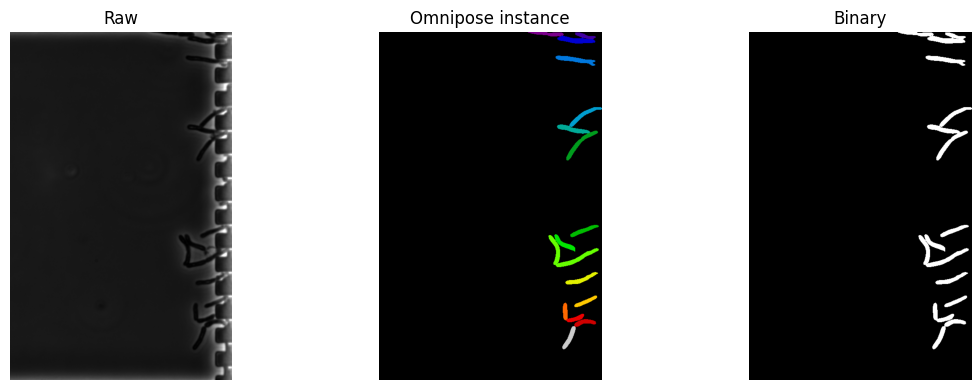

In [5]:
def load_gray_tiff(path: str) -> np.ndarray:
    img = np.array(Image.open(path))
    if img.ndim == 3:
        img = img[..., 0]
    return img.astype(np.float32)

def normalize01(x: np.ndarray) -> np.ndarray:
    mn, mx = float(x.min()), float(x.max())
    return ((x - mn) / (mx - mn + 1e-6)).astype(np.float32)

def load_instance_mask(path: str) -> np.ndarray:
    m = np.array(Image.open(path))
    if m.ndim == 3:
        m = m[..., 0]
    return m.astype(np.int32)

def instance_to_binary(inst: np.ndarray) -> np.ndarray:
    return (inst > 0).astype(np.uint8)

# quick preview
cond, wid = "REF", REF_WELLS[0]
rdir, mdir, _ = well_dirs(cond, wid)
rf, mf = list_tiffs(rdir), list_tiffs(mdir)
raw = normalize01(load_gray_tiff(rf[0]))
inst = load_instance_mask(mf[0])
binm = instance_to_binary(inst)

plt.figure(figsize=(12,4))
plt.subplot(1,3,1); plt.imshow(raw, cmap="gray"); plt.title("Raw"); plt.axis("off")
plt.subplot(1,3,2); plt.imshow(inst, cmap="nipy_spectral"); plt.title("Omnipose instance"); plt.axis("off")
plt.subplot(1,3,3); plt.imshow(binm, cmap="gray"); plt.title("Binary"); plt.axis("off")
plt.tight_layout(); plt.show()

# Padding

In [6]:
def pad_batch_to_max(batch_imgs: List[torch.Tensor],
                     batch_masks: Optional[List[torch.Tensor]] = None,
                     multiple: int = 32) -> Tuple[torch.Tensor, Optional[torch.Tensor]]:
    Hs = [im.shape[-2] for im in batch_imgs]
    Ws = [im.shape[-1] for im in batch_imgs]
    maxH, maxW = max(Hs), max(Ws)
    maxH = int(math.ceil(maxH / multiple) * multiple)
    maxW = int(math.ceil(maxW / multiple) * multiple)

    padded_imgs = []
    padded_masks = [] if batch_masks is not None else None

    for i, im in enumerate(batch_imgs):
        C, H, W = im.shape
        padH = maxH - H
        padW = maxW - W
        im_pad = F.pad(im, (0, padW, 0, padH), value=0.0)
        padded_imgs.append(im_pad)

        if batch_masks is not None:
            m = batch_masks[i]
            padH2 = maxH - m.shape[-2]
            padW2 = maxW - m.shape[-1]
            m_pad = F.pad(m, (0, padW2, 0, padH2), value=0)
            padded_masks.append(m_pad)

    imgs_tensor = torch.stack(padded_imgs, dim=0)
    masks_tensor = torch.stack(padded_masks, dim=0) if padded_masks is not None else None
    return imgs_tensor, masks_tensor

def pad_to_multiple(x: torch.Tensor, multiple: int = 32) -> Tuple[torch.Tensor, Tuple[int,int]]:
    """
    x: (3,H,W)
    returns padded_x, (H,W) original
    """
    C, H, W = x.shape
    Hp = int(math.ceil(H / multiple) * multiple)
    Wp = int(math.ceil(W / multiple) * multiple)
    padH = Hp - H
    padW = Wp - W
    xp = F.pad(x, (0, padW, 0, padH), value=0.0)
    return xp, (H, W)


a = torch.randn(3, 101, 207)
b = torch.randn(3, 120, 199)
imgs_t, _ = pad_batch_to_max([a,b], None, multiple=32)
print("✅ pad_batch_to_max:", imgs_t.shape)

✅ pad_batch_to_max: torch.Size([2, 3, 128, 224])


# Datasets

In [7]:
def make_valid_mask_from_sizes(sizes, Hpad, Wpad, device):
    """
    sizes: list of (H,W) original per sample
    returns: (B,Hpad,Wpad) bool mask where True = valid (non-padded)
    """
    B = len(sizes)
    vm = torch.zeros((B, Hpad, Wpad), dtype=torch.bool, device=device)
    for i, (H, W) in enumerate(sizes):
        vm[i, :H, :W] = True
    return vm


class FrameSegDataset(Dataset):
    """
    Frame-level dataset for training SegFormer:
      item -> {"image": (3,H,W), "mask": (H,W) {0,1}, "well_id": int, "condition": str}
    """
    def __init__(self, condition: str, wells: List[int], max_frames_per_well: Optional[int] = None):
        self.samples = []
        for wid in wells:
            raw_dir, mask_dir, _ = well_dirs(condition, wid)
            raw_files = list_tiffs(raw_dir)
            mask_files = list_tiffs(mask_dir)
            if len(raw_files) == 0 or len(mask_files) == 0:
                print(f"⚠️ Skipping {condition} Pos{wid}: raw={len(raw_files)} mask={len(mask_files)}")
                continue

            n = min(len(raw_files), len(mask_files))
            idxs = list(range(n))
            if max_frames_per_well is not None and n > max_frames_per_well:
                idxs = np.linspace(0, n-1, max_frames_per_well).astype(int).tolist()

            for i in idxs:
                self.samples.append((raw_files[i], mask_files[i], condition, wid))

        assert len(self.samples) > 0, f"❌ Empty FrameSegDataset for {condition}"
        print(f"✅ FrameSegDataset[{condition}] frames:", len(self.samples))

    def __len__(self): return len(self.samples)

    def __getitem__(self, idx):
        raw_path, mask_path, condition, wid = self.samples[idx]
        raw = normalize01(load_gray_tiff(raw_path))
        raw3 = np.stack([raw, raw, raw], axis=0)  # (3,H,W)
        inst = load_instance_mask(mask_path)
        binm = instance_to_binary(inst)          # (H,W)

        return {
            "image": torch.from_numpy(raw3).float(),
            "mask":  torch.from_numpy(binm).long(),
            "well_id": wid,
            "condition": condition
        }

def seg_collate(batch):
    imgs  = [b["image"] for b in batch]
    masks = [b["mask"]  for b in batch]
    sizes = [(im.shape[-2], im.shape[-1]) for im in imgs]  # (H,W) per sample
    imgs_t, masks_t = pad_batch_to_max(imgs, masks, multiple=32)
    return {
        "image": imgs_t,
        "mask": masks_t,
        "sizes": sizes,
        "well_id": [b["well_id"] for b in batch],
        "condition": [b["condition"] for b in batch]
    }

class WellSequenceDataset(Dataset):
    """
    Sequence dataset for inference/visualization:
      item -> {"images": (T,3,H,W), "inst_masks": List[(H,W)], "meta_dir": str, ...}
    """
    def __init__(self, condition: str, wells: List[int]):
        self.items = []
        for wid in wells:
            raw_dir, mask_dir, meta_dir = well_dirs(condition, wid)
            raw_files = list_tiffs(raw_dir)
            mask_files = list_tiffs(mask_dir)
            if len(raw_files) == 0 or len(mask_files) == 0:
                print(f"⚠️ Skipping {condition} Pos{wid}: raw={len(raw_files)} mask={len(mask_files)}")
                continue
            n = min(len(raw_files), len(mask_files))
            self.items.append((condition, wid, raw_files[:n], mask_files[:n], meta_dir))
        assert len(self.items) > 0, f"❌ Empty WellSequenceDataset for {condition}"

    def __len__(self): return len(self.items)

    def __getitem__(self, idx):
        condition, wid, raw_files, mask_files, meta_dir = self.items[idx]
        raws = []
        insts = []
        for rp, mp in zip(raw_files, mask_files):
            r = normalize01(load_gray_tiff(rp))
            r3 = np.stack([r,r,r], axis=0).astype(np.float32)  # (3,H,W)
            raws.append(torch.from_numpy(r3).float())
            insts.append(load_instance_mask(mp))

        # Ensure consistent H/W across frames: pad to max
        Hs = [x.shape[-2] for x in raws]
        Ws = [x.shape[-1] for x in raws]
        maxH, maxW = max(Hs), max(Ws)
        padded = []
        for x in raws:
            C,H,W = x.shape
            padded.append(F.pad(x, (0, maxW-W, 0, maxH-H), value=0.0))
        images = torch.stack(padded, dim=0)  # (T,3,H,W)

        return {
            "images": images,
            "inst_masks": insts,
            "meta_dir": meta_dir,
            "well_id": wid,
            "condition": condition
        }

print("✅ Datasets ready")

✅ Datasets ready


# Helpers

In [8]:
def log_loader_cfg(loader, name: str):
    LOG.info(
        f"{name} cfg | batch_size={loader.batch_size} | num_workers={loader.num_workers} | "
        f"pin_memory={getattr(loader, 'pin_memory', None)} | "
        f"persistent_workers={getattr(loader, 'persistent_workers', None)} | "
        f"prefetch_factor={getattr(loader, 'prefetch_factor', None)} | "
        f"len(loader)={len(loader)}"
    )

def profile_loader(loader, name="loader", n_batches=3):
    it = iter(loader)
    times = []
    for i in range(n_batches):
        t0 = tnow()
        b = next(it)
        dt = tnow() - t0
        times.append(dt)
        img, msk = b["image"], b["mask"]
        LOG.info(f"{name}: batch {i+1}/{n_batches} fetched in {dt:.3f}s | "
                 f"image={tuple(img.shape)} {img.dtype} | mask={tuple(msk.shape)} {msk.dtype}")
    LOG.info(f"{name}: avg={sum(times)/len(times):.3f}s/batch | min={min(times):.3f}s max={max(times):.3f}s")

def make_segformer(num_labels=2) -> SegformerForSemanticSegmentation:
    cfg = SegformerConfig(
        num_labels=num_labels,
        hidden_sizes=[32, 64, 160, 256],
        decoder_hidden_size=256,
    )
    return SegformerForSemanticSegmentation(cfg)

def seg_loss_fn(logits: torch.Tensor, target: torch.Tensor) -> torch.Tensor:
    H, W = target.shape[-2], target.shape[-1]
    if logits.shape[-2:] != (H, W):
        logits = F.interpolate(logits, size=(H, W), mode="bilinear", align_corners=False)
    return F.cross_entropy(logits, target)

@torch.no_grad()
def batch_metrics_from_logits(logits, target, valid=None, eps: float = 1e-7):
    """
    logits: [B,C,Hl,Wl]
    target: [B,H,W] (class ids)
    valid : None or [B,H,W] bool or [B,1,H,W] bool (mask of valid pixels)
    """
    H, W = target.shape[-2], target.shape[-1]
    if logits.shape[-2:] != (H, W):
        logits = F.interpolate(logits, size=(H, W), mode="bilinear", align_corners=False)

    pred = logits.argmax(dim=1)  # [B,H,W]

    if valid is not None:
        v = valid
        if v.ndim == 4:
            v = v.squeeze(1)
        v = v.bool()

        # accuracy on valid pixels only
        denom = v.sum().item()
        if denom == 0:
            acc = float("nan")
        else:
            acc = (pred[v] == target[v]).float().mean().item()

        pred_fg = (pred == 1) & v
        gt_fg   = (target == 1) & v
    else:
        acc = (pred == target).float().mean().item()
        pred_fg = (pred == 1)
        gt_fg   = (target == 1)

    inter = (pred_fg & gt_fg).sum().float()
    union = (pred_fg | gt_fg).sum().float()
    iou  = (inter / (union + eps)).item()
    dice = (2 * inter / (pred_fg.sum().float() + gt_fg.sum().float() + eps)).item()

    return {"acc": acc, "iou": iou, "dice": dice}

@torch.no_grad()
def quick_viz_batch(model, batch, title=""):
    model.eval()
    img = batch["image"].to(DEVICE)
    gt  = batch["mask"].to(DEVICE)

    out = model(pixel_values=img).logits
    out = F.interpolate(out, size=gt.shape[-2:], mode="bilinear", align_corners=False)
    pred = out.argmax(dim=1)

    i = 0
    raw = img[i].detach().cpu().numpy().transpose(1,2,0)[...,0]

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(raw, cmap="gray"); plt.title("Raw"); plt.axis("off")
    plt.subplot(1,3,2); plt.imshow(gt[i].detach().cpu(), cmap="gray"); plt.title("GT bin"); plt.axis("off")
    plt.subplot(1,3,3); plt.imshow(pred[i].detach().cpu(), cmap="gray"); plt.title("Pred"); plt.axis("off")
    plt.suptitle(title); plt.tight_layout(); plt.show()

@torch.no_grad()
def evaluate_loader(model, loader, tag="EVAL", verbose_every=10):
    model.eval()
    loss_sum, n = 0.0, 0
    acc_sum, iou_sum, dice_sum = 0.0, 0.0, 0.0
    t0 = tnow()

    for bi, batch in enumerate(loader):
        img   = batch["image"].to(DEVICE, non_blocking=True)
        gt    = batch["mask"].to(DEVICE, non_blocking=True)
        sizes = batch["sizes"]  # list[(H,W)] from seg_collate

        # valid mask for non-padded pixels
        valid = make_valid_mask_from_sizes(sizes, gt.shape[-2], gt.shape[-1], gt.device)  # (B,H,W) bool

        logits = model(pixel_values=img).logits  # (B,2,h,w)
        if logits.shape[-2:] != gt.shape[-2:]:
            logits = F.interpolate(logits, size=gt.shape[-2:], mode="bilinear", align_corners=False)

        # --- masked loss (same as training) ---
        perpix = F.cross_entropy(logits, gt, reduction="none")  # (B,H,W)
        loss   = (perpix[valid]).mean()

        loss_sum += float(loss.item()); n += 1

        # --- masked metrics ---
        pred = logits.argmax(dim=1)  # (B,H,W)

        v = valid
        acc = (pred[v] == gt[v]).float().mean().item()

        pred_fg = (pred == 1) & v
        gt_fg   = (gt   == 1) & v

        inter = (pred_fg & gt_fg).sum().float()
        union = (pred_fg | gt_fg).sum().float()

        iou  = (inter / (union + 1e-7)).item()
        dice = (2 * inter / (pred_fg.sum().float() + gt_fg.sum().float() + 1e-7)).item()

        acc_sum += acc; iou_sum += iou; dice_sum += dice

        if (bi == 0) or (bi % verbose_every == 0):
            LOG.info(
                f"{tag} batch {bi}/{len(loader)} | loss={loss.item():.4f} | "
                f"acc={acc:.3f} iou={iou:.3f} dice={dice:.3f}"
            )

    out = {
        "loss": loss_sum / max(1, n),
        "acc":  acc_sum  / max(1, n),
        "iou":  iou_sum  / max(1, n),
        "dice": dice_sum / max(1, n),
        "secs": tnow() - t0
    }
    LOG.info(
        f"{tag} done in {out['secs']:.1f}s | loss={out['loss']:.4f} "
        f"acc={out['acc']:.3f} iou={out['iou']:.3f} dice={out['dice']:.3f}"
    )
    return out


# Training

In [ ]:
@dataclass
class SegTrainCfg:
    epochs: int = 10
    lr: float = 2e-4
    batch_size: int = 2
    num_workers: int = 2
    max_frames_per_well: int = 120
    verbose_every: int = 10

def train_segmentation(train_conditions=("REF","RIF")) -> Tuple[SegformerForSemanticSegmentation, str]:
    cfg = SegTrainCfg()

    # Build train/val/test
    train_sets, val_sets, test_sets = [], [], []

    if "REF" in train_conditions:
        train_sets.append(FrameSegDataset("REF", REF_TRAIN, max_frames_per_well=cfg.max_frames_per_well))
        val_sets.append(FrameSegDataset("REF", REF_VAL, max_frames_per_well=cfg.max_frames_per_well))
        test_sets.append(FrameSegDataset("REF", REF_TEST, max_frames_per_well=cfg.max_frames_per_well))
    if "RIF" in train_conditions:
        train_sets.append(FrameSegDataset("RIF", RIF_TRAIN, max_frames_per_well=cfg.max_frames_per_well))
        val_sets.append(FrameSegDataset("RIF", RIF_VAL, max_frames_per_well=cfg.max_frames_per_well))
        test_sets.append(FrameSegDataset("RIF", RIF_TEST, max_frames_per_well=cfg.max_frames_per_well))

    train_ds = torch.utils.data.ConcatDataset(train_sets) if len(train_sets) > 1 else train_sets[0]
    val_ds   = torch.utils.data.ConcatDataset(val_sets)   if len(val_sets) > 1 else val_sets[0]
    test_ds  = torch.utils.data.ConcatDataset(test_sets)  if len(test_sets) > 1 else test_sets[0]

    train_loader = DataLoader(
        train_ds, batch_size=cfg.batch_size, shuffle=True,
        num_workers=cfg.num_workers, collate_fn=seg_collate,
        pin_memory=True, persistent_workers=(cfg.num_workers > 0),
        prefetch_factor=2 if cfg.num_workers > 0 else None
    )
    val_loader = DataLoader(
        val_ds, batch_size=cfg.batch_size, shuffle=False,
        num_workers=cfg.num_workers, collate_fn=seg_collate,
        pin_memory=True, persistent_workers=(cfg.num_workers > 0),
        prefetch_factor=2 if cfg.num_workers > 0 else None
    )
    test_loader = DataLoader(
        test_ds, batch_size=cfg.batch_size, shuffle=False,
        num_workers=cfg.num_workers, collate_fn=seg_collate,
        pin_memory=True, persistent_workers=(cfg.num_workers > 0),
        prefetch_factor=2 if cfg.num_workers > 0 else None
    )

    log_loader_cfg(train_loader, "TRAIN_LOADER")
    log_loader_cfg(val_loader,   "VAL_LOADER")
    log_loader_cfg(test_loader,  "TEST_LOADER")

    profile_loader(train_loader, "TRAIN_LOADER", n_batches=3)

    LOG.info(f"loaders ready | train={len(train_loader)} val={len(val_loader)} test={len(test_loader)}")

    t0 = tnow()
    b0 = next(iter(train_loader))
    LOG.info(f"✅ first TRAIN batch loaded in {tnow()-t0:.2f}s | "
             f"image={tuple(b0['image'].shape)} mask={tuple(b0['mask'].shape)} dtype={b0['mask'].dtype}")

    model = make_segformer(num_labels=2).to(DEVICE)
    opt = torch.optim.AdamW(model.parameters(), lr=cfg.lr)

    best_val = 1e9
    weight_path = os.path.join(MODEL_DIR, "segformer_binary_best.pt")

    for ep in range(cfg.epochs):
        # ---- train (VERBOSE)
        model.train()
        loss_sum, n_batches = 0.0, 0
        acc_sum, iou_sum, dice_sum = 0.0, 0.0, 0.0
        ep_t0 = tnow()

        for bi, batch in enumerate(train_loader):
            tload0 = tnow()
            img   = batch["image"].to(DEVICE, non_blocking=True)
            gt    = batch["mask"].to(DEVICE, non_blocking=True)
            tload1 = tnow()
            sizes = batch["sizes"]  # list[(H,W)] from seg_collate

            valid = make_valid_mask_from_sizes(sizes, gt.shape[-2], gt.shape[-1], gt.device)

            logits = model(pixel_values=img).logits  # (B,2,H,W)
            if logits.shape[-2:] != gt.shape[-2:]:
                logits = F.interpolate(logits, size=gt.shape[-2:], mode="bilinear", align_corners=False)
            perpix = F.cross_entropy(logits, gt, reduction="none")  # (B,H,W)
            loss   = (perpix[valid]).mean()


            opt.zero_grad(set_to_none=True)
            loss.backward()
            opt.step()

            loss_sum += float(loss.item())
            n_batches += 1

            m = batch_metrics_from_logits(logits.detach(), gt, valid=valid)
            acc_sum  += m["acc"]
            iou_sum  += m["iou"]
            dice_sum += m["dice"]

            if bi % cfg.verbose_every == 0:
                LOG.info(
                    f"TRAIN ep {ep+1}/{cfg.epochs} | batch {bi}/{len(train_loader)} | "
                    f"loss={loss.item():.4f} | acc={m['acc']:.3f} iou={m['iou']:.3f} dice={m['dice']:.3f} | "
                    f"load+toGPU={tload1-tload0:.3f}s | step={tnow()-tload1:.3f}s | "
                    f"img={tuple(img.shape)} gt={tuple(gt.shape)}"
                )

        train_loss = loss_sum / max(1, n_batches)
        train_acc  = acc_sum  / max(1, n_batches)
        train_iou  = iou_sum  / max(1, n_batches)
        train_dice = dice_sum / max(1, n_batches)

        LOG.info(
            f"TRAIN epoch {ep+1} done in {tnow()-ep_t0:.1f}s | "
            f"loss={train_loss:.4f} acc={train_acc:.3f} iou={train_iou:.3f} dice={train_dice:.3f}"
        )

        # ---- val (VERBOSE)
        model.eval()
        val_sum, vn = 0.0, 0
        vacc_sum, viou_sum, vdice_sum = 0.0, 0.0, 0.0
        val_t0 = tnow()

        with torch.no_grad():
            for bi, batch in enumerate(val_loader):
                img   = batch["image"].to(DEVICE, non_blocking=True)
                gt    = batch["mask"].to(DEVICE, non_blocking=True)
                sizes = batch["sizes"]  # list[(H,W)] from seg_collate

                valid = make_valid_mask_from_sizes(sizes, gt.shape[-2], gt.shape[-1], gt.device)

                logits = model(pixel_values=img).logits  # (B,2,H,W)
                if logits.shape[-2:] != gt.shape[-2:]:
                    logits = F.interpolate(logits, size=gt.shape[-2:], mode="bilinear", align_corners=False)

                perpix = F.cross_entropy(logits, gt, reduction="none")  # (B,H,W)
                loss   = (perpix[valid]).mean()


                val_sum += float(loss.item()); vn += 1

                m = batch_metrics_from_logits(logits.detach(), gt, valid=valid)
                vacc_sum  += m["acc"]
                viou_sum  += m["iou"]
                vdice_sum += m["dice"]

                if bi % max(1, cfg.verbose_every) == 0:
                    LOG.info(
                        f"VAL   ep {ep+1}/{cfg.epochs} | batch {bi}/{len(val_loader)} | "
                        f"loss={loss.item():.4f} | acc={m['acc']:.3f} iou={m['iou']:.3f} dice={m['dice']:.3f}"
                    )

        val_loss = val_sum / max(1, vn)
        val_acc  = vacc_sum  / max(1, vn)
        val_iou  = viou_sum  / max(1, vn)
        val_dice = vdice_sum / max(1, vn)

        LOG.info(
            f"VAL   epoch {ep+1} done in {tnow()-val_t0:.1f}s | "
            f"loss={val_loss:.4f} acc={val_acc:.3f} iou={val_iou:.3f} dice={val_dice:.3f}"
        )

        print(
            f"Epoch {ep+1}/{cfg.epochs} | "
            f"train_loss={train_loss:.4f} val_loss={val_loss:.4f} | "
            f"val_acc={val_acc:.3f} val_iou={val_iou:.3f} val_dice={val_dice:.3f}"
        )

        # Save per-epoch checkpoint
        ep_path = os.path.join(MODEL_DIR, f"segformer_ep{ep+1}.pt")
        torch.save(model.state_dict(), ep_path)
        print("  💾 saved epoch weights:", ep_path)

        # Save best
        if val_loss < best_val:
            best_val = val_loss
            torch.save(model.state_dict(), weight_path)
            print("  ✅ saved best weights:", weight_path)

        # Quick sanity viz
        try:
            b = next(iter(val_loader))
            quick_viz_batch(model, b, title=f"Epoch {ep+1} (val batch)")
        except Exception as e:
            print("Viz skipped:", e)

    # Load best at end
    model.load_state_dict(torch.load(weight_path, map_location=DEVICE))

    # final evaluation on val and test with best weights
    _ = evaluate_loader(model, val_loader,  tag="VAL(best)",  verbose_every=cfg.verbose_every)
    _ = evaluate_loader(model, test_loader, tag="TEST(best)", verbose_every=cfg.verbose_every)

    return model, weight_path


==================== TRAINING ====================
✅ FrameSegDataset[REF] frames: 840
✅ FrameSegDataset[REF] frames: 120
✅ FrameSegDataset[REF] frames: 240
✅ FrameSegDataset[RIF] frames: 840
✅ FrameSegDataset[RIF] frames: 120
✅ FrameSegDataset[RIF] frames: 240
Epoch 1/10 | train_loss=0.0541 val_loss=0.0313 | val_acc=0.987 val_iou=0.792 val_dice=0.883
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep1.pt
  ✅ saved best weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_binary_best.pt


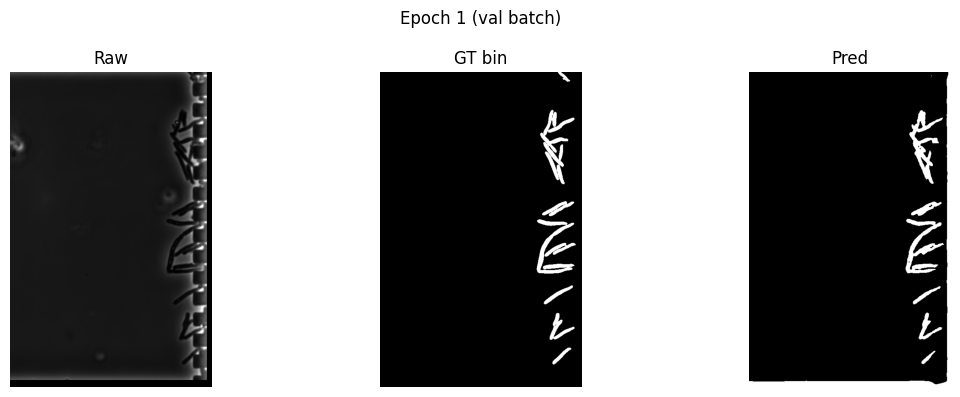

Epoch 2/10 | train_loss=0.0275 val_loss=0.0301 | val_acc=0.988 val_iou=0.822 val_dice=0.902
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep2.pt
  ✅ saved best weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_binary_best.pt


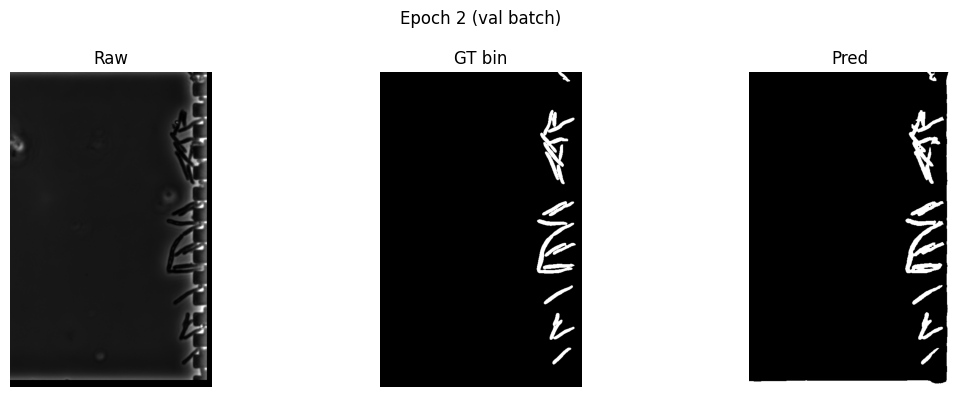

Epoch 3/10 | train_loss=0.0229 val_loss=0.0235 | val_acc=0.990 val_iou=0.843 val_dice=0.915
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep3.pt
  ✅ saved best weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_binary_best.pt


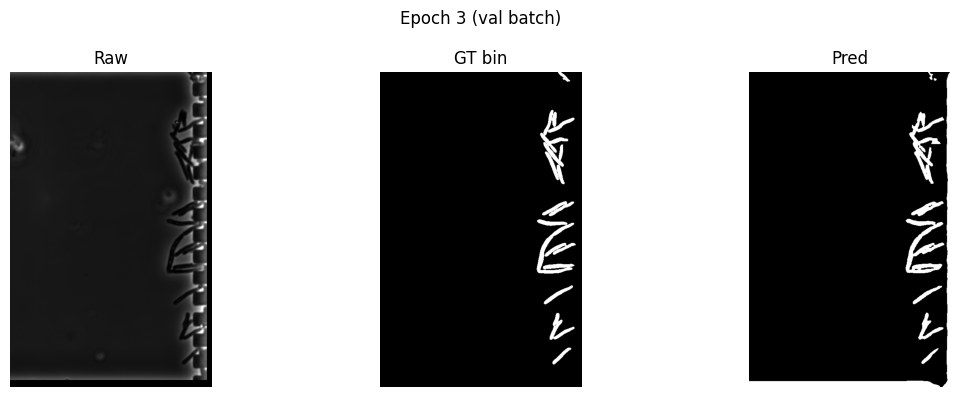

Epoch 4/10 | train_loss=0.0208 val_loss=0.0228 | val_acc=0.990 val_iou=0.849 val_dice=0.918
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep4.pt
  ✅ saved best weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_binary_best.pt


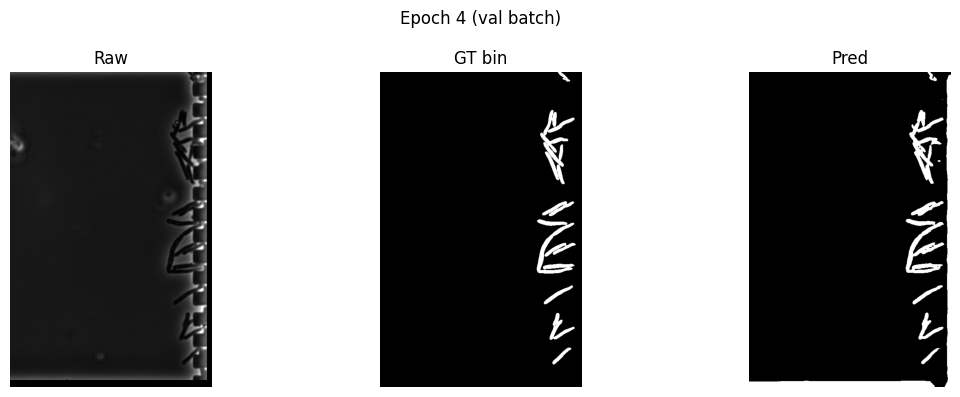

Epoch 5/10 | train_loss=0.0194 val_loss=0.0243 | val_acc=0.990 val_iou=0.839 val_dice=0.912
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep5.pt


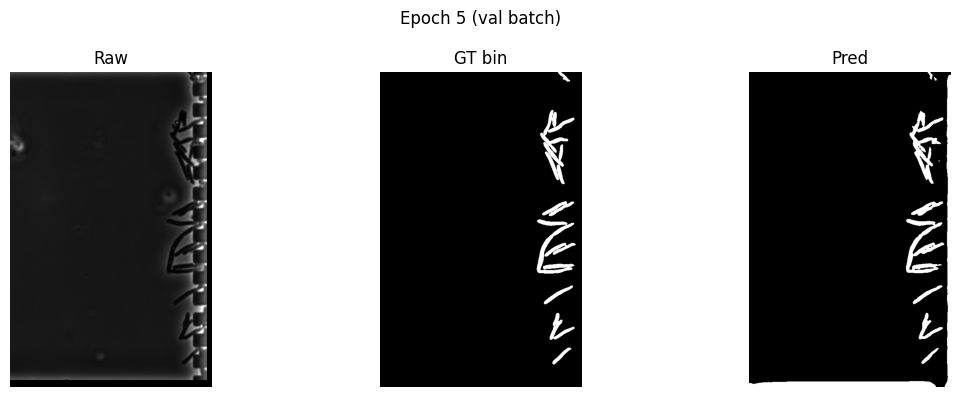

Epoch 6/10 | train_loss=0.0185 val_loss=0.0229 | val_acc=0.991 val_iou=0.853 val_dice=0.920
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep6.pt


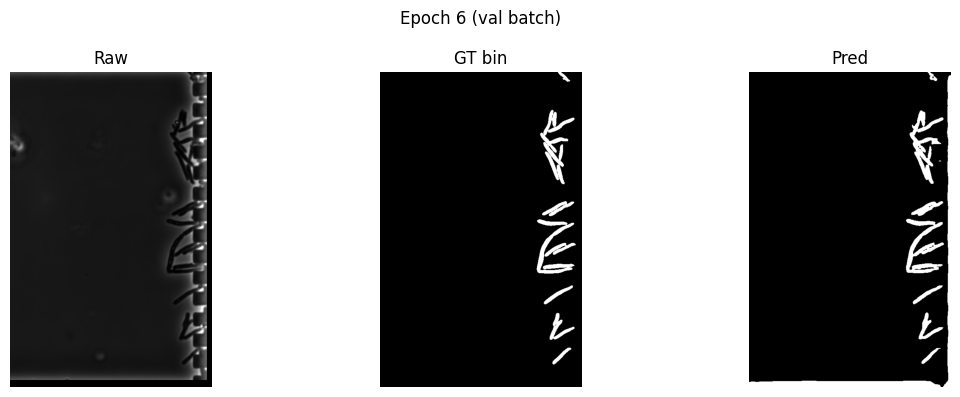

Epoch 7/10 | train_loss=0.0178 val_loss=0.0217 | val_acc=0.991 val_iou=0.859 val_dice=0.924
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep7.pt
  ✅ saved best weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_binary_best.pt


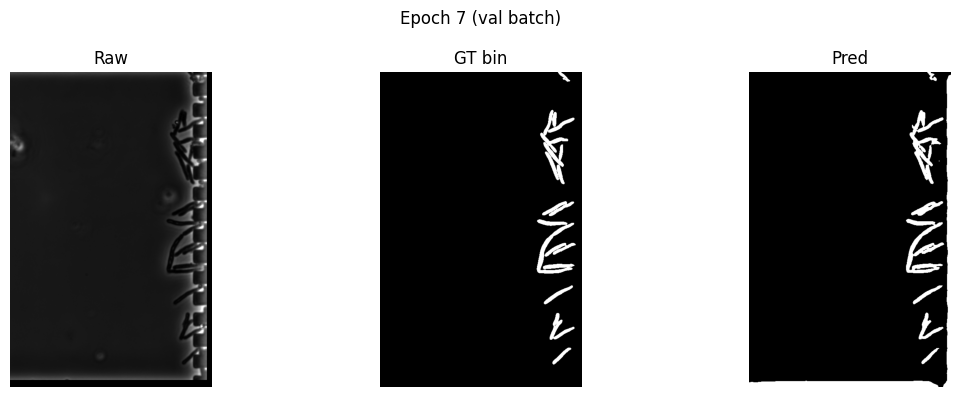

Epoch 8/10 | train_loss=0.0173 val_loss=0.0222 | val_acc=0.991 val_iou=0.857 val_dice=0.923
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep8.pt


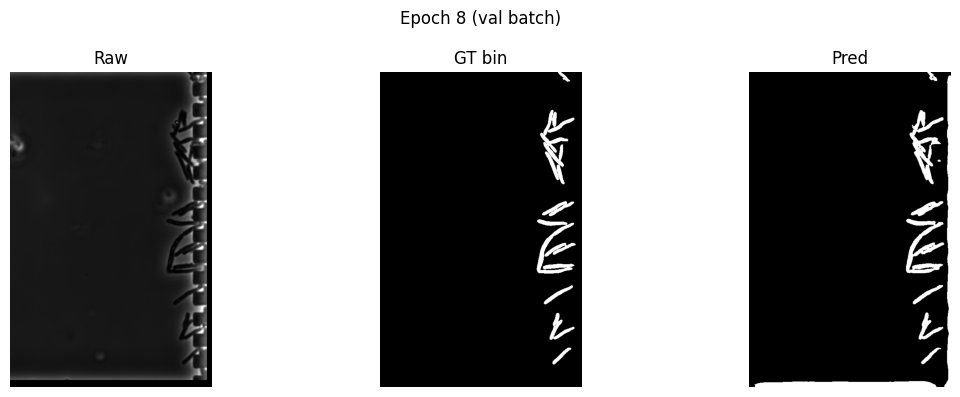

Epoch 9/10 | train_loss=0.0168 val_loss=0.0198 | val_acc=0.992 val_iou=0.873 val_dice=0.932
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep9.pt
  ✅ saved best weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_binary_best.pt


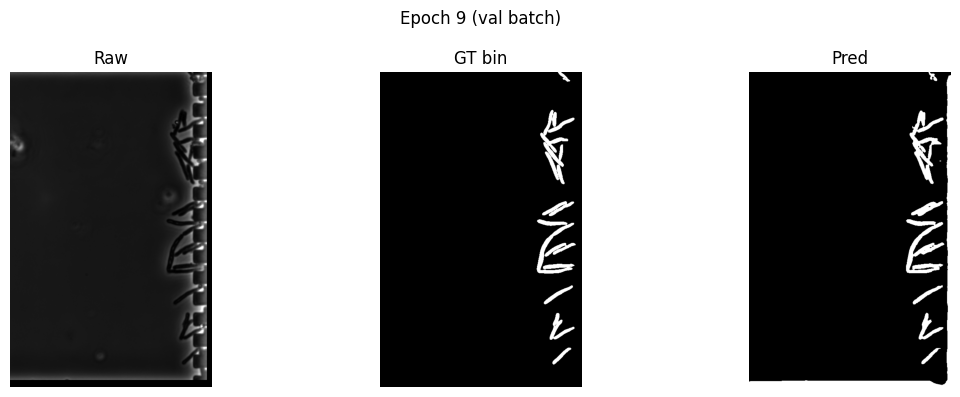

Epoch 10/10 | train_loss=0.0165 val_loss=0.0210 | val_acc=0.992 val_iou=0.868 val_dice=0.929
  💾 saved epoch weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_ep10.pt


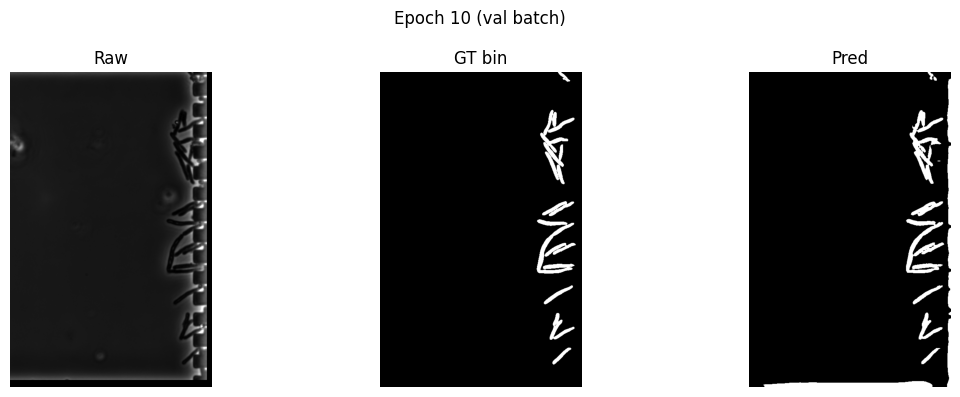

✅ Best weights: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/segformer_saved/segformer_binary_best.pt


In [ ]:
print("\n==================== TRAINING ====================")
model, best_path = train_segmentation(train_conditions=("REF","RIF"))
print("✅ Best weights:", best_path)

# Tracking

In [9]:
def mask_iou(a: np.ndarray, b: np.ndarray) -> float:
    inter = np.logical_and(a, b).sum()
    union = np.logical_or(a, b).sum()
    return float(inter) / float(union + 1e-8)

def build_pseudo_tracks(inst_masks: List[np.ndarray], iou_thr: float = 0.2) -> List[Dict[int,int]]:
    """
    Build pseudo-tracks using IoU matching of instance labels between consecutive frames.
    Returns track_maps[t]: dict {inst_id -> track_id}
    """
    T = len(inst_masks)
    next_tid = 1
    track_maps: List[Dict[int,int]] = []
    prev_map: Dict[int,int] = {}

    for t in range(T):
        inst = inst_masks[t]
        ids = [i for i in np.unique(inst) if i != 0]
        cur_map: Dict[int,int] = {}

        if t == 0:
            for iid in ids:
                cur_map[int(iid)] = next_tid
                next_tid += 1
        else:
            prev_inst = inst_masks[t-1]
            prev_ids = [i for i in np.unique(prev_inst) if i != 0]

            if len(prev_ids) == 0:
                for iid in ids:
                    cur_map[int(iid)] = next_tid; next_tid += 1
            elif len(ids) == 0:
                cur_map = {}
            else:
                cost = np.ones((len(prev_ids), len(ids)), dtype=np.float64)
                for i, pid in enumerate(prev_ids):
                    pm = (prev_inst == pid)
                    for j, cid in enumerate(ids):
                        cm = (inst == cid)
                        iou = mask_iou(pm, cm)
                        cost[i,j] = 1.0 - iou

                r, c = linear_sum_assignment(cost)
                matched_cur = set()
                matched_prev = set()

                for i, j in zip(r, c):
                    iou = 1.0 - cost[i,j]
                    if iou >= iou_thr:
                        pid = int(prev_ids[i])
                        cid = int(ids[j])
                        tid = prev_map.get(pid, None)
                        if tid is None:
                            tid = next_tid; next_tid += 1
                        cur_map[cid] = tid
                        matched_cur.add(cid)
                        matched_prev.add(pid)

                # new instances
                for cid in ids:
                    cid = int(cid)
                    if cid not in matched_cur:
                        cur_map[cid] = next_tid; next_tid += 1

        track_maps.append(cur_map)
        prev_map = cur_map

    return track_maps

@torch.no_grad()
def predict_sequence_binary(model, images: torch.Tensor) -> torch.Tensor:
    """
    images: (T,3,H,W) float in [0,1]
    returns torch (T,H,W) {0,1}
    """
    model.eval()
    T = images.shape[0]
    preds = []
    for t in range(T):
        x = images[t].to(DEVICE)
        xp, (H, W) = pad_to_multiple(x, 32)     # (3,Hp,Wp)
        xp = xp.unsqueeze(0)                    # (1,3,Hp,Wp)
        logits = model(pixel_values=xp).logits  # (1,2,h,w)
        logits = F.interpolate(logits, size=xp.shape[-2:], mode="bilinear", align_corners=False)
        pred = logits.argmax(dim=1).squeeze(0)  # (Hp,Wp)
        pred = pred[:H, :W]                     # crop back
        preds.append(pred.detach().cpu())
    return torch.stack(preds, dim=0)            # (T,H,W)

def align_pred_and_inst(pred_bin: np.ndarray, inst_masks: List[np.ndarray]):
    """
    Ensures per-frame pred and instance masks have identical H,W.
    Crops prediction to match the Omnipose mask size per frame (deterministic).
    """
    T = min(pred_bin.shape[0], len(inst_masks))
    out_pred = []
    out_inst = []
    for t in range(T):
        p = pred_bin[t]
        m = inst_masks[t]

        if p.shape[0] != m.shape[0] or p.shape[1] != m.shape[1]:
            print(f"⚠️ align_pred_and_inst t={t}: pred={p.shape} inst={m.shape} -> crop pred to {(m.shape[0], m.shape[1])}")

        H = m.shape[0]
        W = m.shape[1]
        p = p[:H, :W]

        out_pred.append(p)
        out_inst.append(m)
    return np.stack(out_pred, axis=0), out_inst



def refine_with_tracks(pred_bin: np.ndarray,
                       inst_masks: List[np.ndarray],
                       track_maps: List[Dict[int,int]],
                       cover_thr: float = 0.25) -> np.ndarray:
    """
    pred_bin: (T,H,W) 0/1 from SegFormer
    inst_masks: list of (H,W) instance labels (Omnipose)
    track_maps[t]: {instance_label -> track_id}
    If a track appears confidently in ANY frame (coverage >= cover_thr),
    enforce that region as 1 in ALL frames where the track exists.
    """
    T, H, W = pred_bin.shape
    refined = pred_bin.copy()

    occ: Dict[int, List[Tuple[int,int]]] = {}
    for t in range(T):
        for inst_id, tid in track_maps[t].items():
            occ.setdefault(tid, []).append((t, inst_id))

    for tid, items in occ.items():
        cover_scores = []
        regions = []
        ts = []
        for (t, inst_id) in items:
            region = (inst_masks[t] == inst_id)
            if region.sum() == 0:
                continue

            p = pred_bin[t]

            # ✅ force region to match p BEFORE storing it
            if region.shape != p.shape:
                H = min(region.shape[0], p.shape[0])
                W = min(region.shape[1], p.shape[1])
                region = region[:H, :W]
                p = p[:H, :W]

            ts.append(t)
            regions.append(region)

            cov = p[region].mean()
            cover_scores.append(float(cov))


        if len(cover_scores) == 0:
            continue

        if max(cover_scores) >= cover_thr:
            for (t, region) in zip(ts, regions):
                refined[t][:region.shape[0], :region.shape[1]][region] = 1

    return refined

# Metrics and Curves

In [ ]:
def calc_growth_rate_nosmooth(area: np.ndarray, interval_min: float) -> np.ndarray:
    """
    Simple no-smoothing growth estimate (log-derivative) in h^-1.
    Returns length (T-1), aligned like: t=1..T-1
    """
    dt_hr = interval_min / 60.0
    A = np.clip(area.astype(np.float64), 1e-6, None)
    r = (np.log(A[1:]) - np.log(A[:-1])) / dt_hr
    return r.astype(np.float64)


def area_curve_from_binary(seq_bin: np.ndarray) -> np.ndarray:
    return seq_bin.reshape(seq_bin.shape[0], -1).sum(axis=1).astype(np.float64)

def calc_growth_rate_rolling(area: np.ndarray, rolling: int, interval_min: float) -> np.ndarray:
    """
    Tran-style: fit exponential in rolling window and return b in h^-1.
    """
    def exp_fit(x, a, b):
        return a * np.exp(b * x)

    rates = []
    for i in range(rolling, len(area)):
        y = area[i-rolling:i].astype(np.float64)
        if np.any(y <= 0):
            rates.append(np.nan); continue
        x = np.arange(rolling)
        p0 = [np.max(y), 0.0005]
        try:
            popt, _ = curve_fit(exp_fit, x, y, p0=p0, maxfev=5000)
            b = float(popt[1])
            rates.append(b / interval_min * 60.0)  # per hour
        except RuntimeError:
            rates.append(np.nan)

    return np.array(rates, dtype=np.float64)

def load_meta_pickles(meta_dir: str) -> Tuple[Optional[np.ndarray], Optional[np.ndarray]]:
    """
    If your meta has Omnipose reference pickles, load them.
    Otherwise return None, None.
    """
    area_p = os.path.join(meta_dir, "growth_areas.pickle")
    rate_p = os.path.join(meta_dir, "growth_rate.pickle")

    area = None
    rate = None

    if os.path.exists(area_p):
        with open(area_p, "rb") as f:
            area = np.array(pickle.load(f)).reshape(-1).astype(np.float64)

    if os.path.exists(rate_p):
        with open(rate_p, "rb") as f:
            rate = np.array(pickle.load(f)).reshape(-1).astype(np.float64)

    return area, rate

# Visualization

In [ ]:
def colorize_instances(inst: np.ndarray) -> np.ndarray:
    """
    Color instance labels deterministically.
    """
    H, W = inst.shape
    out = np.zeros((H,W,3), dtype=np.uint8)
    ids = [i for i in np.unique(inst) if i != 0]
    for iid in ids:
        rng = np.random.default_rng(seed=int(iid))
        col = rng.integers(0, 255, size=(3,), dtype=np.uint8)
        out[inst == iid] = col
    return out

def overlay_gray_with_rgb(gray01: np.ndarray, rgb: np.ndarray, alpha=0.5) -> np.ndarray:
    base = (gray01 * 255).astype(np.uint8)
    base3 = np.stack([base, base, base], axis=-1)
    return (base3 * (1-alpha) + rgb * alpha).astype(np.uint8)

def show_sequence_preview(images: torch.Tensor,
                          inst_masks: List[np.ndarray],
                          pred_bin: np.ndarray,
                          refined_bin: np.ndarray,
                          n_show: int = 6,
                          title: str = ""):
    """
    Show first n_show frames with Omnipose inst overlay, pred overlay, refined overlay.
    """
    T = images.shape[0]
    n = min(T, n_show)
    plt.figure(figsize=(4*n, 9))

    for i in range(n):
        raw_full = images[i].numpy().transpose(1,2,0)[...,0]
        H, W = inst_masks[i].shape
        raw = raw_full[:H, :W]
      # (Himg, Wimg)
        inst_rgb = colorize_instances(inst_masks[i])             # (Hinst, Winst, 3)

        # ✅ align shapes (fix 782 vs 783 errors)
        H = min(raw.shape[0], inst_rgb.shape[0], pred_bin[i].shape[0], refined_bin[i].shape[0])
        W = min(raw.shape[1], inst_rgb.shape[1], pred_bin[i].shape[1], refined_bin[i].shape[1])

        raw = raw[:H, :W]
        inst_rgb = inst_rgb[:H, :W]
        pb = pred_bin[i][:H, :W]
        rb = refined_bin[i][:H, :W]

        pred_rgb = np.zeros_like(inst_rgb)
        pred_rgb[pb == 1] = np.array([0,255,0], dtype=np.uint8)

        ref_rgb = np.zeros_like(inst_rgb)
        ref_rgb[rb == 1] = np.array([255,0,0], dtype=np.uint8)

        plt.subplot(3, n, i+1)
        plt.imshow(raw, cmap="gray"); plt.axis("off"); plt.title(f"Raw t={i}")

        plt.subplot(3, n, n+i+1)
        plt.imshow(overlay_gray_with_rgb(raw, inst_rgb, 0.55))
        plt.axis("off"); plt.title("Omnipose inst")

        plt.subplot(3, n, 2*n+i+1)
        plt.imshow(overlay_gray_with_rgb(raw, pred_rgb, 0.55))
        plt.axis("off"); plt.title("Pred (green)")

    plt.suptitle(title)
    plt.tight_layout()
    plt.show()


    # second figure: pred vs refined overlays
    plt.figure(figsize=(4*n, 6))
    for i in range(n):
        raw_full = images[i].numpy().transpose(1,2,0)[...,0]
        H, W = inst_masks[i].shape
        raw = raw_full[:H, :W]
        inst_rgb = colorize_instances(inst_masks[i])


        # ✅ align shapes (fix 782 vs 783 errors)
        H = min(raw.shape[0], inst_rgb.shape[0], pred_bin[i].shape[0], refined_bin[i].shape[0])
        W = min(raw.shape[1], inst_rgb.shape[1], pred_bin[i].shape[1], refined_bin[i].shape[1])

        raw = raw[:H, :W]
        inst_rgb = inst_rgb[:H, :W]
        pb = pred_bin[i][:H, :W]
        rb = refined_bin[i][:H, :W]

        pred_rgb = np.zeros((H, W, 3), dtype=np.uint8)
        pred_rgb[pb == 1] = np.array([0,255,0], dtype=np.uint8)

        ref_rgb  = np.zeros((H, W, 3), dtype=np.uint8)
        ref_rgb[rb == 1] = np.array([255,0,0], dtype=np.uint8)



        plt.subplot(2, n, i+1);     plt.imshow(overlay_gray_with_rgb(raw, pred_rgb, 0.55)); plt.axis("off"); plt.title("Pred (green)")
        plt.subplot(2, n, n+i+1);   plt.imshow(overlay_gray_with_rgb(raw, ref_rgb, 0.55));  plt.axis("off"); plt.title("Refined (red)")

    plt.suptitle(title + " | Pred vs Refined")
    plt.tight_layout()
    plt.show()

def plot_curves(area_omni, rate_omni,
                area_pred, rate_pred,
                area_refi, rate_refi,
                interval_min: float,
                rolling: int,
                title: str):
    T = len(area_pred)
    t_hr = np.arange(T) * (interval_min / 60.0)

    plt.figure(figsize=(10,4))
    if area_omni is not None:
        m = min(len(area_omni), len(area_pred))
        plt.plot(t_hr[:m], area_omni[:m], label="Omnipose area", lw=2)
    plt.plot(t_hr, area_pred, label="SegFormer area", lw=2)
    plt.plot(t_hr, area_refi, label="Refined area", lw=2)
    plt.xlabel("Time (hour)")
    plt.ylabel("Area (pixels^2)")
    plt.title(title + " | Area")
    plt.legend()
    plt.tight_layout()
    plt.show()

    t2_hr = (np.arange(len(rate_pred)) + rolling) * (interval_min / 60.0)
    plt.figure(figsize=(10,4))
    if rate_omni is not None:
        m = min(len(rate_omni), len(rate_pred))
        plt.plot(t2_hr[:m], rate_omni[:m], label="Omnipose rate", lw=2)
    plt.plot(t2_hr, rate_pred, label="SegFormer rate", lw=2)
    plt.plot(t2_hr, rate_refi, label="Refined rate", lw=2)
    plt.xlabel("Time (hour)")
    plt.ylabel("Growth rate (h^-1)")
    plt.title(title + " | Growth rate")
    plt.legend()
    plt.tight_layout()
    plt.show()

# Run one well

In [ ]:
def run_one_well_demo(model, condition: str, well_id: int,
                     iou_thr_track: float = 0.2,
                     cover_thr_refine: float = 0.25,
                     rolling: int = 16, no_smoothing_growth: bool = False):

    seq_ds = WellSequenceDataset(condition, [well_id])
    sample = seq_ds[0]
    images = sample["images"]      # (T,3,H,W)
    insts  = sample["inst_masks"]  # list(T) of (H,W)
    meta_dir = sample["meta_dir"]

    # Predict segmentation (binary)
    pred_t = predict_sequence_binary(model, images)
    pred_bin = pred_t.numpy().astype(np.uint8)

    # --- crop to common T ---
    T = min(len(insts), pred_bin.shape[0], images.shape[0])
    insts = insts[:T]
    pred_bin = pred_bin[:T]
    images = images[:T]

    # --- crop pred_bin to match omnipose inst mask per frame (safe in both directions) ---
    pred_bin = np.stack([
        pred_bin[t][:min(pred_bin[t].shape[0], insts[t].shape[0]),
                    :min(pred_bin[t].shape[1], insts[t].shape[1])]
        for t in range(T)
    ], axis=0)

    # Tracking + refine
    track_maps = build_pseudo_tracks(insts, iou_thr=iou_thr_track)
    refined_bin = refine_with_tracks(pred_bin, insts, track_maps, cover_thr=cover_thr_refine)

    # --- crop refined_bin too (defensive) ---
    refined_bin = np.stack([
        refined_bin[t][:min(refined_bin[t].shape[0], insts[t].shape[0]),
                       :min(refined_bin[t].shape[1], insts[t].shape[1])]
        for t in range(T)
    ], axis=0)

    # Curves (model)
    area_pred = area_curve_from_binary(pred_bin)
    area_refi = area_curve_from_binary(refined_bin)

    if no_smoothing_growth:
        rate_pred = calc_growth_rate_nosmooth(area_pred, interval_min=INTERVAL_MIN)
        rate_refi = calc_growth_rate_nosmooth(area_refi, interval_min=INTERVAL_MIN)
    else:
        rate_pred = calc_growth_rate_rolling(area_pred, rolling=rolling, interval_min=INTERVAL_MIN)
        rate_refi = calc_growth_rate_rolling(area_refi, rolling=rolling, interval_min=INTERVAL_MIN)

    # Omnipose reference pickles (DO NOT recompute)
    area_omni, rate_omni = load_meta_pickles(meta_dir)

    # Save curves for stacked plots
    wdir = os.path.join(RUN_DIR, f"{condition}_Pos{well_id}")
    os.makedirs(wdir, exist_ok=True)

    np.save(os.path.join(wdir, "area_pred.npy"),    area_pred)
    np.save(os.path.join(wdir, "area_refined.npy"), area_refi)
    np.save(os.path.join(wdir, "rate_pred.npy"),    rate_pred)
    np.save(os.path.join(wdir, "rate_refined.npy"), rate_refi)

    # Visualizations
    show_sequence_preview(images.cpu(), insts, pred_bin, refined_bin, n_show=6,
                          title=f"{condition} Pos{well_id}")

    plot_curves(area_omni, rate_omni,
                area_pred, rate_pred,
                area_refi, rate_refi,
                interval_min=INTERVAL_MIN,
                rolling=rolling,
                title=f"{condition} Pos{well_id}")

    return {
        "area_omni": area_omni, "rate_omni": rate_omni,
        "area_pred": area_pred, "rate_pred": rate_pred,
        "area_refi": area_refi, "rate_refi": rate_refi,
        "saved_dir": wdir
    }

In [14]:
def load_pickle_safe(path: str):
    if not os.path.exists(path):
        return None
    with open(path, "rb") as f:
        return pickle.load(f)

import os, glob, pickle
import numpy as np

def load_omnipose_curves(DATA_ROOT: str, condition: str, wells,
                         interval_min: float,
                         rolling: int = 16):
    """
    Loads Omnipose curves from per-well meta folder:
      .../Data/<condition>/PosXXX/meta/*.pkl

    Returns:
      area_stack: [n_wells, T]
      rate_stack: [n_wells, T] (NaNs where undefined) OR None if cannot compute
      ok: bool
    """
    areas = []
    rates = []
    found = 0

    for wid in wells:
        pos = f"Pos{wid}"
        meta_dir = os.path.join(DATA_ROOT, condition, pos, "meta")

        if not os.path.isdir(meta_dir):
            print(f"⚠️ Omnipose missing meta folder for {condition} {pos}: {meta_dir}")
            continue

        pkl_candidates = sorted(glob.glob(os.path.join(meta_dir, "*.pkl")) +
                                glob.glob(os.path.join(meta_dir, "*.pickle")))

        if len(pkl_candidates) == 0:
            print(f"⚠️ Omnipose missing pickles for {condition} {pos} (meta empty)")
            continue

        priority = []
        for key in ["PreprocessedPhaseMasks", "phase", "area", "growth", "curves", "omni"]:
            priority += [p for p in pkl_candidates if key.lower() in os.path.basename(p).lower()]

        seen = set()
        priority = [p for p in priority if not (p in seen or seen.add(p))]
        ordered = priority + [p for p in pkl_candidates if p not in seen]

        area_curve = None
        rate_curve = None
        loaded = False

        for pkl_path in ordered:
            try:
                with open(pkl_path, "rb") as f:
                    obj = pickle.load(f)

                curve = None
                gr = None

                if isinstance(obj, dict):
                    for k in ["total_area", "area", "areas", "TotalArea", "totalArea"]:
                        if k in obj:
                            curve = obj[k]; break

                    for k in ["growth_rate", "rate", "rates", "GrowthRate", "growthRate"]:
                        if k in obj:
                            gr = obj[k]; break

                    if curve is None and "curves" in obj and isinstance(obj["curves"], dict):
                        for k in ["total_area", "area", "areas"]:
                            if k in obj["curves"]:
                                curve = obj["curves"][k]; break
                        for k in ["growth_rate", "rate", "rates"]:
                            if k in obj["curves"]:
                                gr = obj["curves"][k]; break

                if curve is None and isinstance(obj, (list, tuple)) and len(obj) > 0:
                    # if (area, growth) format
                    for item in obj:
                        arr = np.asarray(item)
                        if arr.ndim == 1 and np.issubdtype(arr.dtype, np.number):
                            if curve is None:
                                curve = arr
                            elif gr is None:
                                gr = arr
                                break

                if curve is None:
                    arr = np.asarray(obj)
                    if arr.ndim == 1 and np.issubdtype(arr.dtype, np.number):
                        curve = arr

                if curve is None:
                    continue

                curve = np.asarray(curve).astype(np.float32).reshape(-1)
                if curve.ndim != 1 or len(curve) < 5:
                    continue

                if gr is not None:
                    gr = np.asarray(gr).astype(np.float32).reshape(-1)
                    if gr.ndim != 1:
                        gr = None

                area_curve = curve
                rate_curve = gr
                found += 1
                loaded = True
                break

            except Exception:
                continue

        if not loaded:
            print(f"⚠️ Could not parse area curve from meta pickles for {condition} {pos}")
            continue

        areas.append(area_curve)
        rates.append(rate_curve)

    if len(areas) == 0:
        print(f"⚠️ No omnipose curves found for {condition} (meta/ exists but no readable curves).")
        return None, None, False

    # align lengths
    minT = min(len(x) for x in areas)
    area_stack = np.stack([x[:minT] for x in areas], axis=0)

    # If all wells have explicit growth, stack it. Otherwise compute from area.
    has_all_rates = all((r is not None and len(r) >= minT) for r in rates)

    if has_all_rates:
        rate_stack = np.stack([r[:minT] for r in rates], axis=0)
    else:
        # compute a simple log-derivative rate from area (safe, quick)
        dt_hr = interval_min / 60.0
        A = np.clip(area_stack.astype(np.float32), 1e-6, None)
        rate_stack = np.full_like(A, np.nan, dtype=np.float32)
        rate_stack[:, 1:] = (np.log(A[:, 1:]) - np.log(A[:, :-1])) / dt_hr

    print(f"✅ Loaded omnipose curves for {condition}: {found}/{len(wells)} wells | T={minT}")
    return area_stack, rate_stack, True


def load_model_curves(RUN_DIR, condition: str, wells: list[int], which: str = "refined"):
    """
    Loads your model curves saved by run_one_well_demo():
      runs_tracking_refine/{condition}_Pos###/area_pred.npy
      runs_tracking_refine/{condition}_Pos###/area_refined.npy
      runs_tracking_refine/{condition}_Pos###/rate_pred.npy
      runs_tracking_refine/{condition}_Pos###/rate_refined.npy
    which:
      - "pred"
      - "refined" (tracking improves)
    """
    areas, rates, ok_wells = [], [], []
    area_name = "area_pred.npy" if which == "pred" else "area_refined.npy"
    rate_name = "rate_pred.npy" if which == "pred" else "rate_refined.npy"

    for wid in wells:
        wdir = os.path.join(RUN_DIR, f"{condition}_Pos{wid}")
        a_path = os.path.join(wdir, area_name)
        r_path = os.path.join(wdir, rate_name)
        if not (os.path.exists(a_path) and os.path.exists(r_path)):
            print(f"⚠️ Model curves missing for {condition} Pos{wid} ({which})")
            continue
        a = np.load(a_path).astype(np.float64).reshape(-1)
        r = np.load(r_path).astype(np.float64).reshape(-1)
        areas.append(a); rates.append(r); ok_wells.append(wid)

    if len(areas) == 0:
        raise RuntimeError(f"No model curves found for {condition} ({which}). Run inference first.")

    minA = min(len(x) for x in areas)
    minR = min(len(x) for x in rates)
    areas = np.stack([x[:minA] for x in areas], axis=0)
    rates = np.stack([x[:minR] for x in rates], axis=0)
    return areas, rates, ok_wells

def means_std_sem(stacked_2d: np.ndarray):
    mean = np.nanmean(stacked_2d, axis=0)
    std  = np.nanstd(stacked_2d, axis=0, ddof=1)
    sem  = stats.sem(stacked_2d, axis=0, ddof=1, nan_policy="omit")
    return mean, std, sem

def plot_stacked_with_bands(stacked: np.ndarray,
                            interval_min: float,
                            title: str,
                            ylab: str,
                            start_offset_frames: int = 0,
                            drug_addition_hr: float = 0.0):
    """
    Plots:
    - thin individual traces
    - mean line
    - mean±SD and mean±SEM shaded
    """
    N, T = stacked.shape
    time_hr = (np.arange(T) + start_offset_frames) * (interval_min / 60.0)
    mean, std, sem = means_std_sem(stacked)

    plt.figure(facecolor="white")
    plt.axvline(x=drug_addition_hr, linestyle="--", lw=1, label="Drug addition")
    plt.plot(time_hr, stacked.T, lw=0.6, alpha=0.25)
    plt.plot(time_hr, mean, lw=2.2, alpha=0.95, label="Mean")
    plt.fill_between(time_hr, mean - std, mean + std, alpha=0.20, label="Mean±SD")
    plt.fill_between(time_hr, mean - sem, mean + sem, alpha=0.35, label="Mean±SEM")
    plt.xlabel("Time (hour)")
    plt.ylabel(ylab)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# Optional smoothing sweep
def exp_growth_fit(x, a, b):
    return a * np.exp(b * x)

def fit_exponential(area_series: np.ndarray, rolling_number: int, divisor: float):
    """
    Notebook idea: split into chunks and adjust outliers using exp fit.
    """
    fitted_chunk = max(1, int(rolling_number / divisor))

    def exponential(x, a, b):
        return a * np.exp(b * x)

    def is_good_fit(x, y, a, b, threshold=0.05):
        fitted_value = exponential(x, a, b)
        return abs((y - fitted_value) / (y + 1e-8)) <= threshold

    data = list(area_series)
    result = []
    for i in range(0, len(data), fitted_chunk):
        chunk = data[i:i + fitted_chunk]
        if len(chunk) < 3:
            result.extend(chunk)
            continue
        try:
            popt, _ = curve_fit(exponential, range(len(chunk)), chunk, maxfev=5000)
        except RuntimeError:
            result.extend(chunk)
            continue

        for j, value in enumerate(chunk):
            if value <= 0:
                continue
            if not is_good_fit(j, value, *popt):
                chunk[j] = exponential(j, *popt)

        result.extend(chunk)

    return np.array(result, dtype=np.float64)

def calc_growth_rate_rolling_notebook(area: np.ndarray, rolling: int, interval_min: float):
    """
    Rolling exponential fit → growth rate b in h^-1.
    """
    rates = []
    for i in range(rolling, len(area)):
        y = area[i-rolling:i].astype(np.float64)
        if np.any(y <= 0):
            rates.append(np.nan); continue
        x = np.arange(rolling)
        p0 = [np.max(y), 0.0005]
        try:
            popt, _ = curve_fit(exp_growth_fit, x, y, p0=p0, maxfev=5000)
            b = float(popt[1])
            rates.append(b / interval_min * 60.0)
        except RuntimeError:
            rates.append(np.nan)
    return np.array(rates, dtype=np.float64)

def smoothing_sweep_model_growth(model_area_stacked: np.ndarray,
                                 interval_min: float,
                                 rolling: int,
                                 divisors=(2.0, 1.0, 0.5)):
    """
    Returns dict divisor -> (area_smoothed_stacked, growth_rate_stacked)
    """
    out = {}
    for div in divisors:
        area_s = []
        rate_s = []
        for i in range(model_area_stacked.shape[0]):
            a = model_area_stacked[i]
            a2 = fit_exponential(a, rolling_number=rolling, divisor=div)
            r2 = calc_growth_rate_rolling_notebook(a2, rolling=rolling, interval_min=interval_min)
            area_s.append(a2)
            rate_s.append(r2)

        minA = min(len(x) for x in area_s)
        minR = min(len(x) for x in rate_s)
        area_s = np.stack([x[:minA] for x in area_s], axis=0)
        rate_s = np.stack([x[:minR] for x in rate_s], axis=0)
        out[div] = (area_s, rate_s)

    return out

def make_all_notebook_style_plots(DATA_ROOT, RUN_DIR,
                                  REF_WELLS, RIF_WELLS,
                                  interval_min: float,
                                  rolling: int = 16,
                                  #model_variant: str = "refined",
                                  drug_addition_hr: float = 0.0,
                                  do_smoothing_sweep: bool = True):
    """
    model_variant: "pred" or "refined"
    """
    # --- Define model curves  ---
    model_variant = "refined"  # or "pred"

    ref_area_model, ref_rate_model, ref_ok_wells = load_model_curves(
        RUN_DIR, "REF", REF_WELLS, which=model_variant
    )
    rif_area_model, rif_rate_model, rif_ok_wells = load_model_curves(
        RUN_DIR, "RIF", RIF_WELLS, which=model_variant
    )

    print("✅ Model curves loaded:",
          f"REF wells={len(ref_ok_wells)} shape_area={ref_area_model.shape} shape_rate={ref_rate_model.shape} |",
          f"RIF wells={len(rif_ok_wells)} shape_area={rif_area_model.shape} shape_rate={rif_rate_model.shape}")

    # --- Omnipose (meta pickles) ---
    ref_area_omni, ref_rate_omni, ref_ok = load_omnipose_curves(
        DATA_ROOT, "REF", REF_WELLS, interval_min=INTERVAL_MIN, rolling=ROLLING
    )
    rif_area_omni, rif_rate_omni, rif_ok = load_omnipose_curves(
        DATA_ROOT, "RIF", RIF_WELLS, interval_min=INTERVAL_MIN, rolling=ROLLING
    )

    # --- Plots ---
    if ref_ok and ref_area_omni is not None:
        plot_stacked_with_bands(ref_area_omni, INTERVAL_MIN, "REF Omnipose Area", "Area (pixels^2)", drug_addition_hr=drug_addition_hr)
    if rif_ok and rif_area_omni is not None:
        plot_stacked_with_bands(rif_area_omni, INTERVAL_MIN, "RIF Omnipose Area", "Area (pixels^2)", drug_addition_hr=drug_addition_hr)

    plot_stacked_with_bands(ref_area_model, INTERVAL_MIN, f"REF Model Area ({model_variant})", "Area (pixels^2)", drug_addition_hr=drug_addition_hr)
    plot_stacked_with_bands(rif_area_model, INTERVAL_MIN, f"RIF Model Area ({model_variant})", "Area (pixels^2)", drug_addition_hr=drug_addition_hr)

    if ref_ok and ref_rate_omni is not None:
        plot_stacked_with_bands(ref_rate_omni, INTERVAL_MIN, "REF Omnipose Growth", "Growth rate (h^-1)",
                                start_offset_frames=ROLLING, drug_addition_hr=drug_addition_hr)
    if rif_ok and rif_rate_omni is not None:
        plot_stacked_with_bands(rif_rate_omni, INTERVAL_MIN, "RIF Omnipose Growth", "Growth rate (h^-1)",
                                start_offset_frames=ROLLING, drug_addition_hr=drug_addition_hr)

    plot_stacked_with_bands(ref_rate_model, INTERVAL_MIN, f"REF Model Growth ({model_variant})", "Growth rate (h^-1)",
                            start_offset_frames=ROLLING, drug_addition_hr=drug_addition_hr)
    plot_stacked_with_bands(rif_rate_model, INTERVAL_MIN, f"RIF Model Growth ({model_variant})", "Growth rate (h^-1)",
                            start_offset_frames=ROLLING, drug_addition_hr=drug_addition_hr)

    # Optional smoothing sweep (model only)
    if do_smoothing_sweep:
        print("✅ Running smoothing sweep for model (area -> smooth -> growth)")
        out_ref = smoothing_sweep_model_growth(ref_area_model, interval_min, rolling, divisors=(2.0, 1.0, 0.5))
        for div, (a_s, r_s) in out_ref.items():
            plot_stacked_with_bands(a_s, interval_min, f"REF Model Area smoothed (div={div})", "Area (pixels^2)",
                                    drug_addition_hr=drug_addition_hr)
            plot_stacked_with_bands(r_s, interval_min, f"REF Model Growth rate smoothed (div={div})", "Growth rate (h^-1)",
                                    start_offset_frames=rolling, drug_addition_hr=drug_addition_hr)
        out_rif = smoothing_sweep_model_growth(rif_area_model, interval_min, rolling, divisors=(2.0, 1.0, 0.5))
        for div, (a_s, r_s) in out_rif.items():
            plot_stacked_with_bands(a_s, interval_min, f"RIF Model Area smoothed (div={div})", "Area (pixels^2)",
                                    drug_addition_hr=drug_addition_hr)
            plot_stacked_with_bands(r_s, interval_min, f"RIF Model Growth rate smoothed (div={div})", "Growth rate (h^-1)",
                                    start_offset_frames=rolling, drug_addition_hr=drug_addition_hr)





==================== PER-WELL DEMOS (TEST SET) ====================

--- REF Pos109 ---


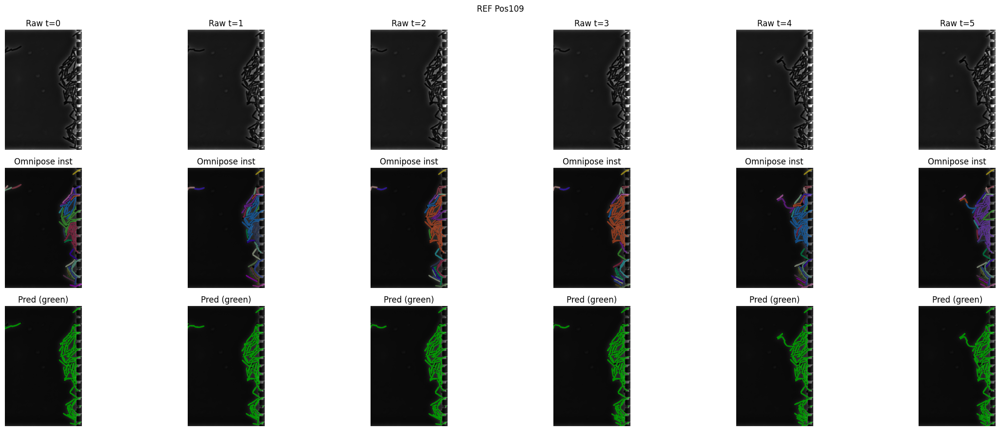

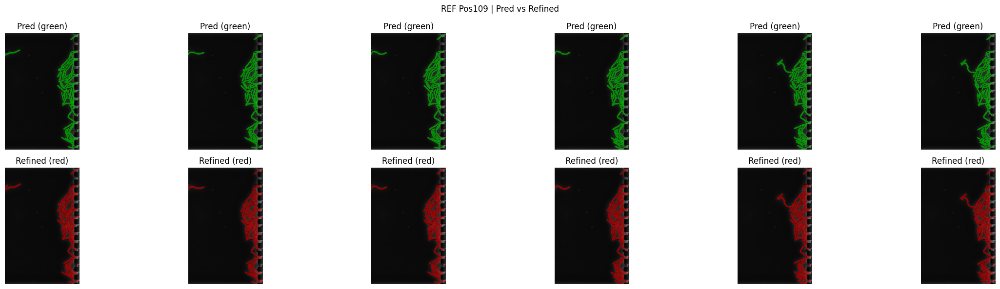

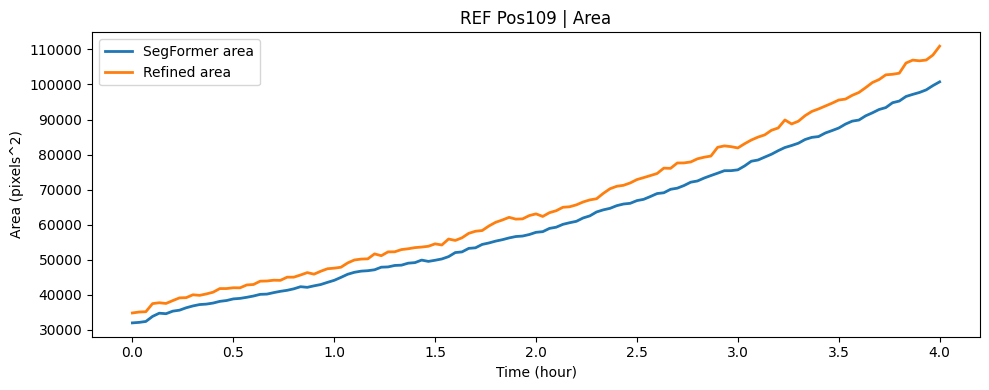

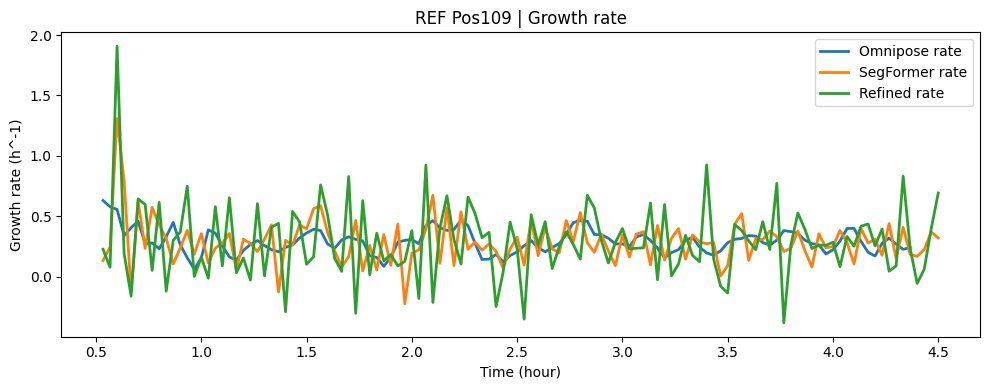


--- REF Pos110 ---


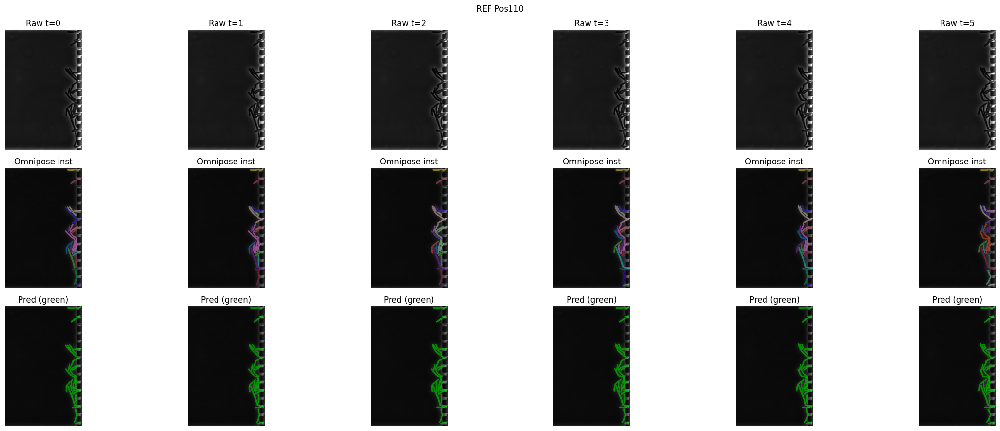

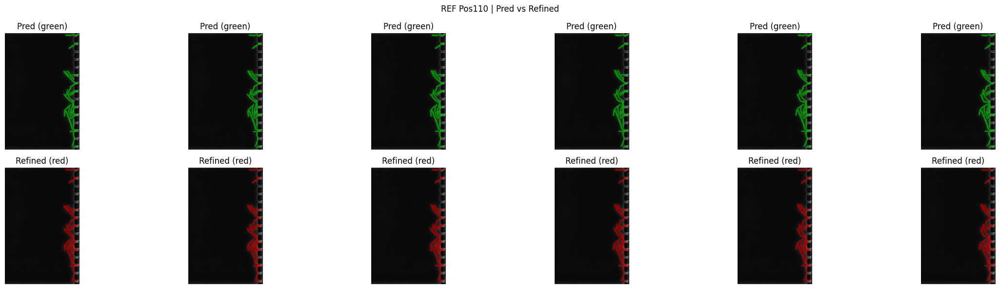

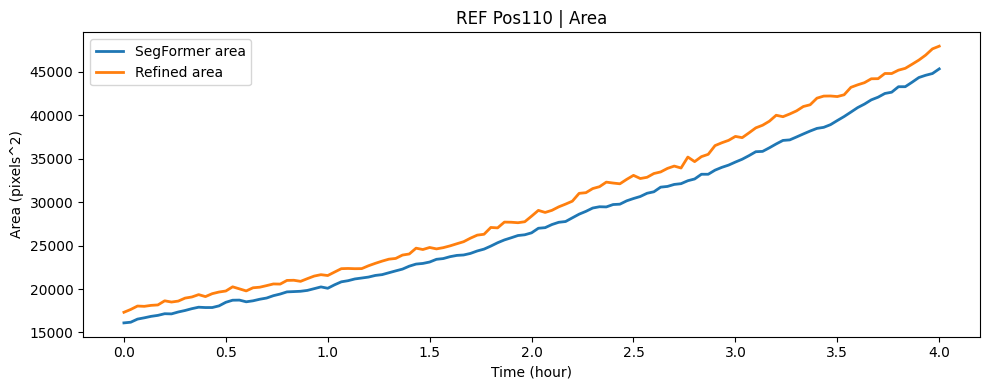

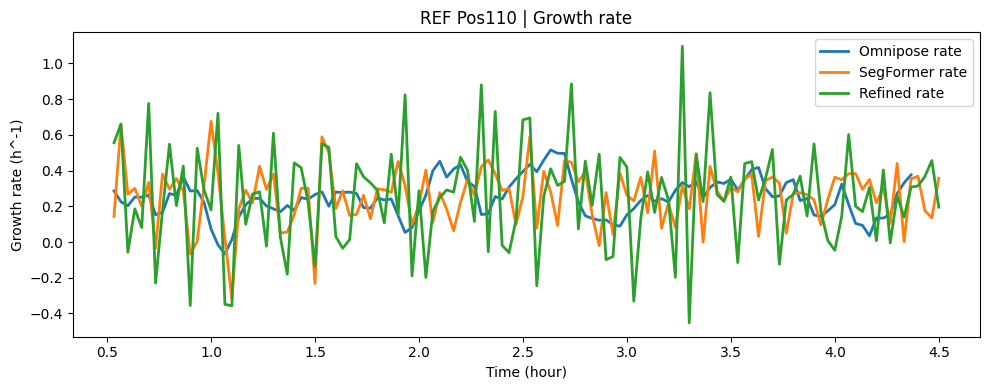


--- RIF Pos209 ---


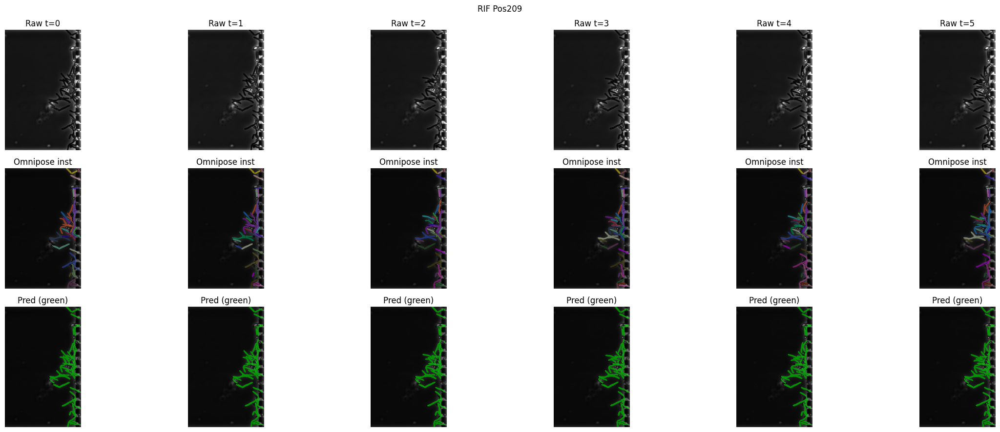

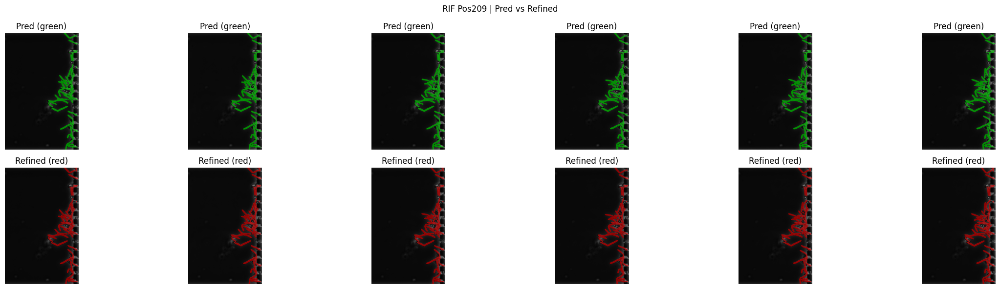

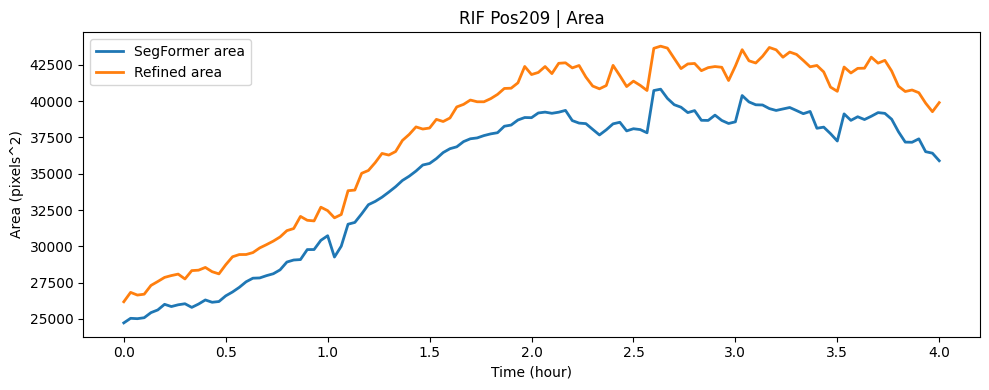

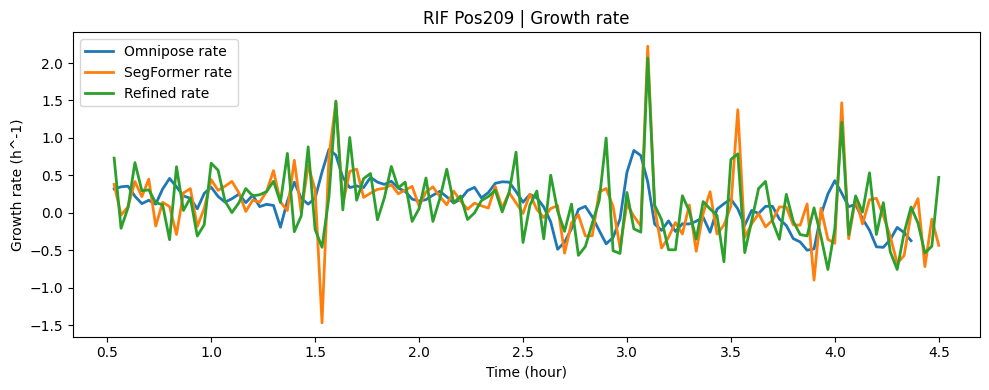


--- RIF Pos210 ---


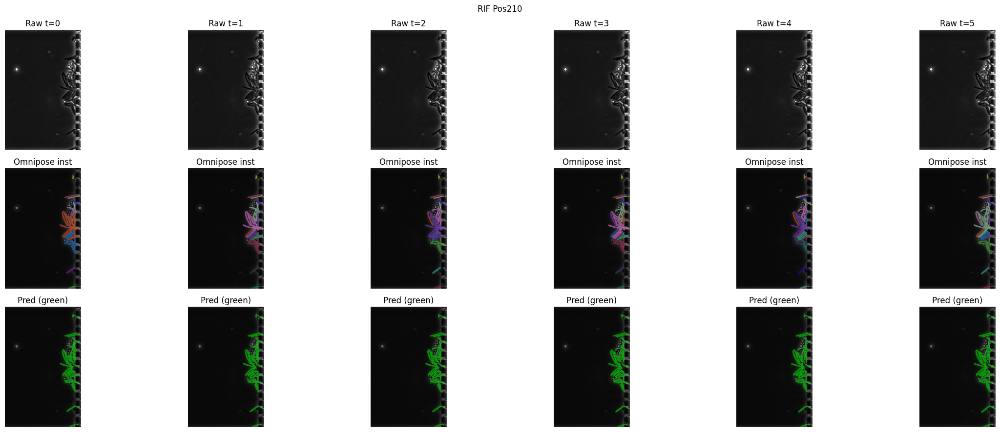

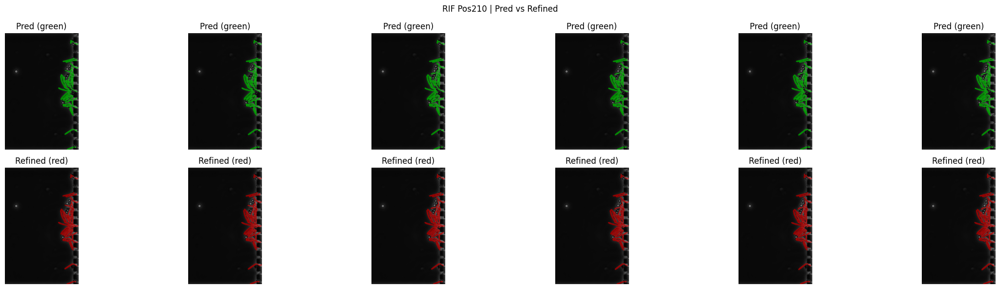

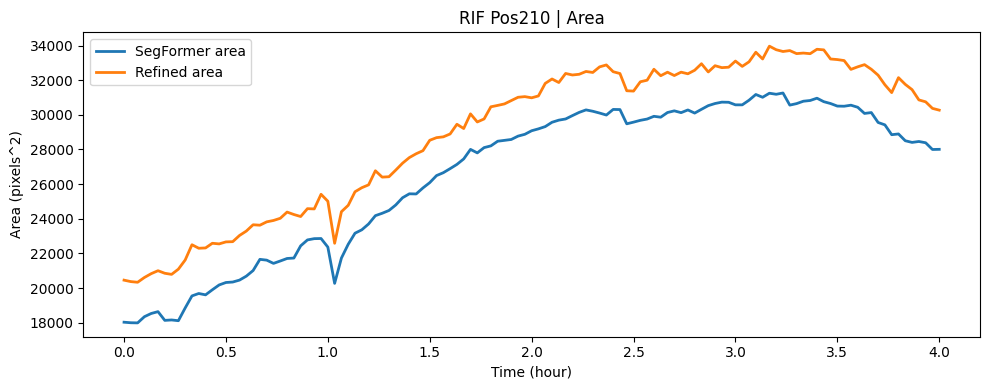

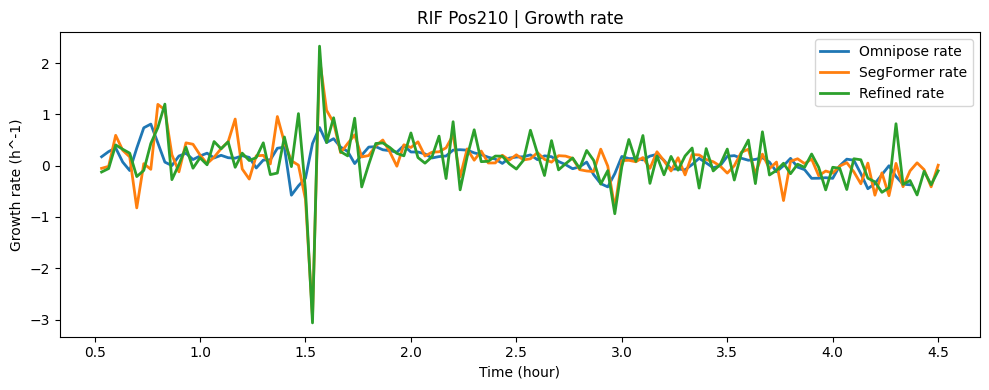

In [ ]:
print("\n==================== PER-WELL DEMOS (TEST SET) ====================")
# Run demos and save curves (so stacked plots work)
for wid in REF_TEST:
    print(f"\n--- REF Pos{wid} ---")
    _ = run_one_well_demo(model, "REF", wid, iou_thr_track=0.2, cover_thr_refine=0.25, rolling=ROLLING, no_smoothing_growth = True)

for wid in RIF_TEST:
    print(f"\n--- RIF Pos{wid} ---")
    _ = run_one_well_demo(model, "RIF", wid, iou_thr_track=0.2, cover_thr_refine=0.25, rolling=ROLLING, no_smoothing_growth = True)


==================== OPTIONAL: RUN ALL WELLS (for stacked plots) ====================
Running REF Pos101 (to create missing curves)


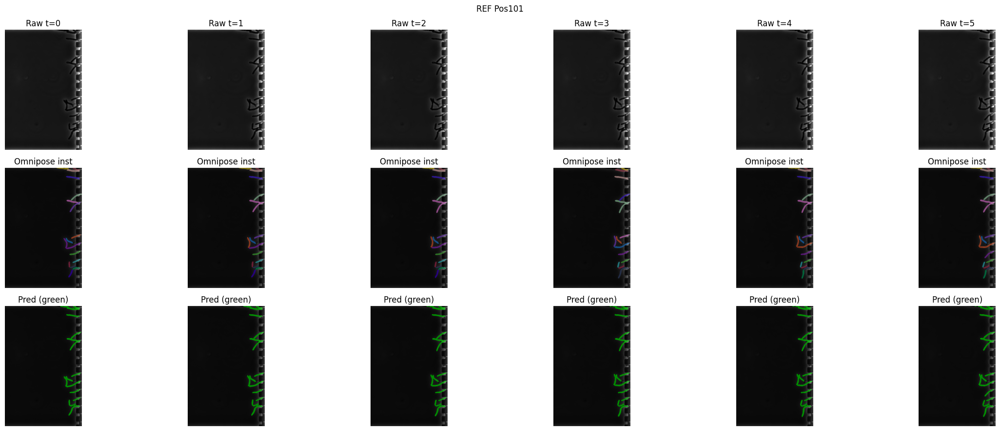

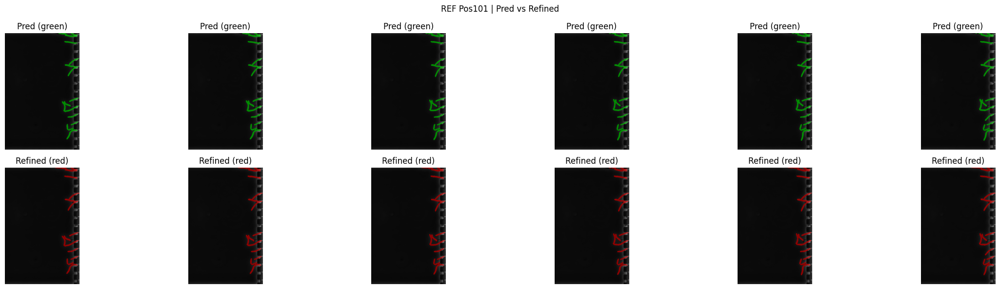

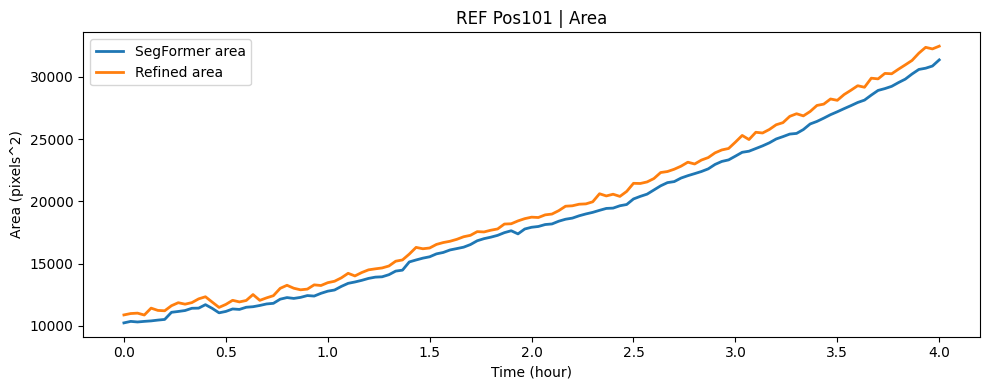

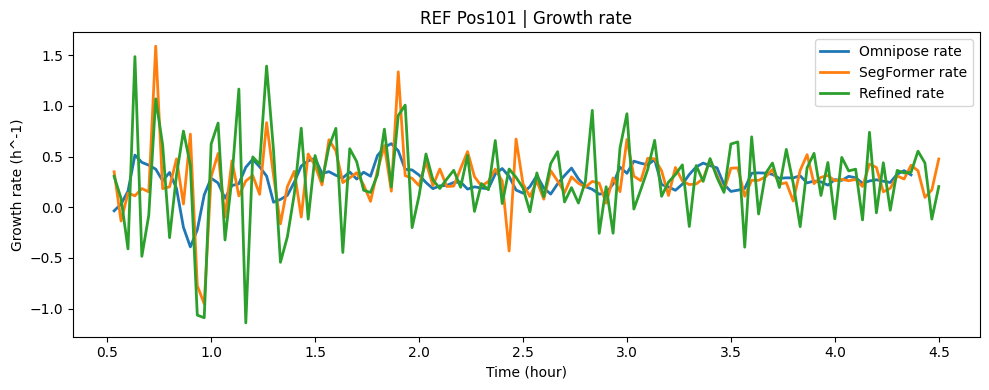

Running REF Pos102 (to create missing curves)


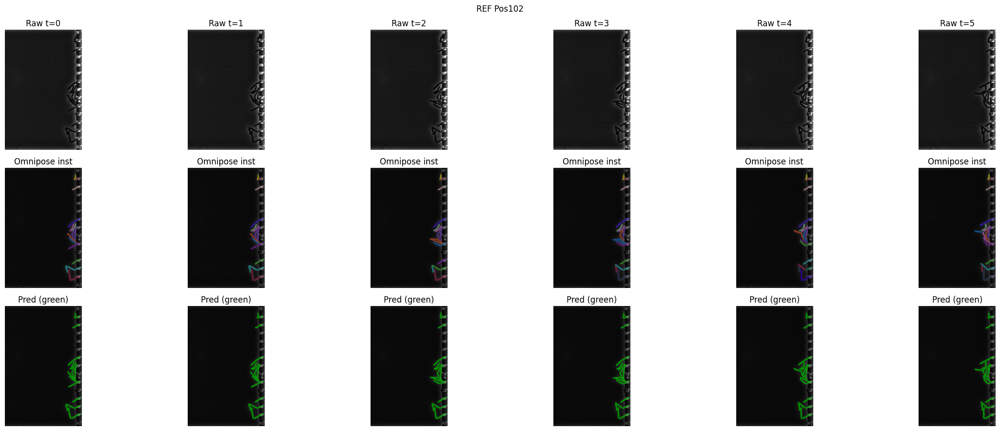

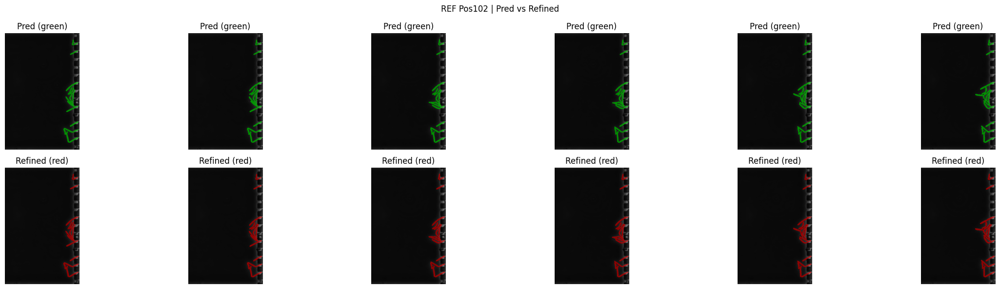

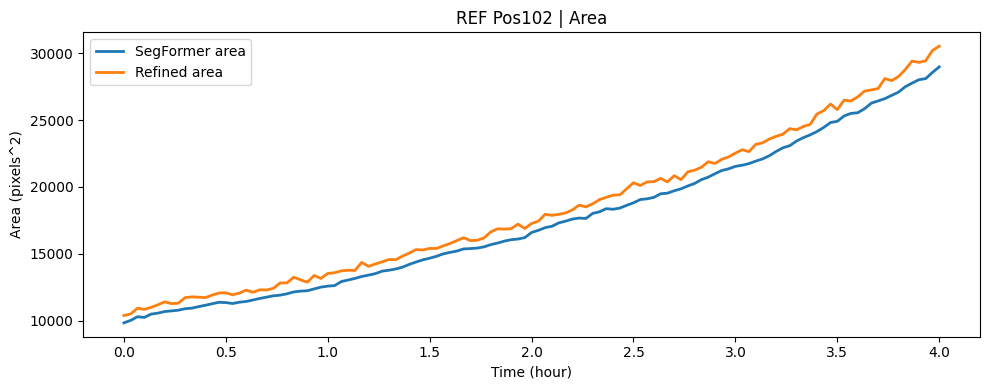

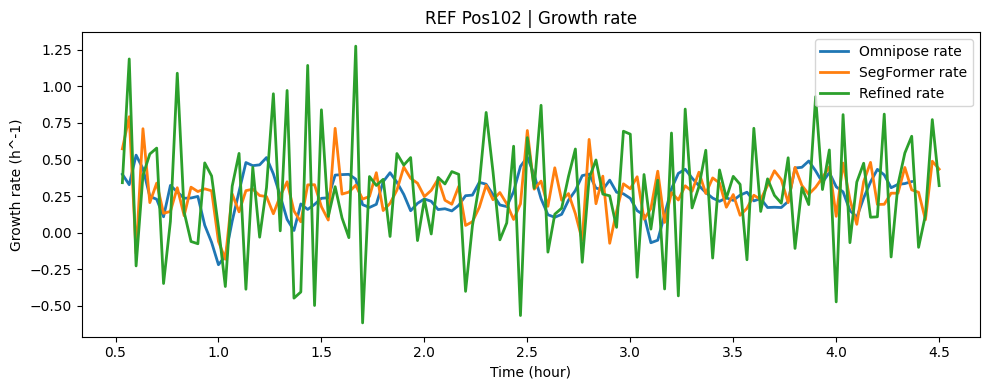

Running REF Pos103 (to create missing curves)


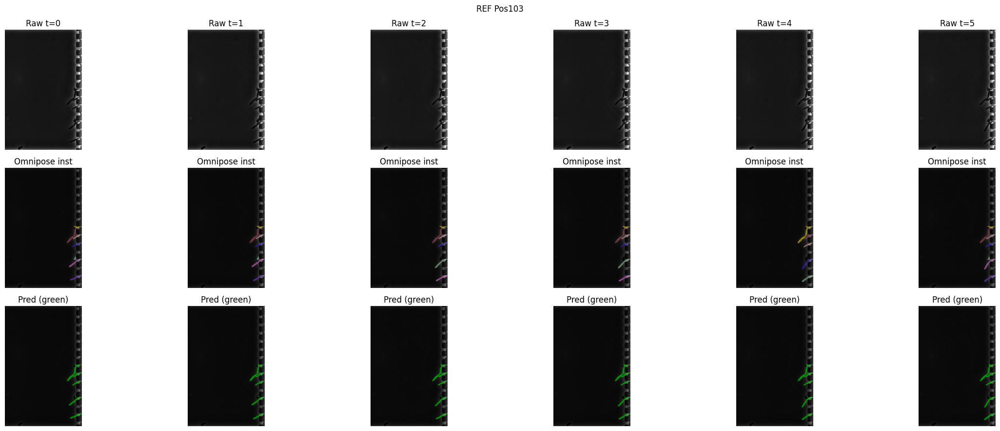

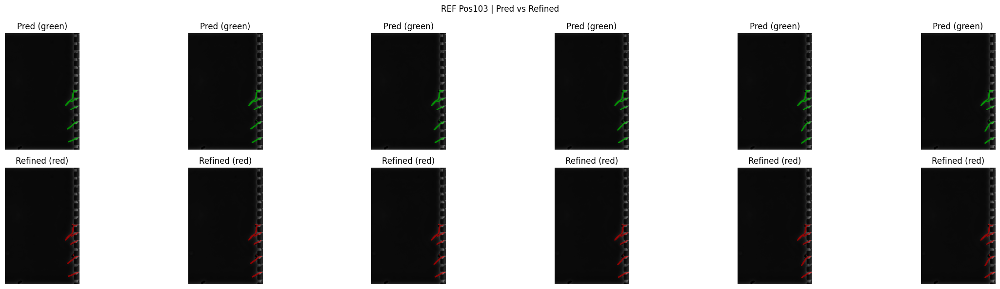

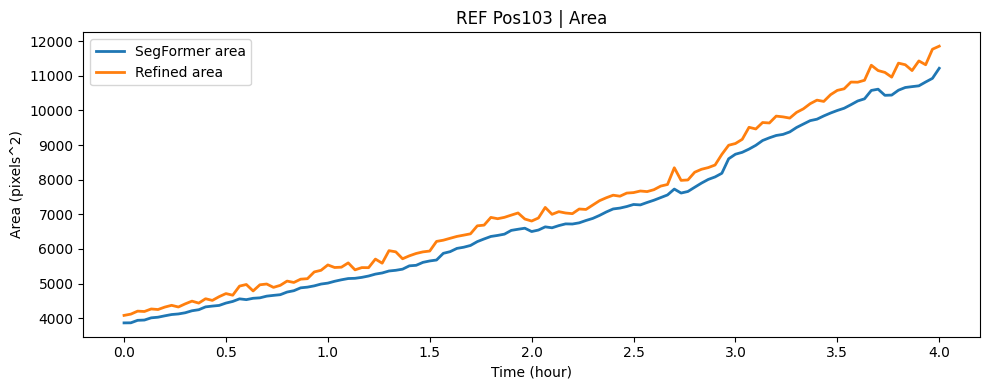

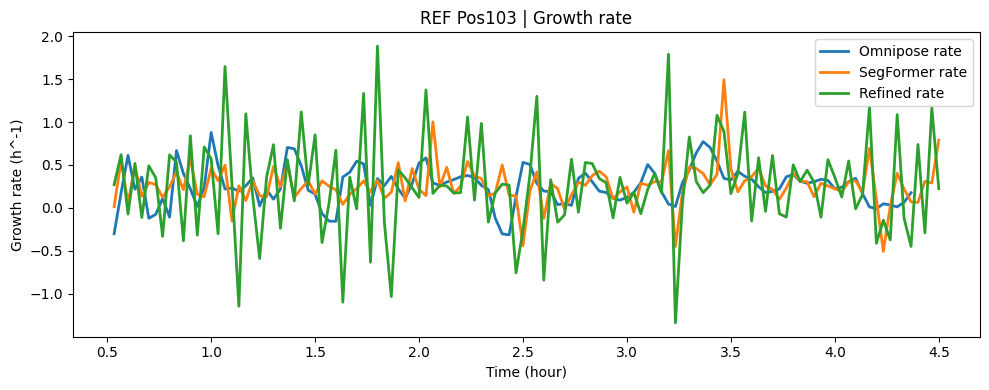

Running REF Pos104 (to create missing curves)


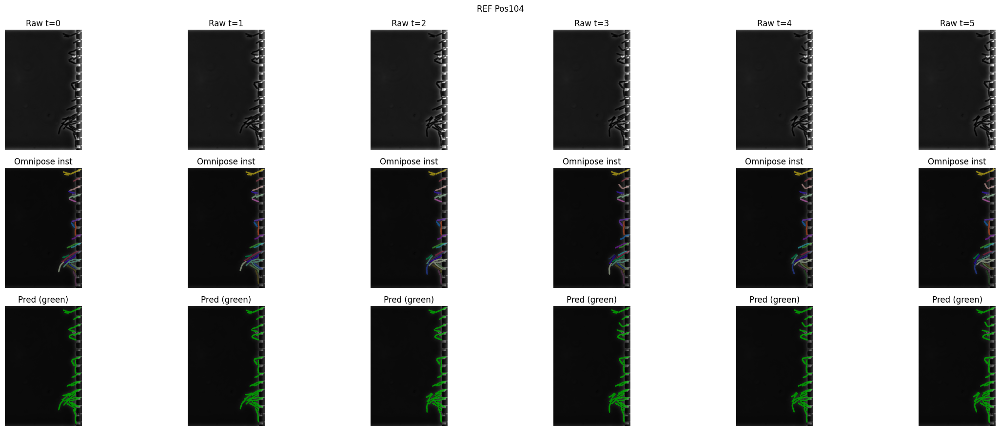

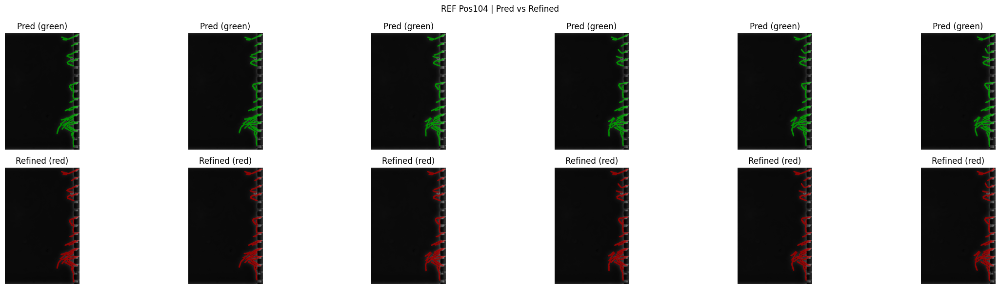

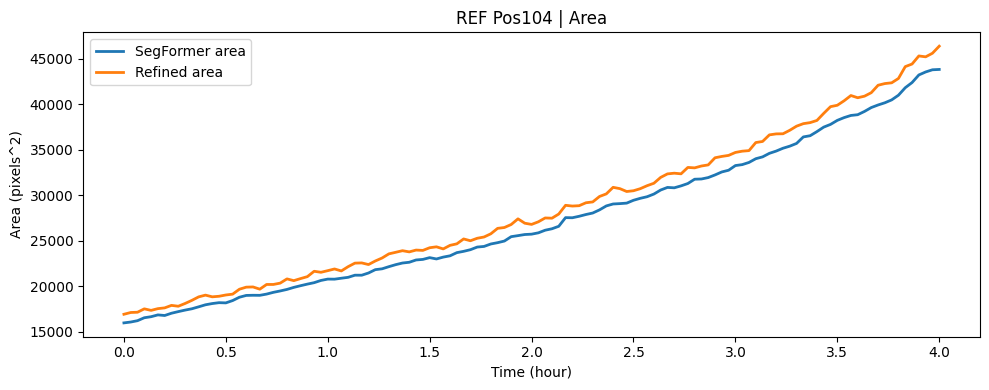

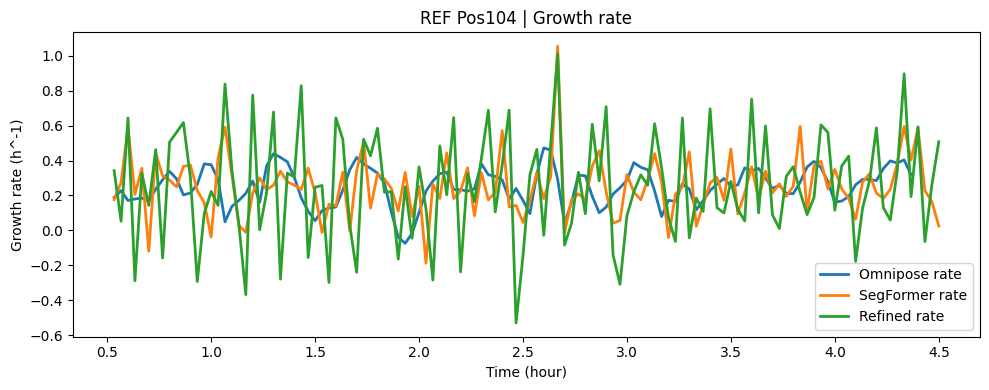

Running REF Pos105 (to create missing curves)


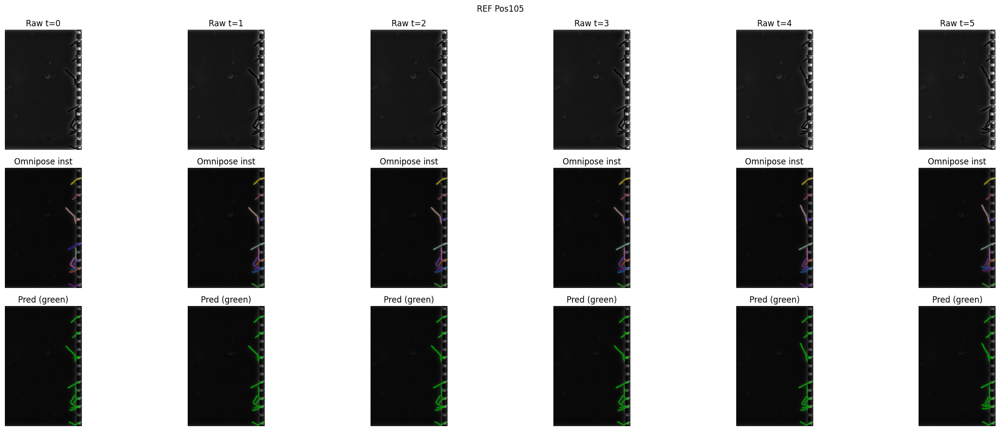

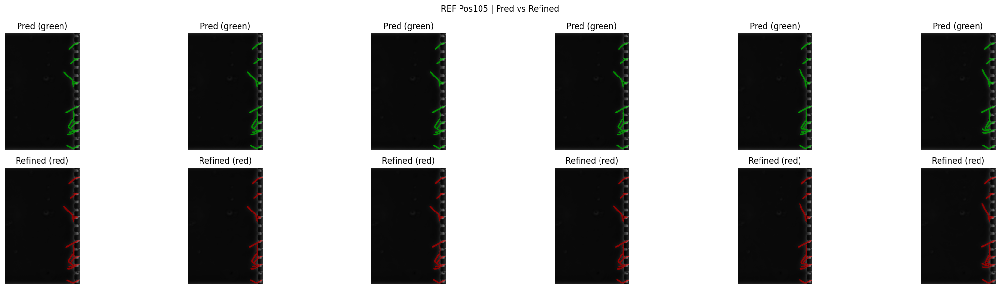

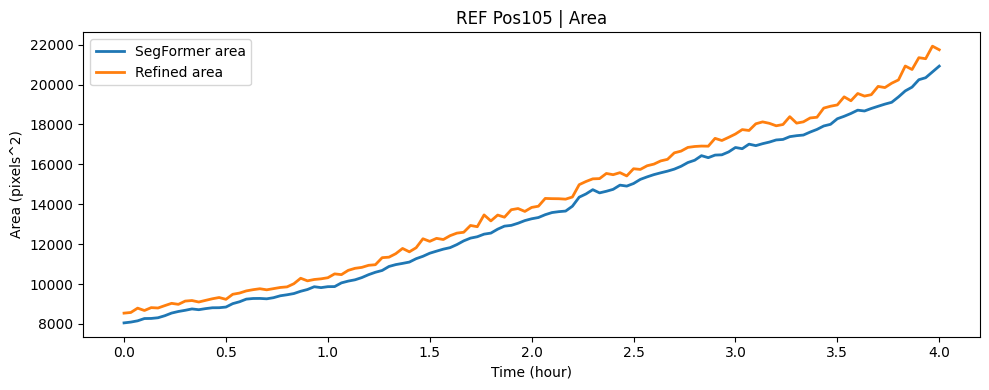

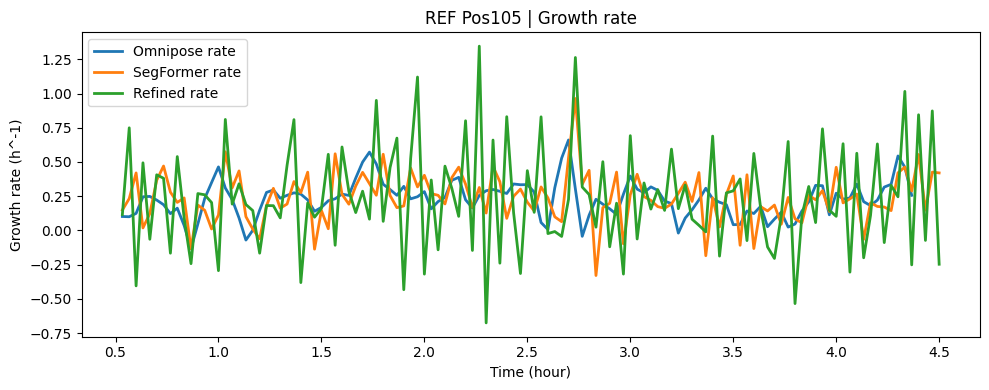

Running REF Pos106 (to create missing curves)


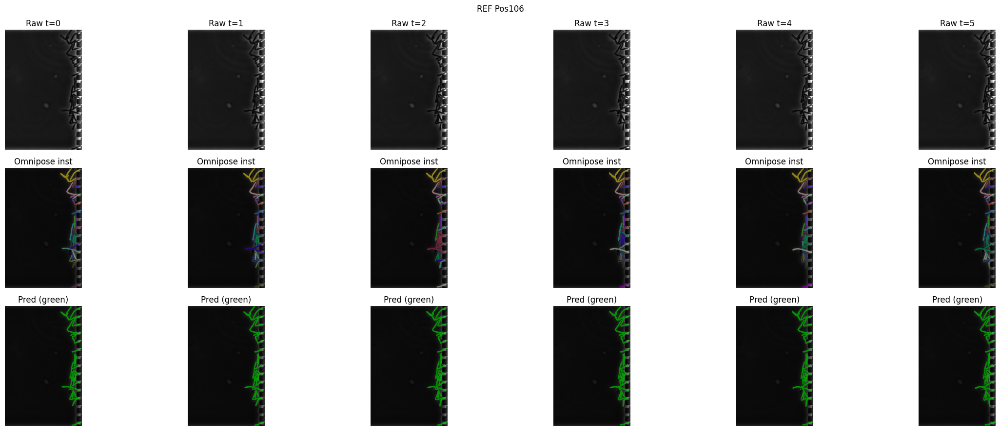

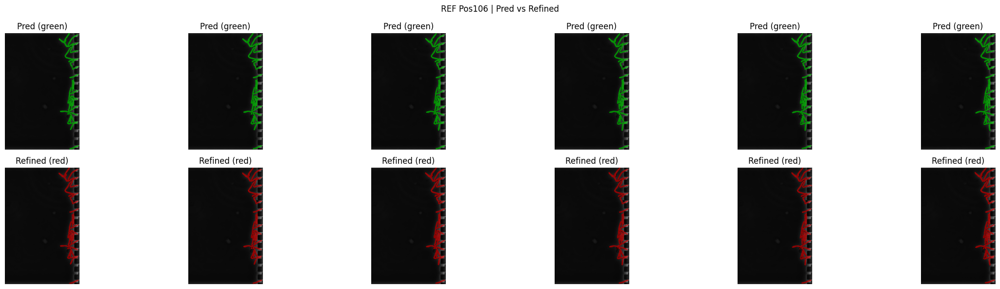

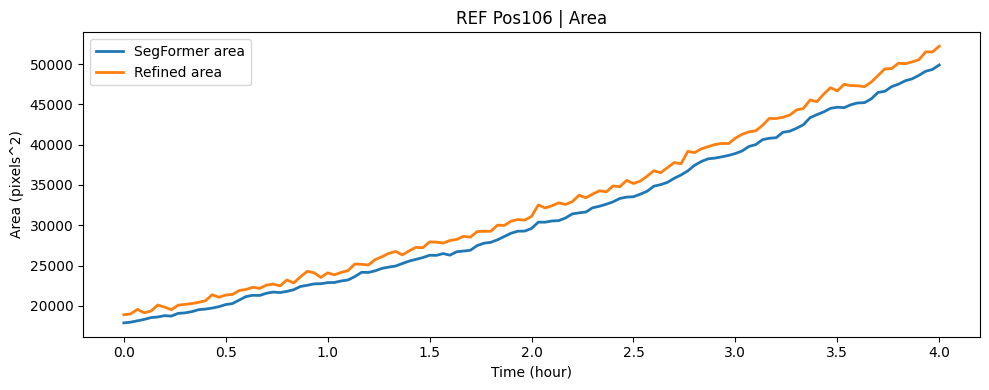

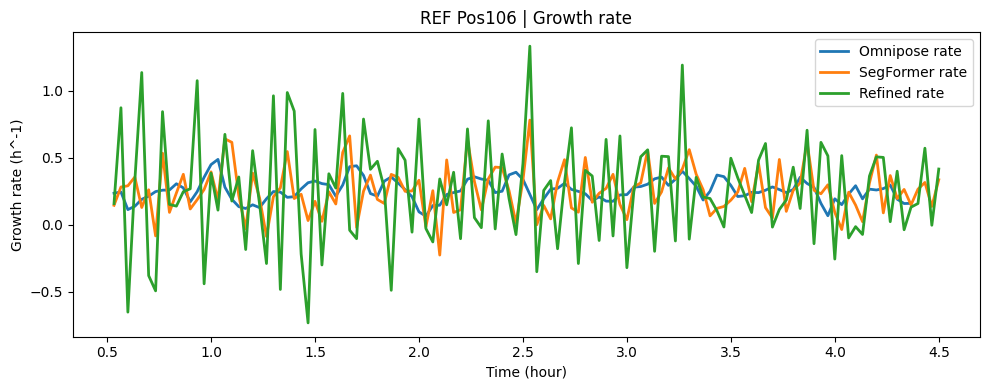

Running REF Pos107 (to create missing curves)


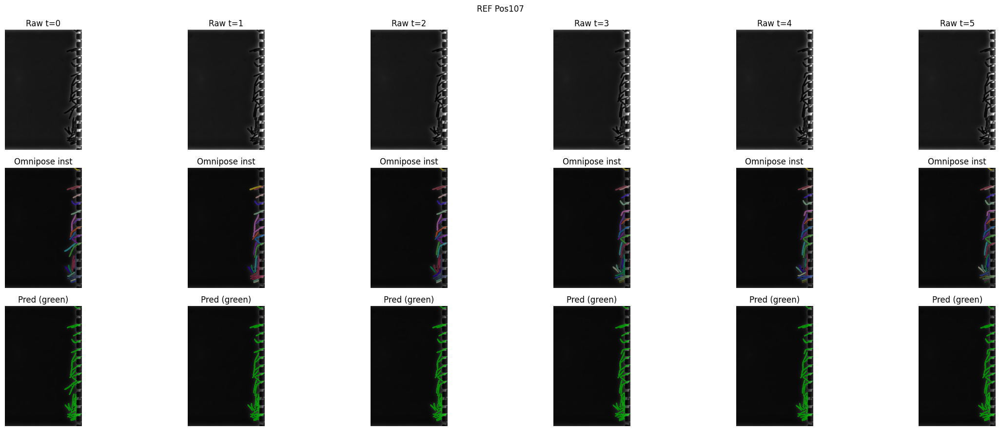

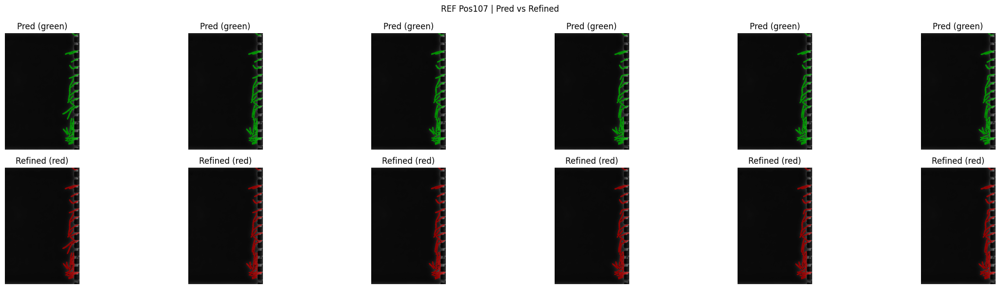

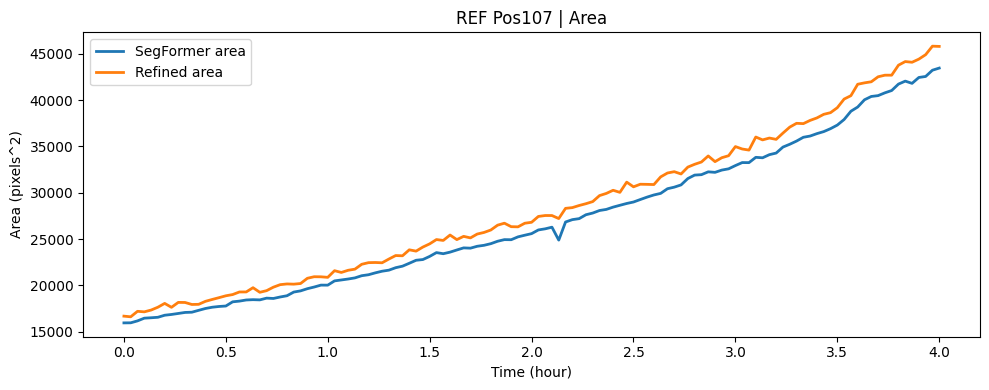

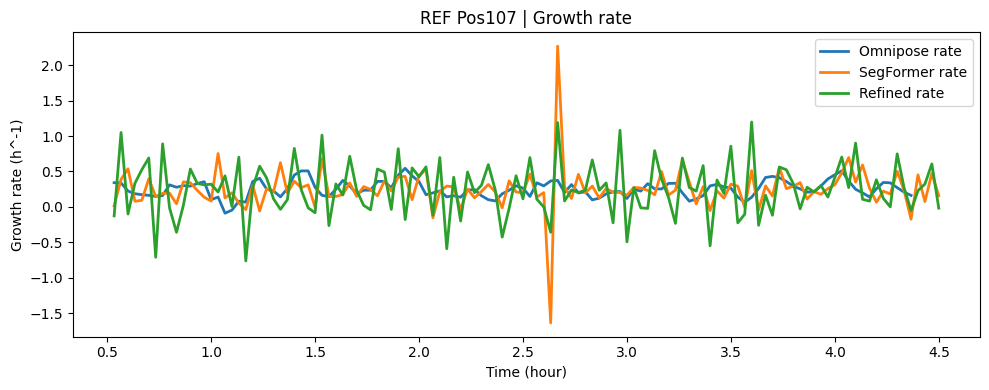

Running REF Pos108 (to create missing curves)


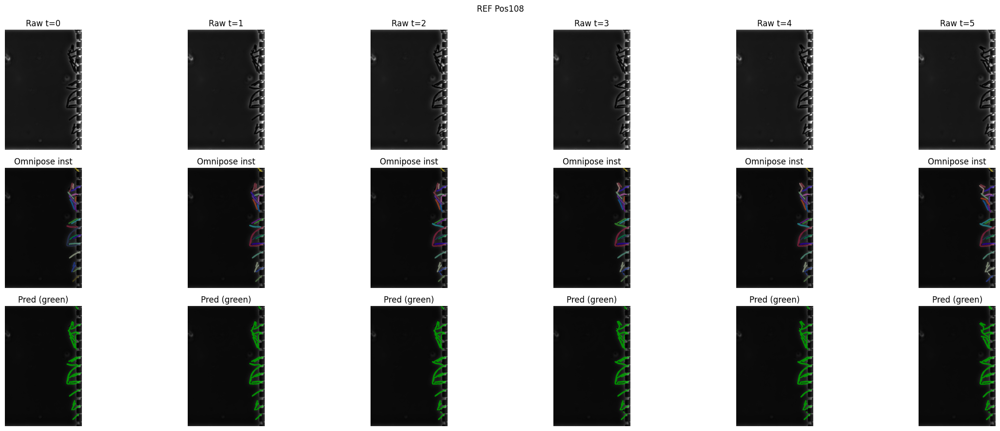

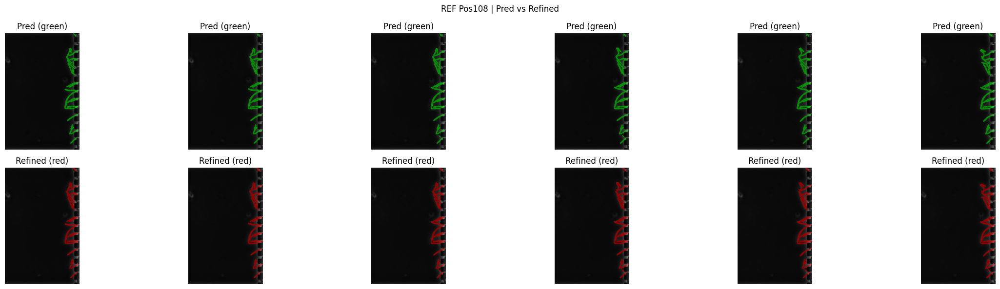

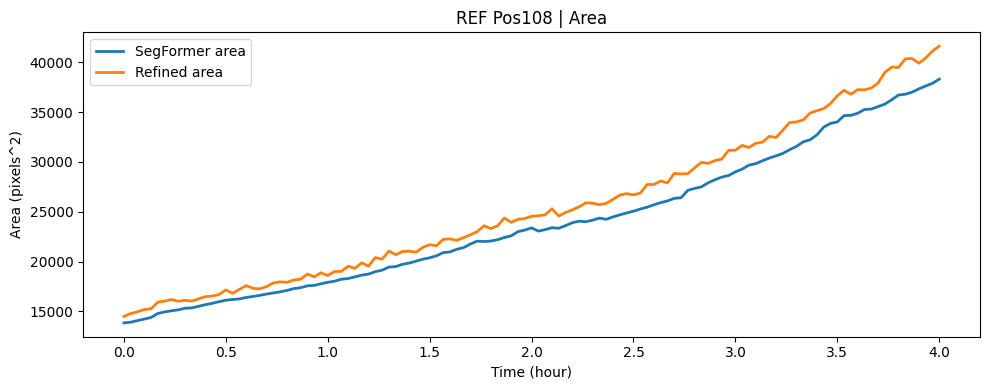

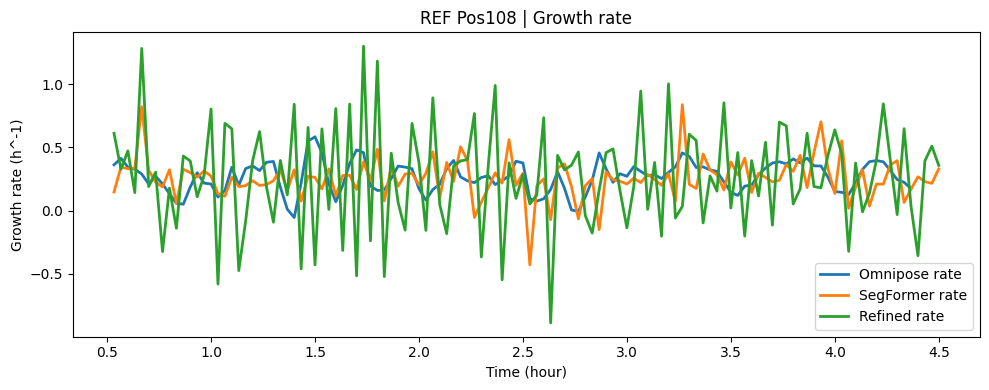

Running RIF Pos201 (to create missing curves)


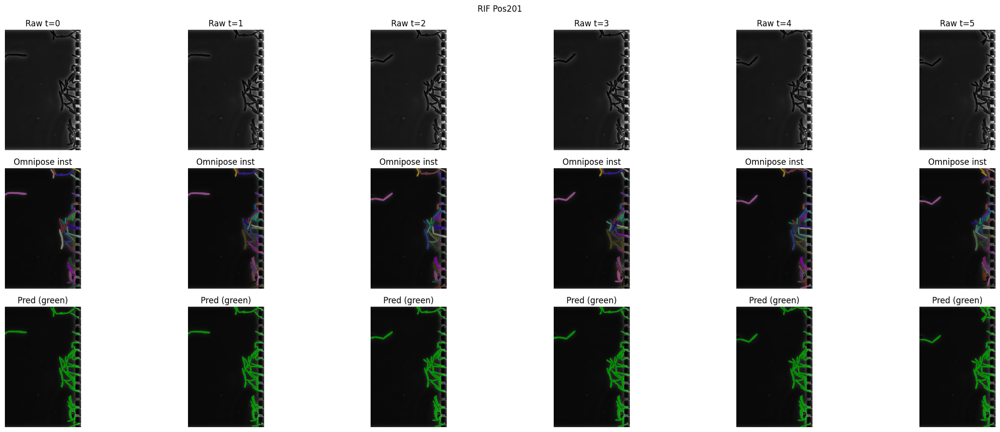

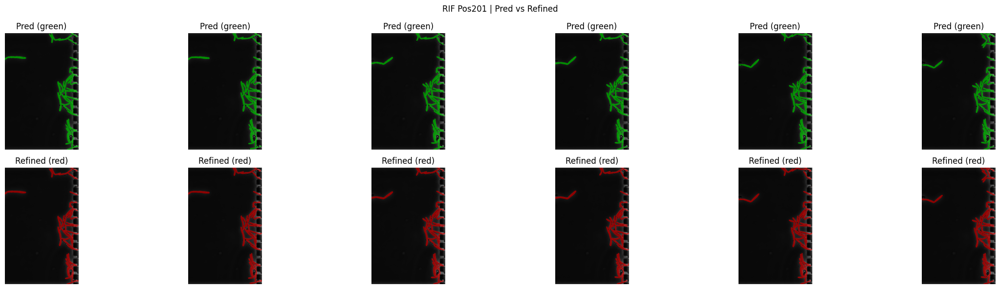

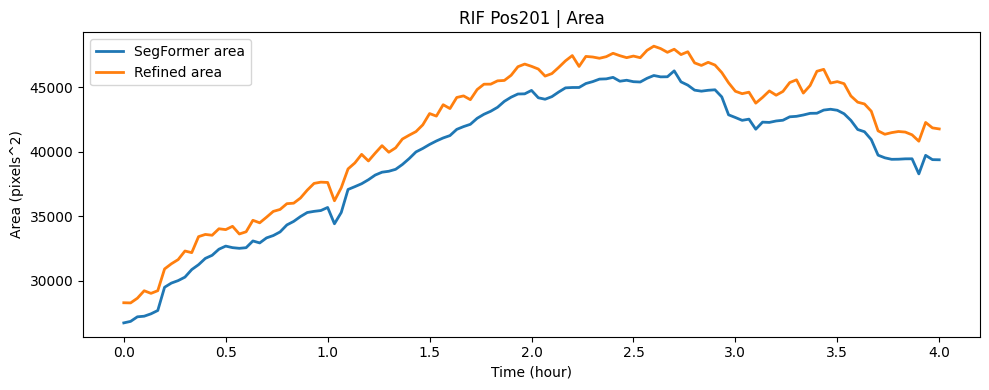

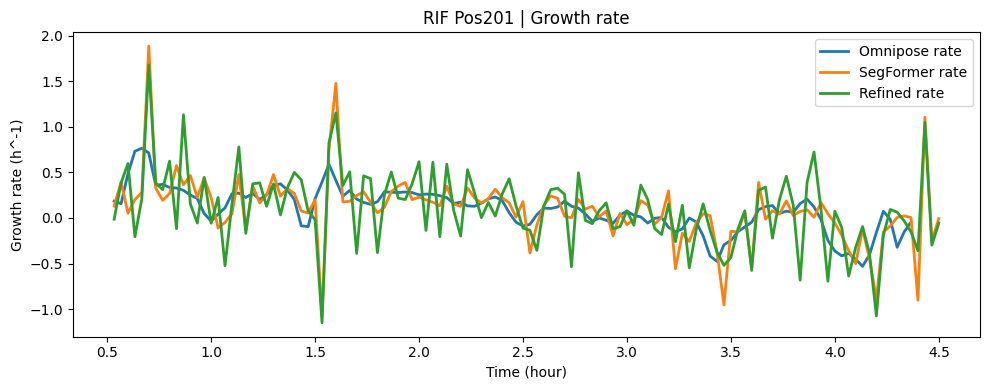

Running RIF Pos202 (to create missing curves)


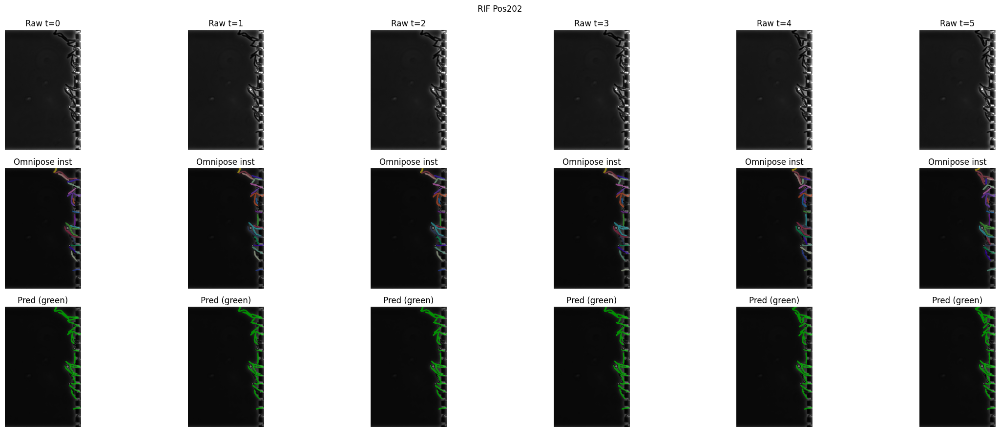

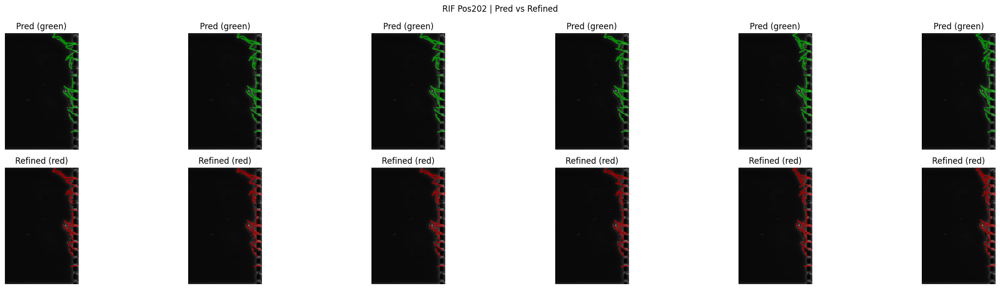

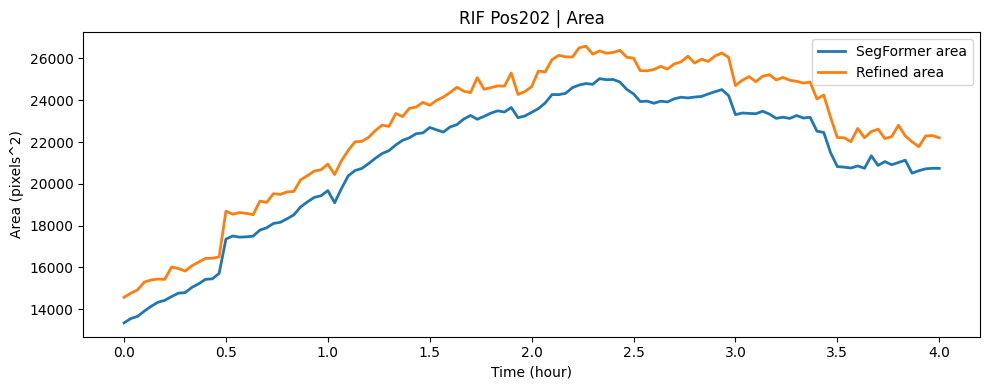

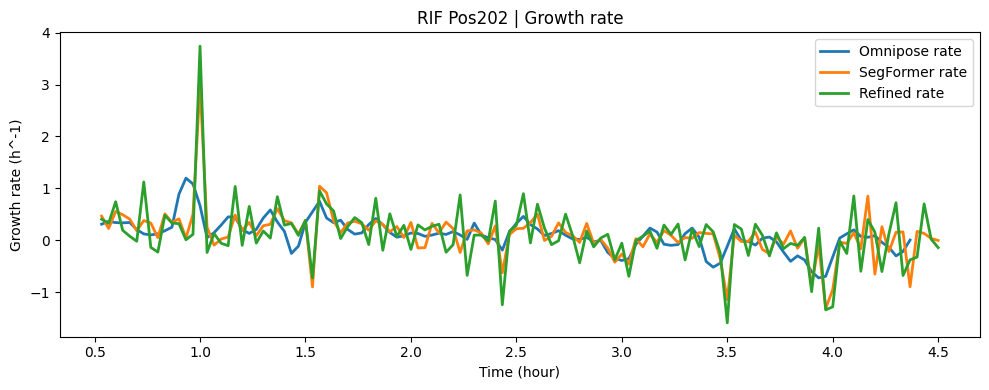

Running RIF Pos203 (to create missing curves)


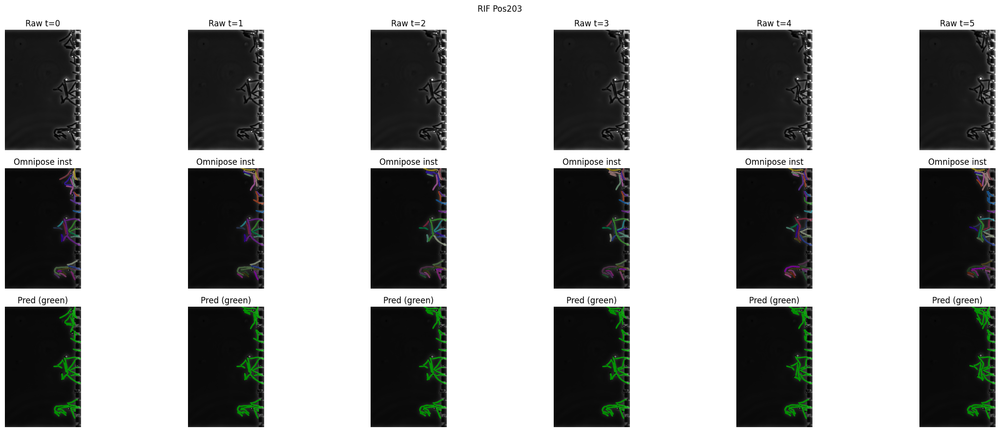

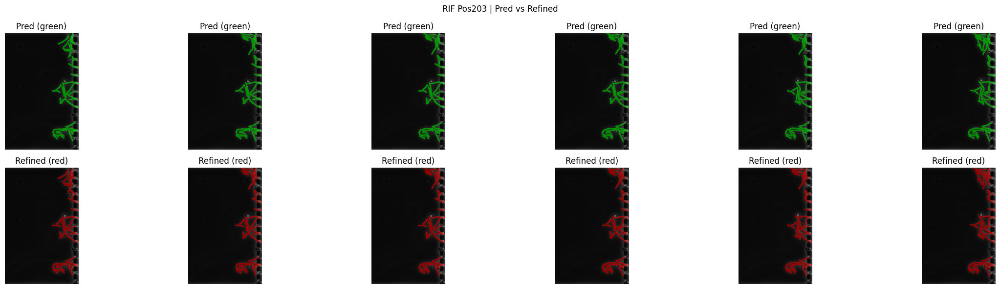

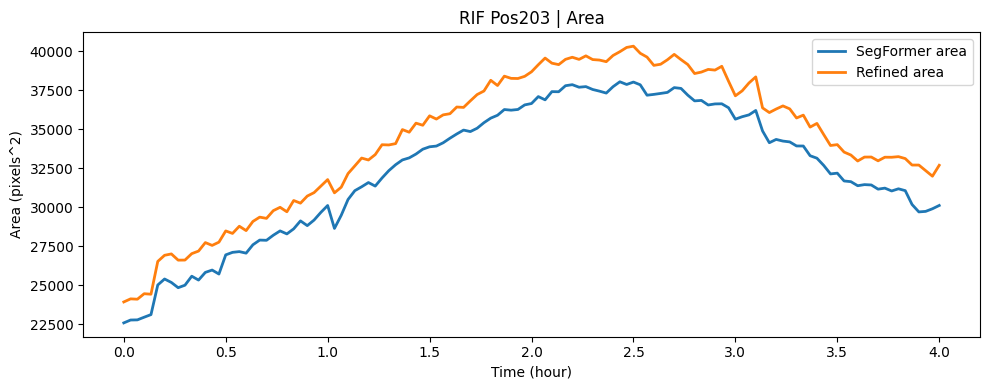

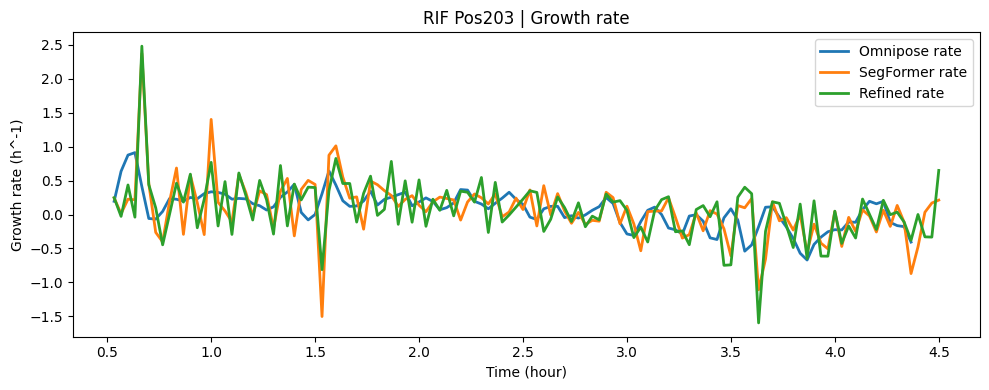

Running RIF Pos204 (to create missing curves)


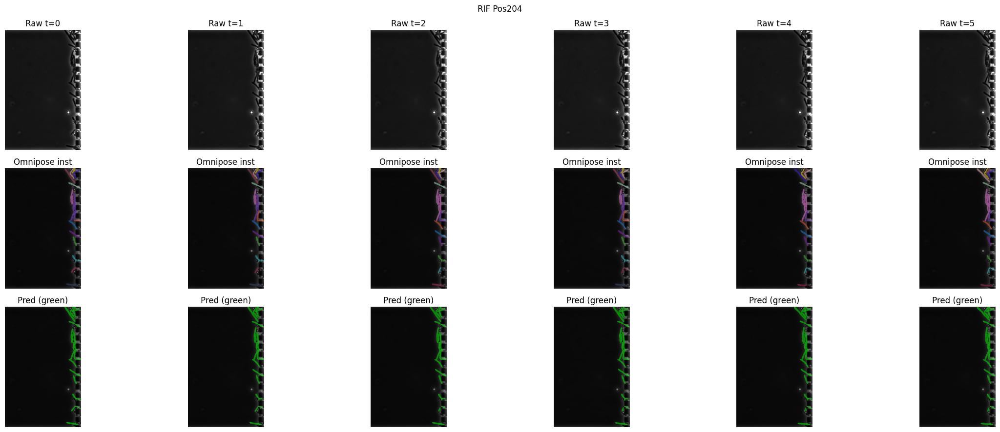

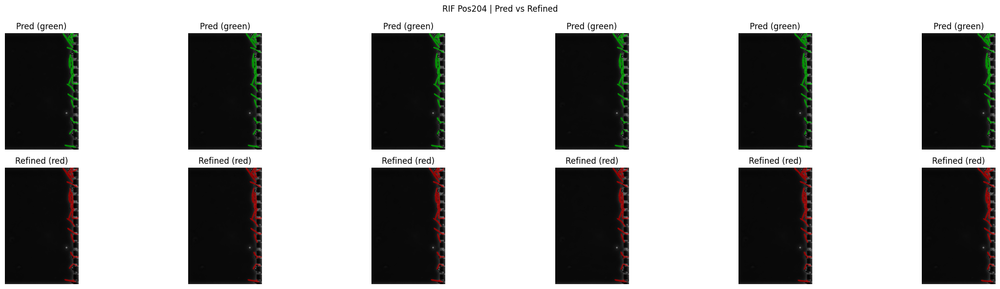

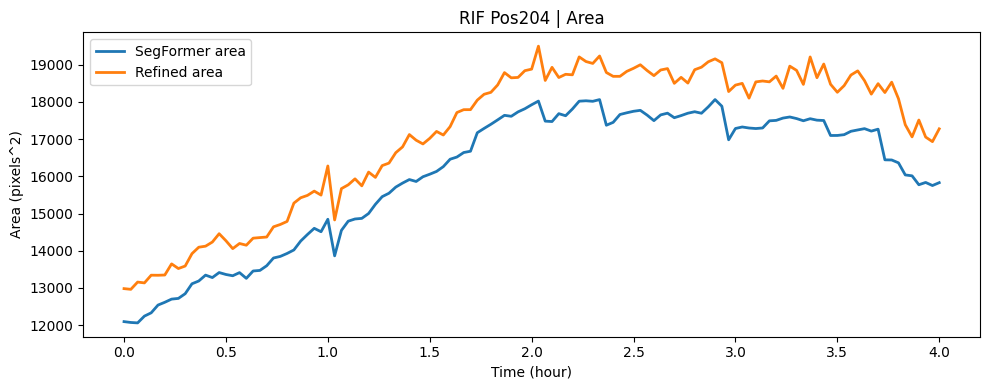

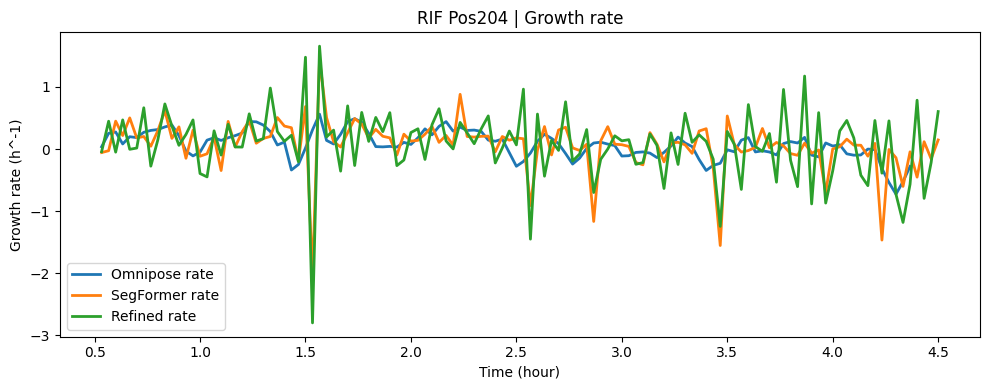

Running RIF Pos205 (to create missing curves)


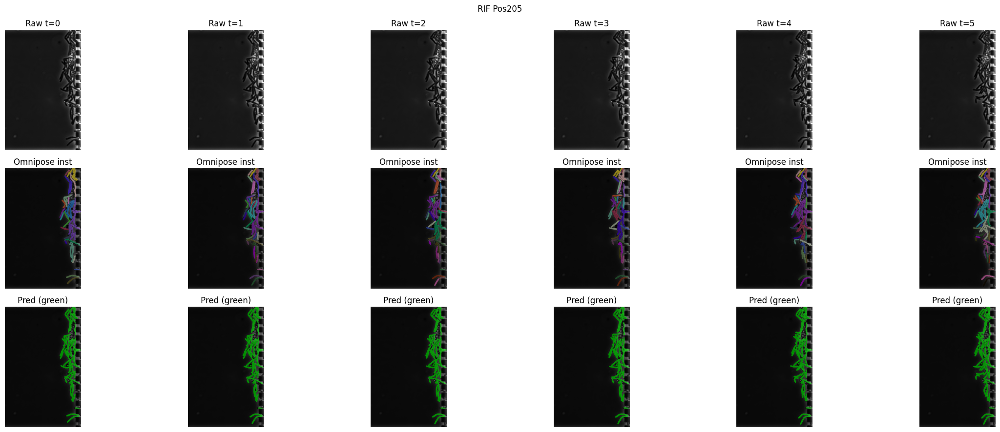

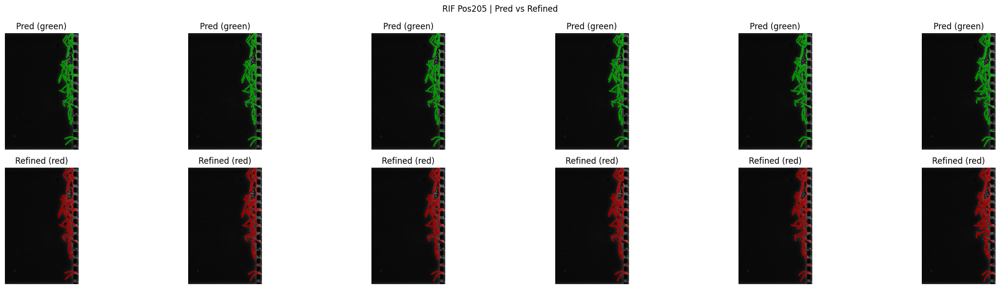

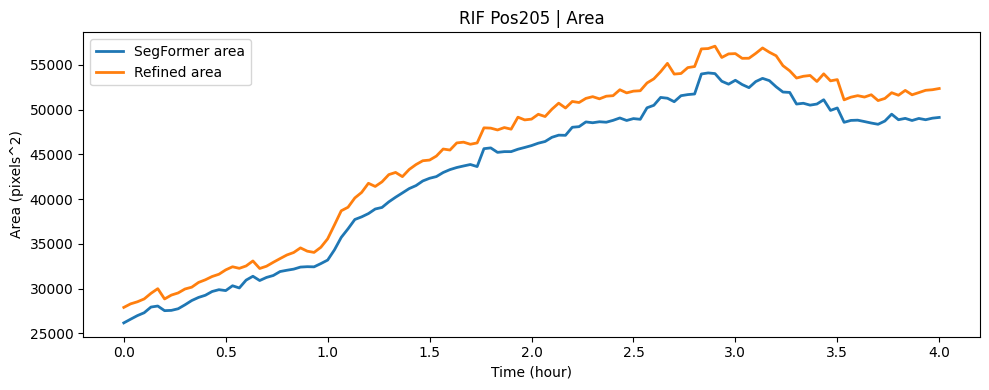

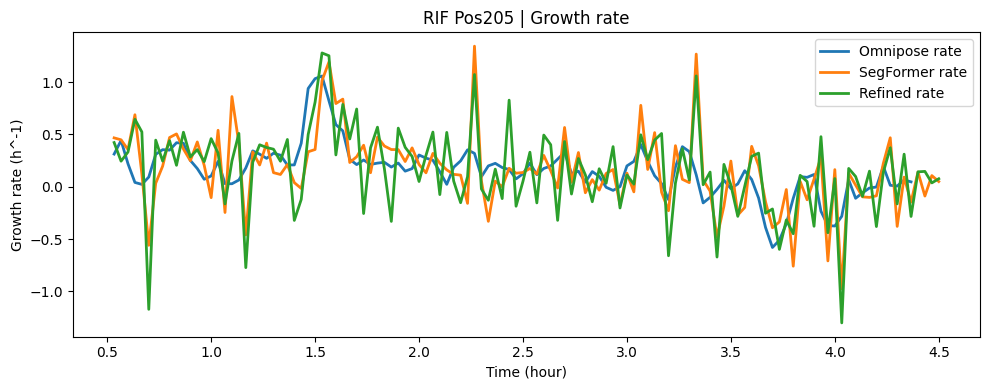

Running RIF Pos206 (to create missing curves)


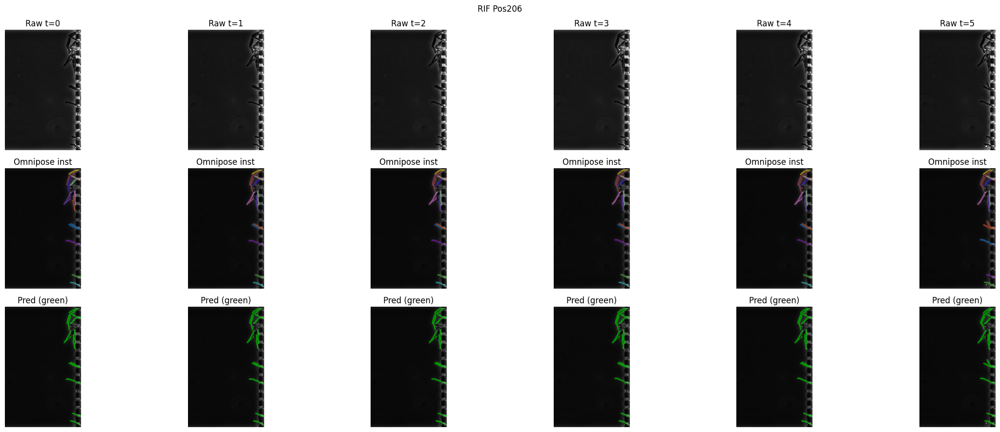

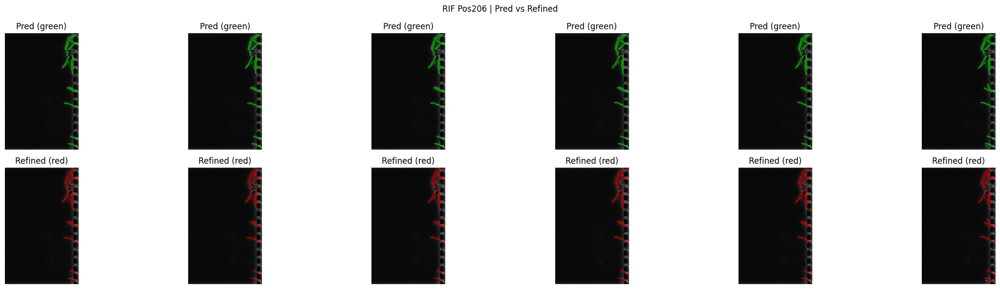

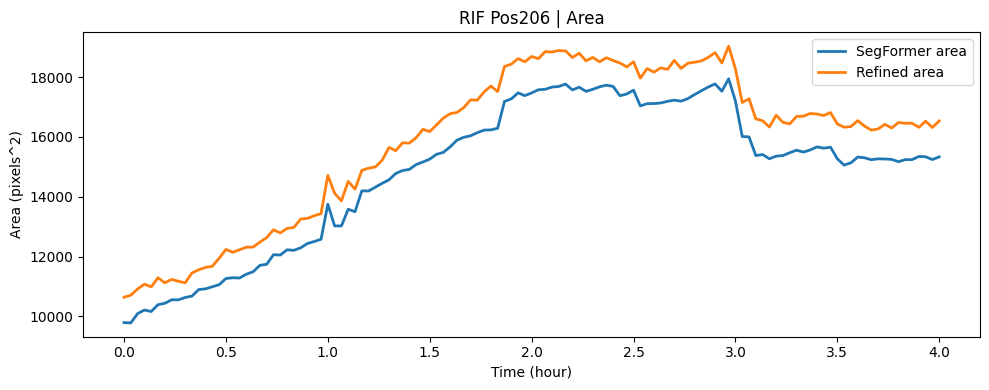

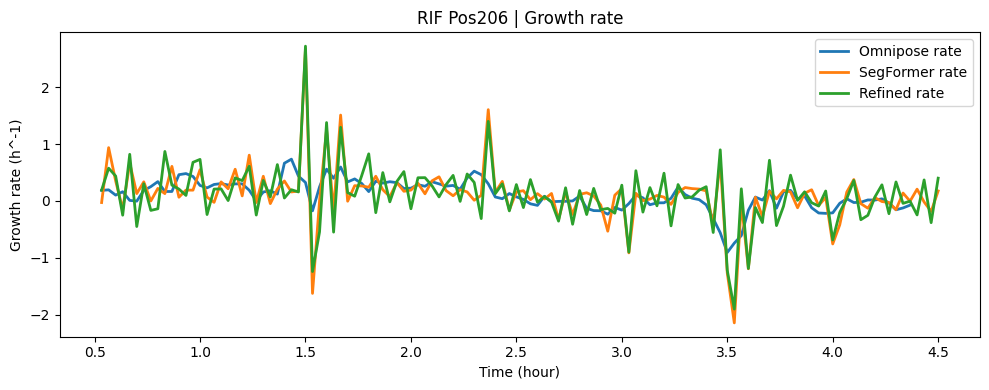

Running RIF Pos207 (to create missing curves)


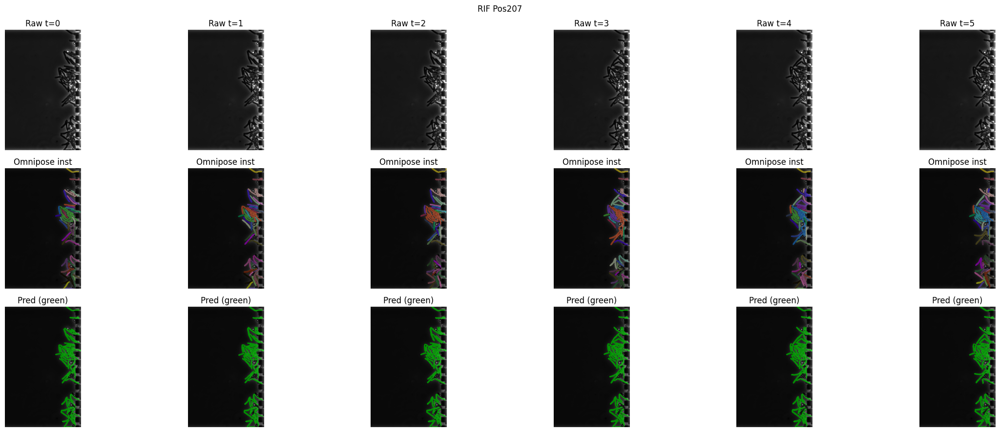

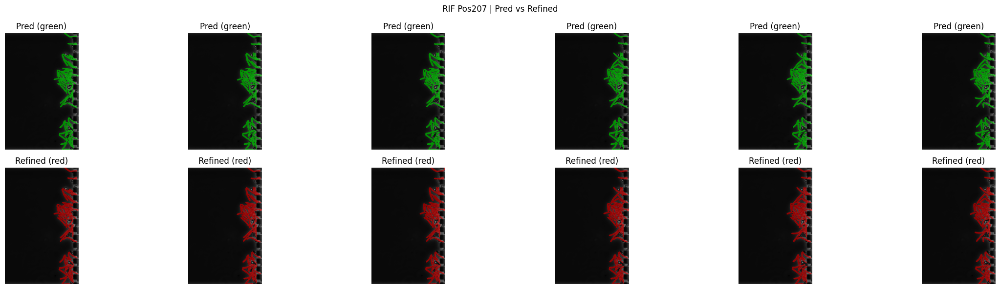

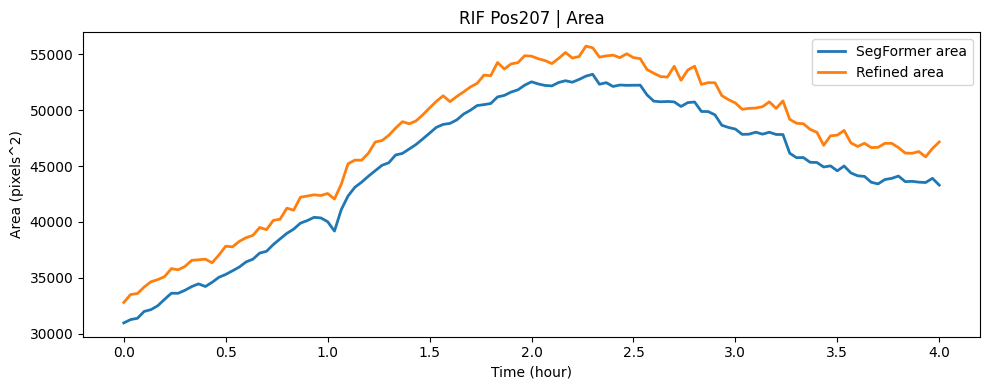

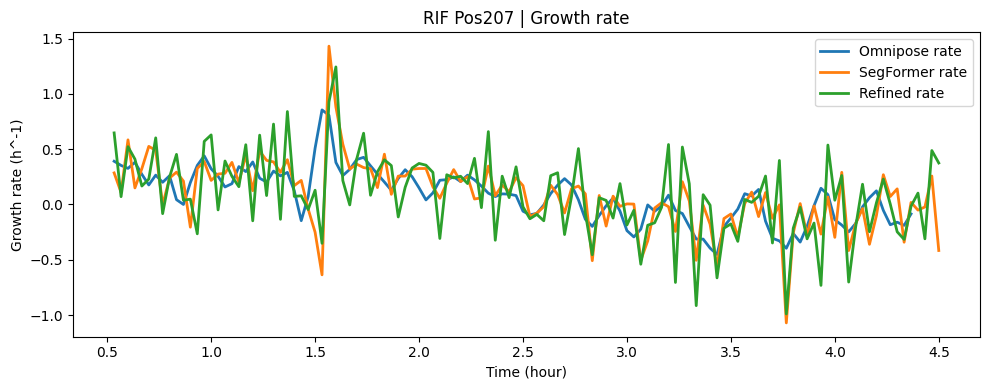

Running RIF Pos208 (to create missing curves)


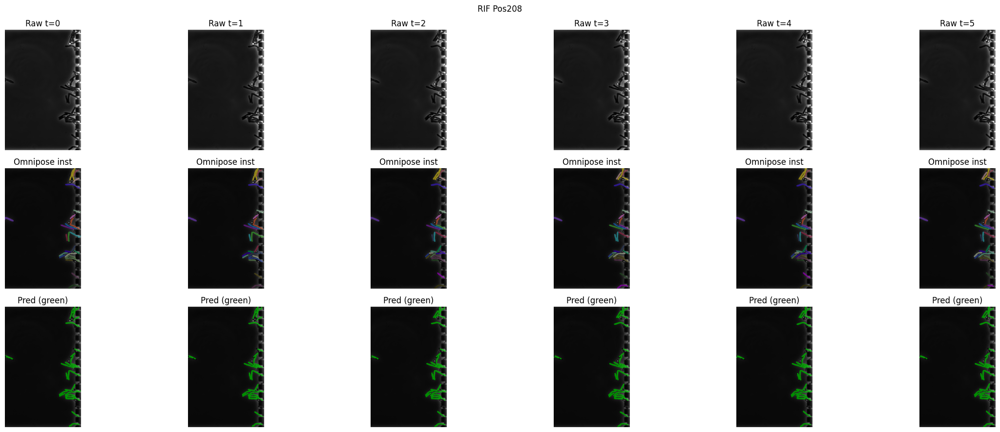

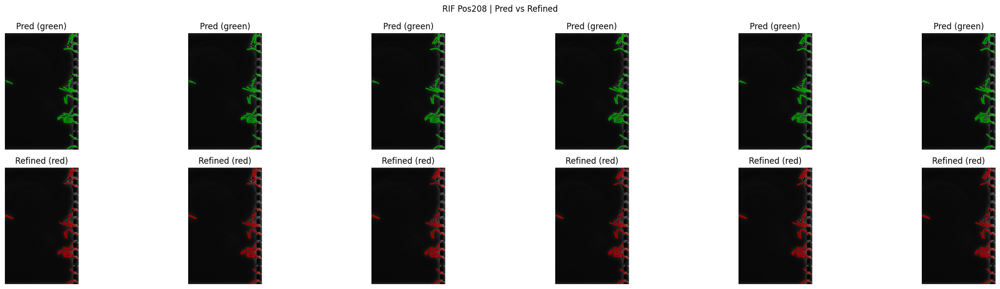

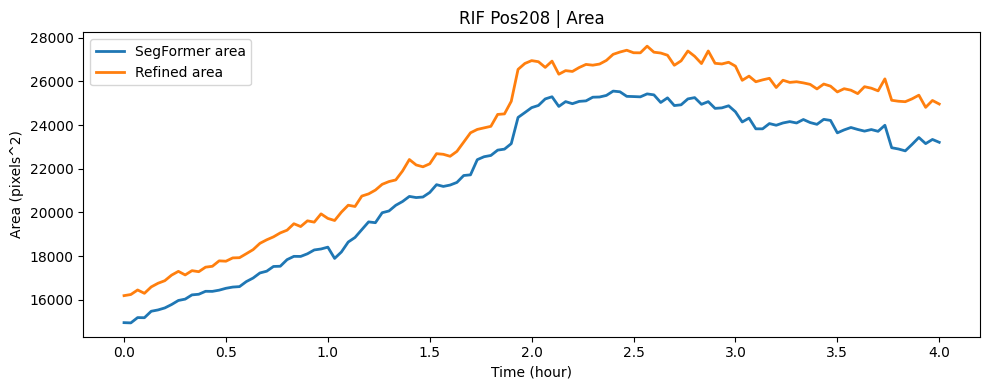

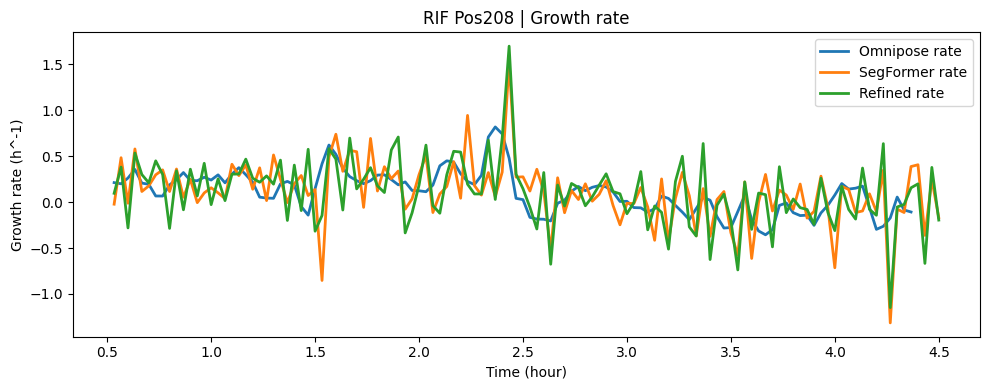

In [ ]:
print("\n==================== OPTIONAL: RUN ALL WELLS (for stacked plots) ====================")
# If you want stacked plots across ALL wells, ensure curves exist for all wells:
DO_ALL_WELLS = True
if DO_ALL_WELLS:
    for wid in REF_WELLS:
        wdir = os.path.join(RUN_DIR, f"REF_Pos{wid}")
        if not os.path.exists(os.path.join(wdir, "area_refined.npy")):
            print(f"Running REF Pos{wid} (to create missing curves)")
            _ = run_one_well_demo(model, "REF", wid, iou_thr_track=0.2, cover_thr_refine=0.25, rolling=ROLLING, no_smoothing_growth = True)

    for wid in RIF_WELLS:
        wdir = os.path.join(RUN_DIR, f"RIF_Pos{wid}")
        if not os.path.exists(os.path.join(wdir, "area_refined.npy")):
            print(f"Running RIF Pos{wid} (to create missing curves)")
            _ = run_one_well_demo(model, "RIF", wid, iou_thr_track=0.2, cover_thr_refine=0.25, rolling=ROLLING, no_smoothing_growth = True)




==================== NOTEBOOK-STYLE STACKED PLOTS ====================
✅ Model curves loaded: REF wells=10 shape_area=(10, 121) shape_rate=(10, 120) | RIF wells=10 shape_area=(10, 121) shape_rate=(10, 120)
✅ Loaded omnipose curves for REF: 10/10 wells | T=116
✅ Loaded omnipose curves for RIF: 10/10 wells | T=116


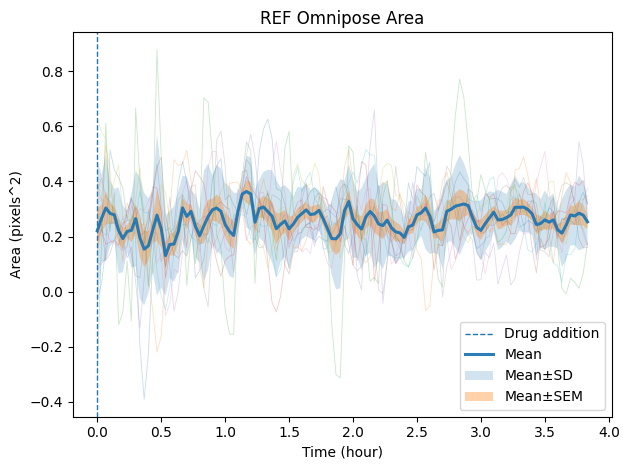

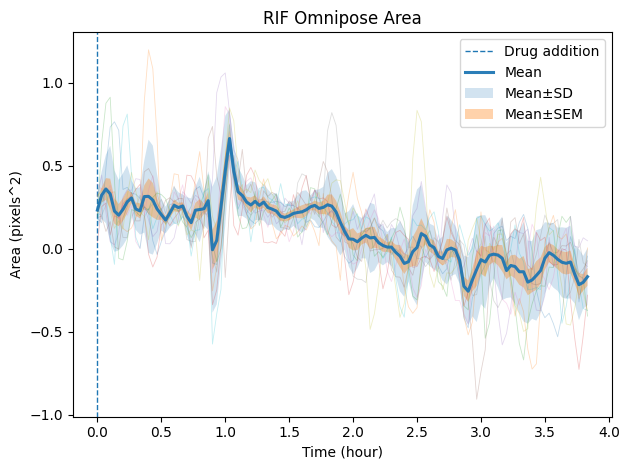

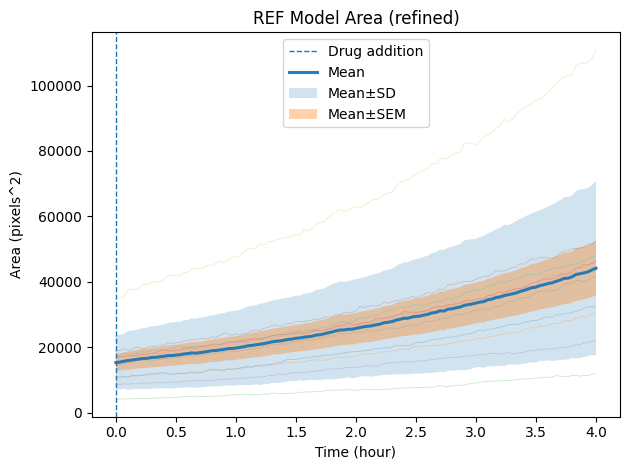

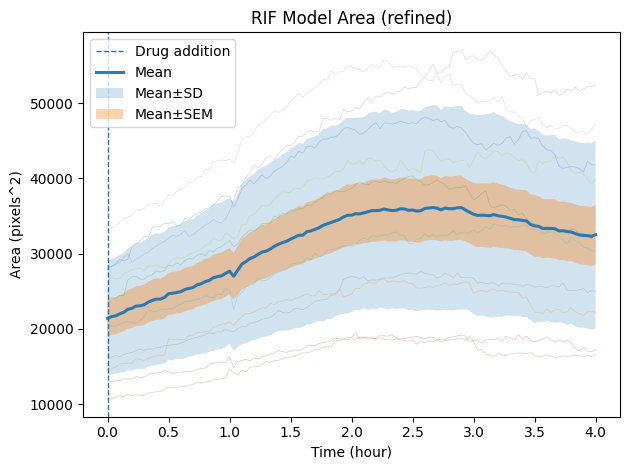

/tmp/ipython-input-4292825258.py:182: RuntimeWarning: Mean of empty slice
  mean = np.nanmean(stacked_2d, axis=0)
/usr/local/lib/python3.12/dist-packages/numpy/lib/_nanfunctions_impl.py:2035: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipython-input-4292825258.py:184: SmallSampleWarning: After omitting NaNs, one or more axis-slices of one or more sample arguments is too small; corresponding elements of returned arrays will be NaN. See documentation for sample size requirements.
  sem  = stats.sem(stacked_2d, axis=0, ddof=1, nan_policy="omit")


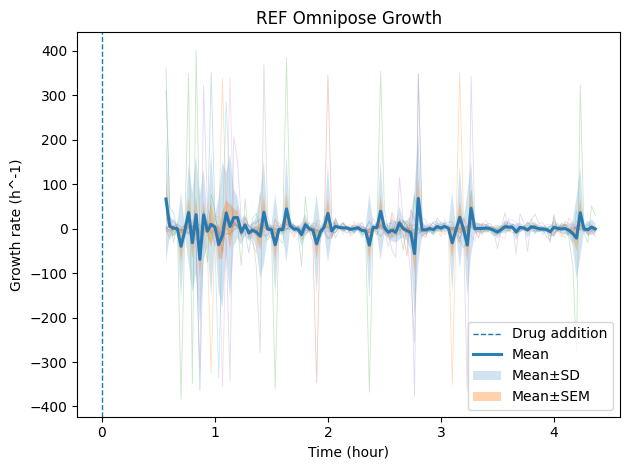

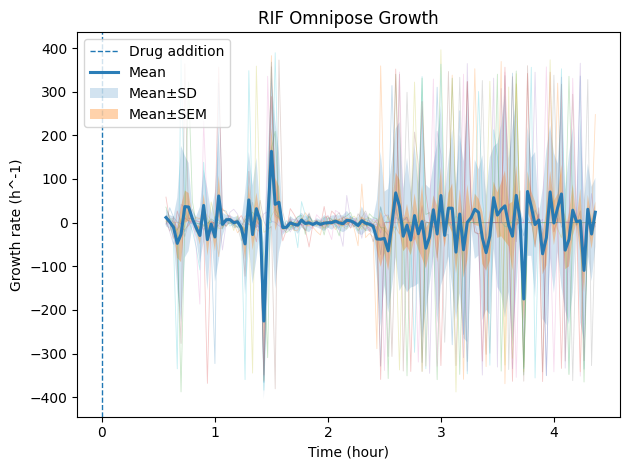

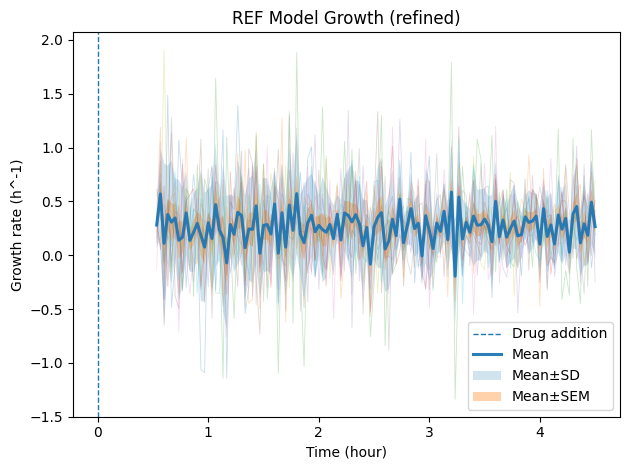

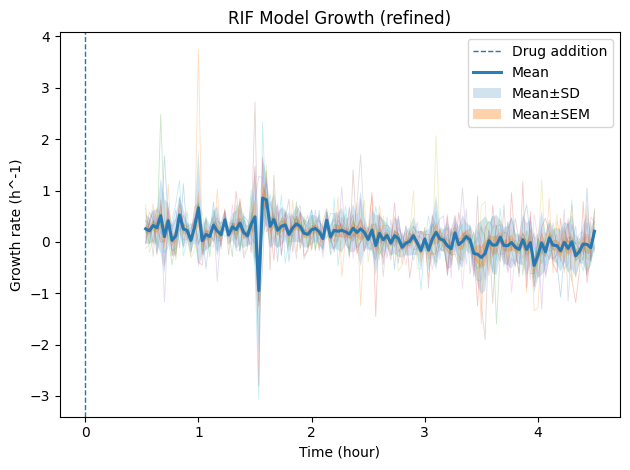

✅ Running smoothing sweep for model (area -> smooth -> growth)


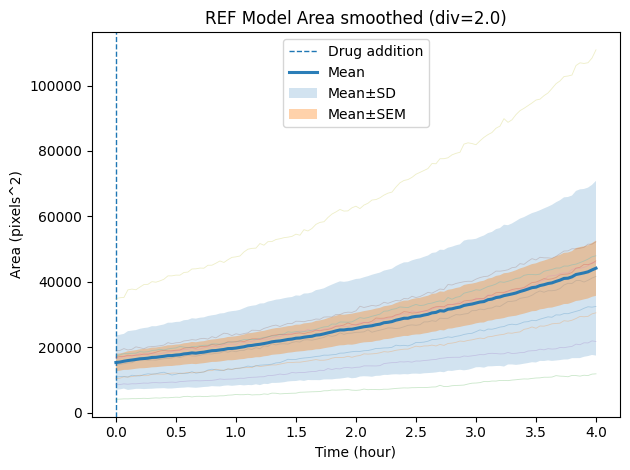

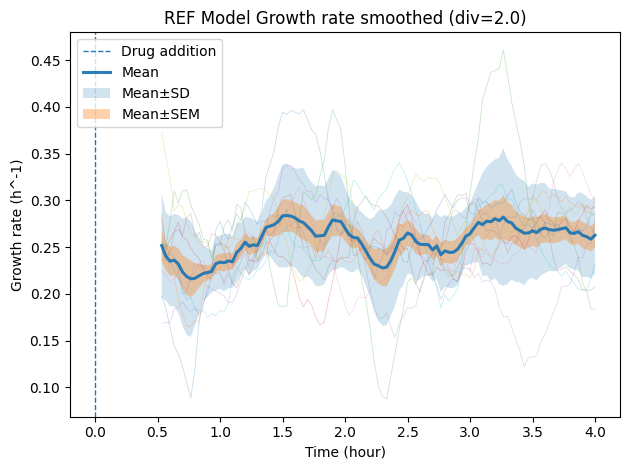

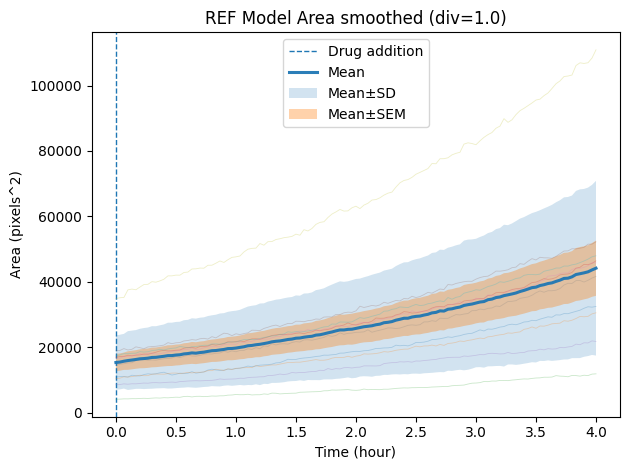

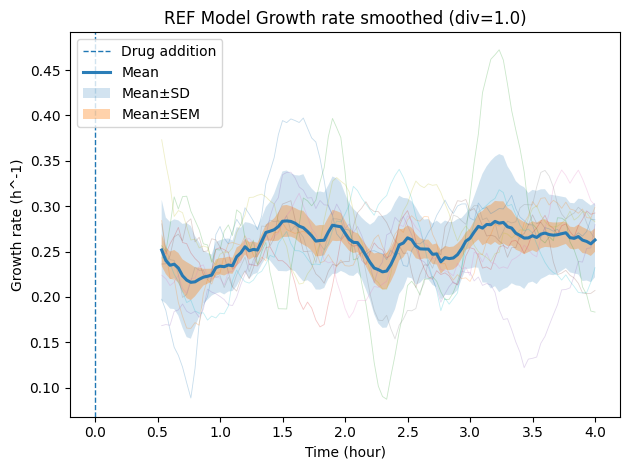

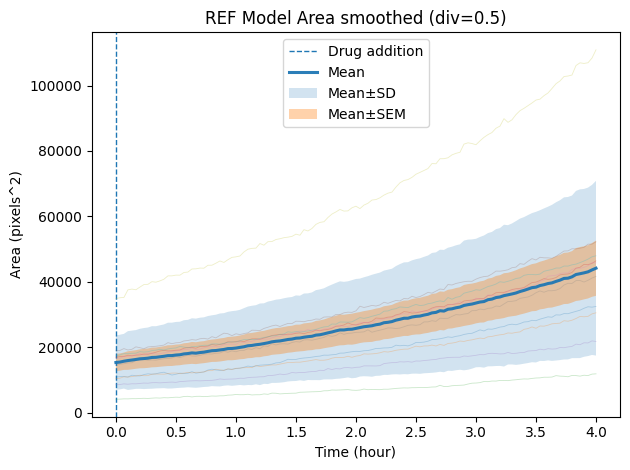

...

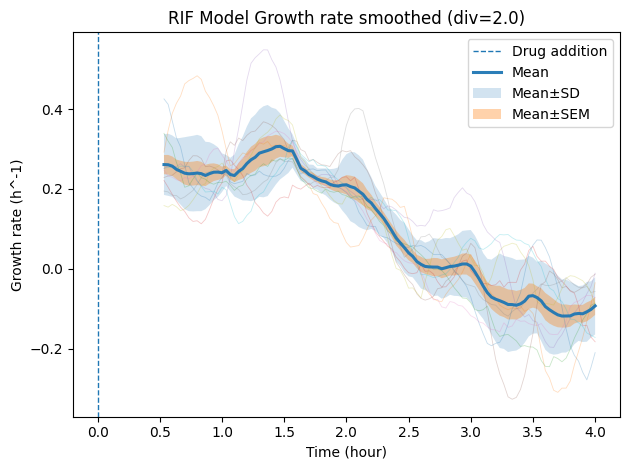

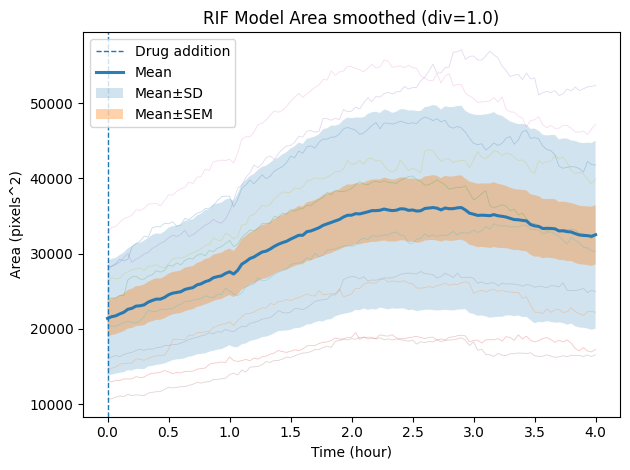

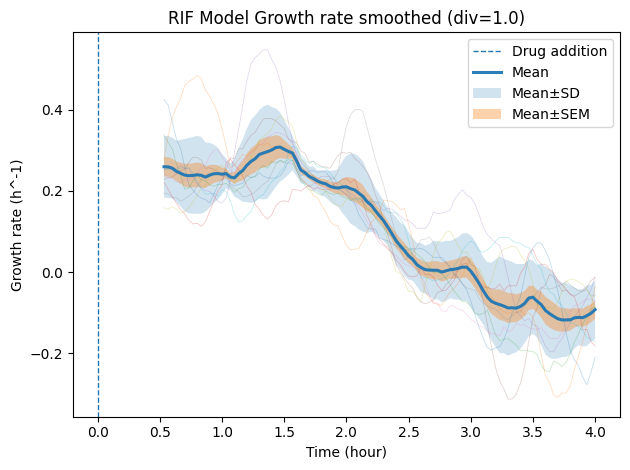

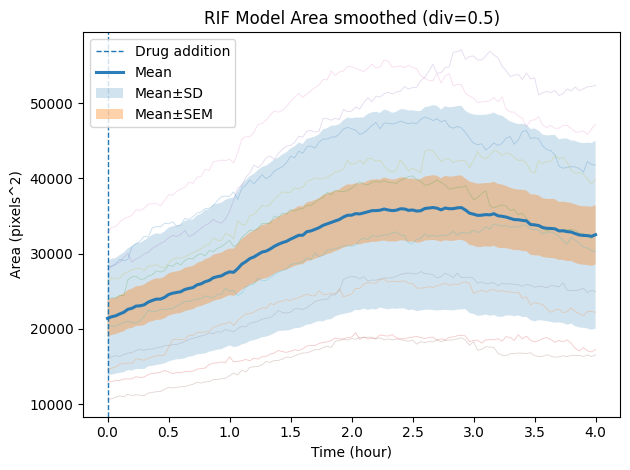

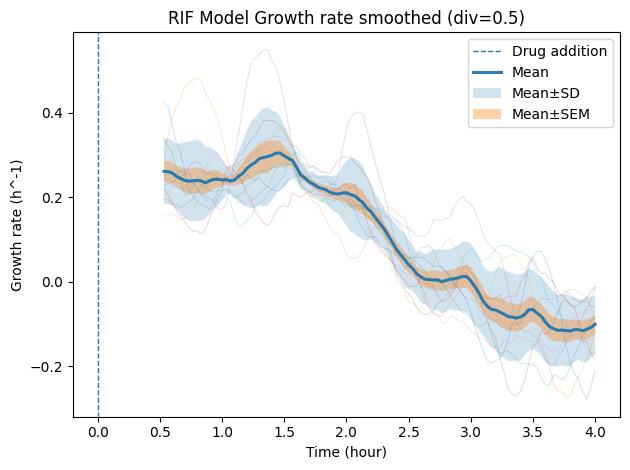


✅ DONE: Training + demos + saved curves + all notebook-style plots.


In [ ]:
print("\n==================== NOTEBOOK-STYLE STACKED PLOTS ====================")
make_all_notebook_style_plots(
    DATA_ROOT=DATA_ROOT,
    RUN_DIR=RUN_DIR,
    REF_WELLS=REF_WELLS,
    RIF_WELLS=RIF_WELLS,
    interval_min=INTERVAL_MIN,
    rolling=ROLLING,
    # model_variant="refined",          # "pred" or "refined"
    drug_addition_hr=0.0,
    do_smoothing_sweep=True
)

print("\n✅ DONE: Training + demos + saved curves + all notebook-style plots.")

✅ Omnipose rates loaded from /content/drive/MyDrive/Colab Notebooks/Research methodology/Data/REF: 10/10 wells | T=116
✅ Omnipose rates loaded from /content/drive/MyDrive/Colab Notebooks/Research methodology/Data/RIF: 10/10 wells | T=116


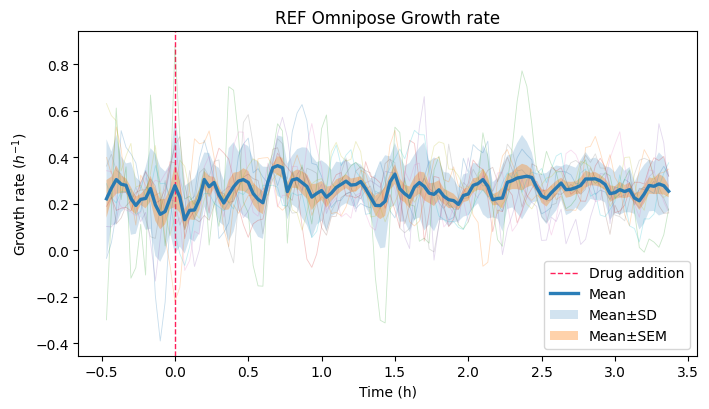

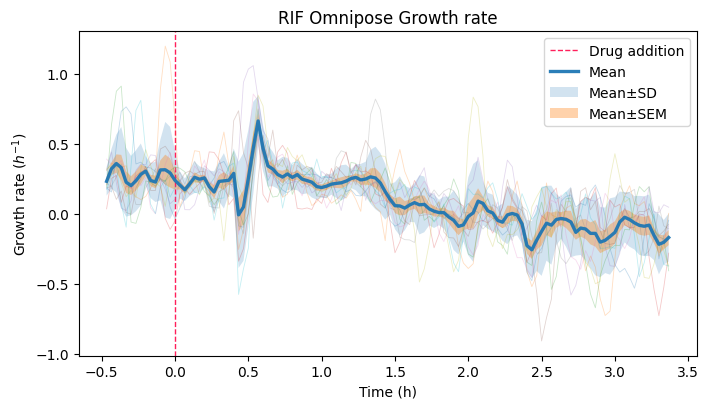

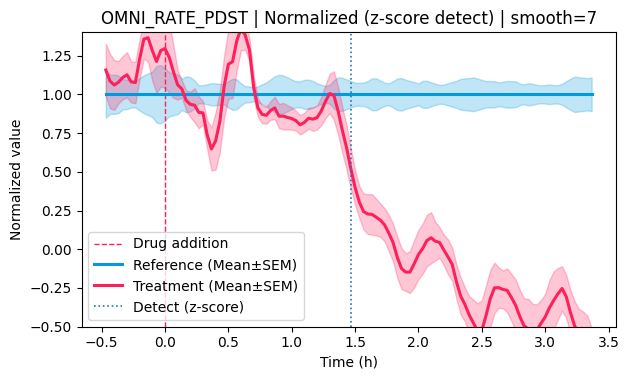

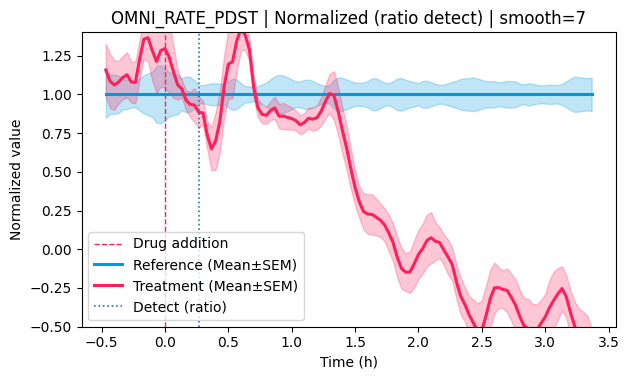

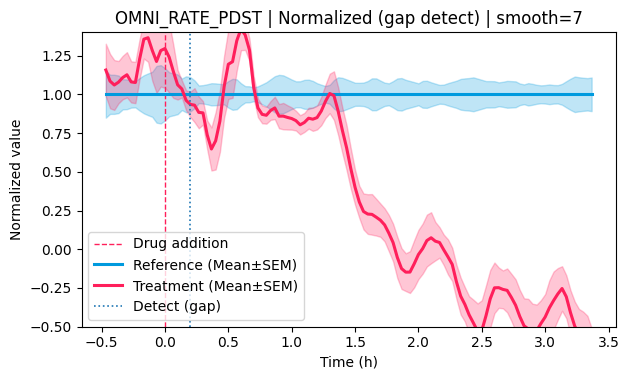


=== OMNI_RATE_PDST early detection (hours, sustained k=3, smooth=7) ===
z-score: 1.4666666666666668
ratio:   0.2666666666666666
gap:     0.19999999999999996
p<0.05:  0.6000000000000001
✅ Loaded model (pred) REF: 10 wells | area (10, 121) | rate (10, 120)
✅ Loaded model (pred) RIF: 10 wells | area (10, 121) | rate (10, 120)


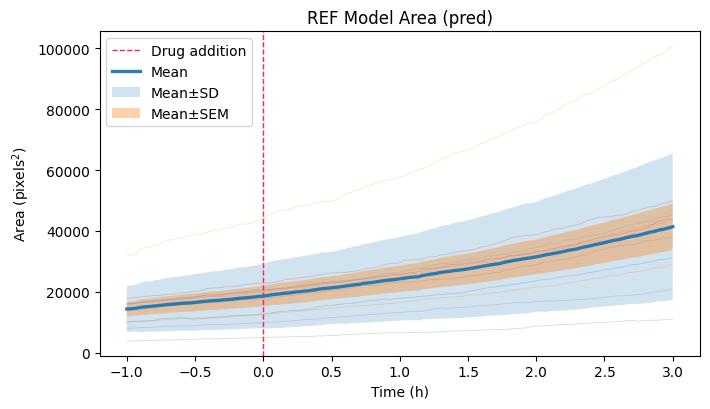

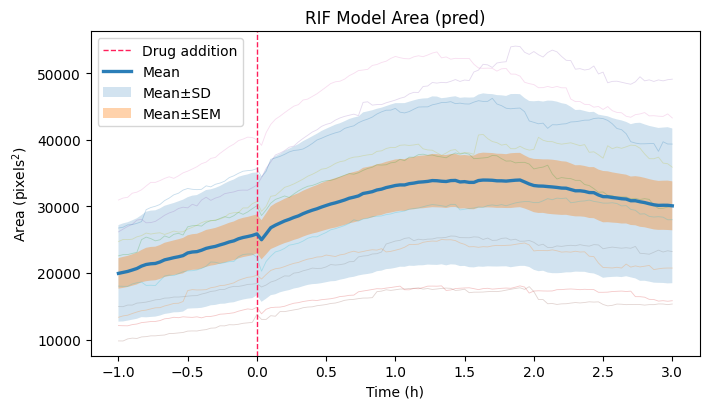

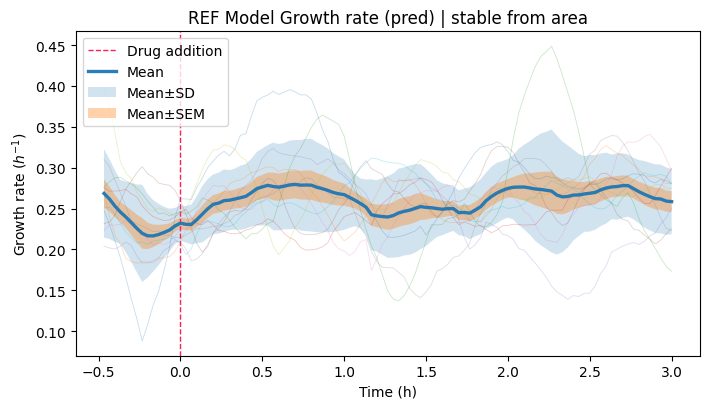

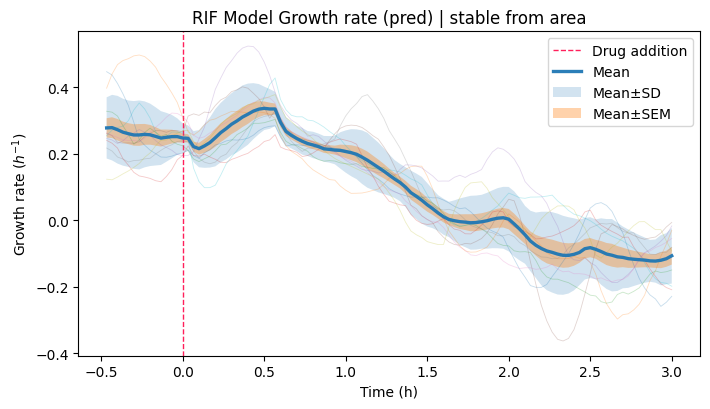

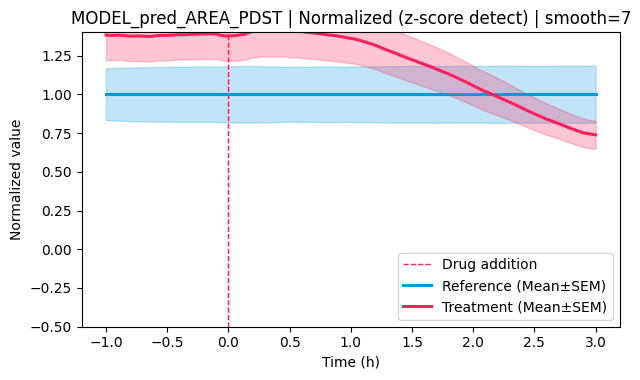

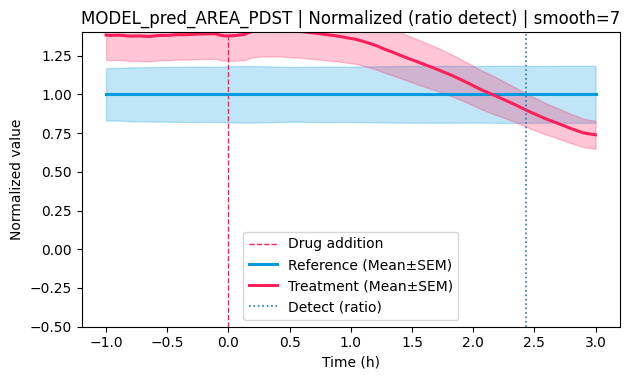

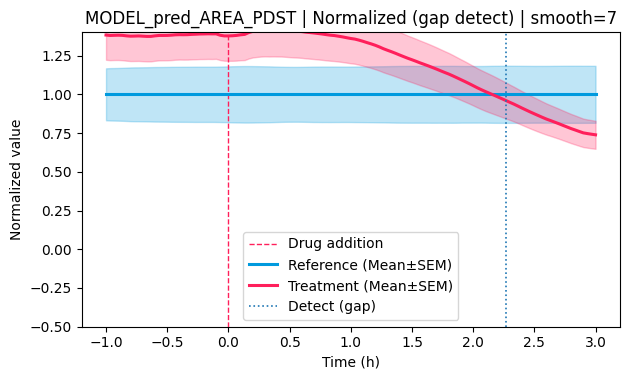


=== MODEL_pred_AREA_PDST early detection (hours, sustained k=3, smooth=7) ===
z-score: None
ratio:   2.433333333333333
gap:     2.2666666666666666
p<0.05:  None


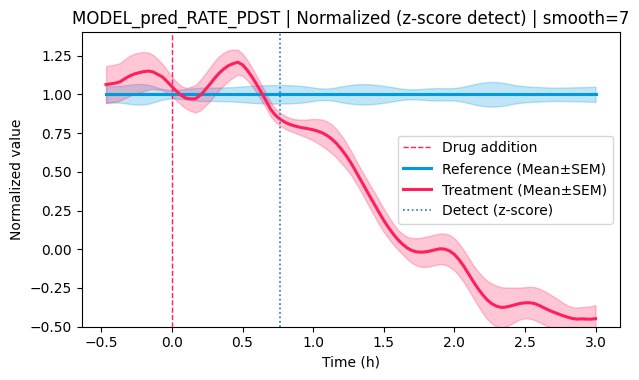

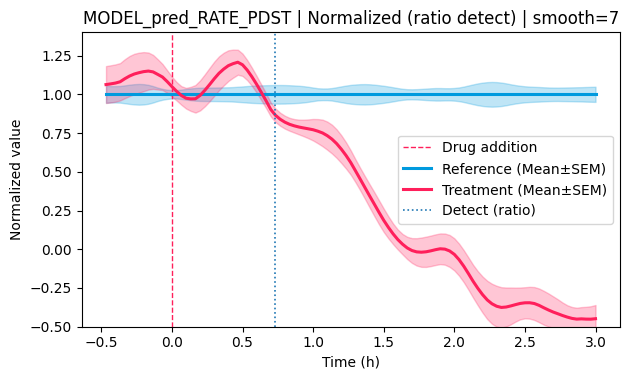

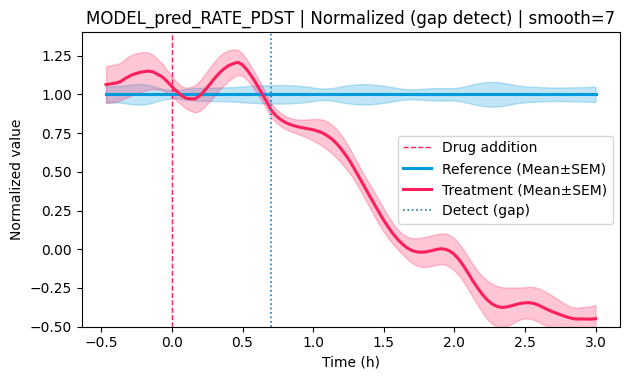


=== MODEL_pred_RATE_PDST early detection (hours, sustained k=3, smooth=7) ===
z-score: 0.7666666666666666
ratio:   0.7333333333333334
gap:     0.7
p<0.05:  0.7666666666666666
✅ Loaded model (refined) REF: 10 wells | area (10, 121) | rate (10, 120)
✅ Loaded model (refined) RIF: 10 wells | area (10, 121) | rate (10, 120)


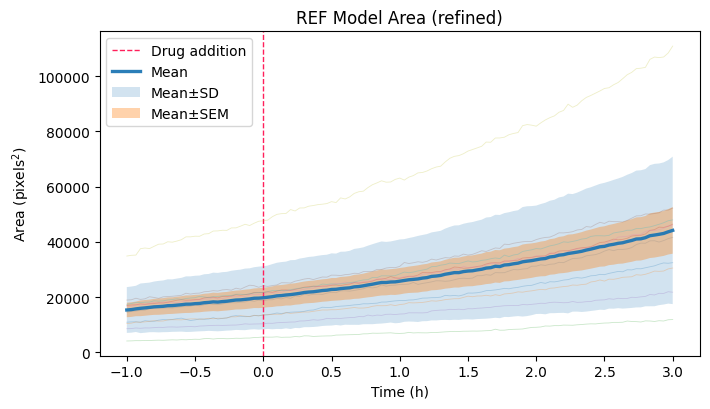

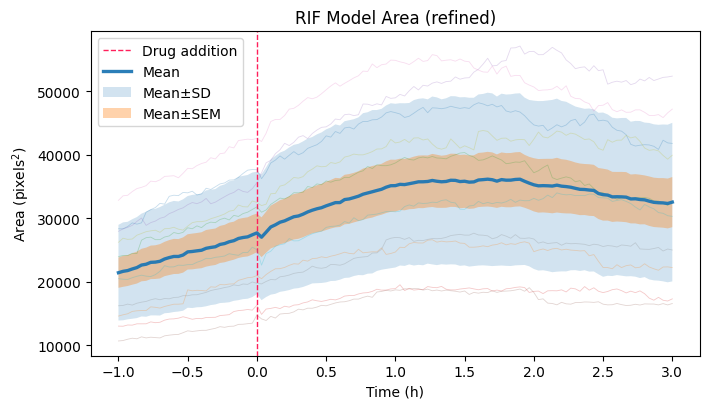

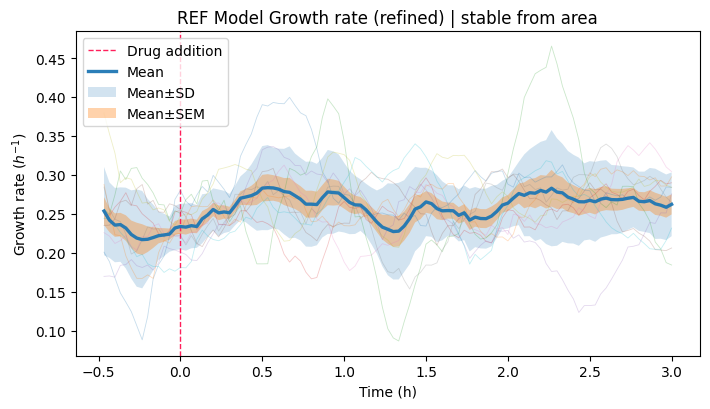

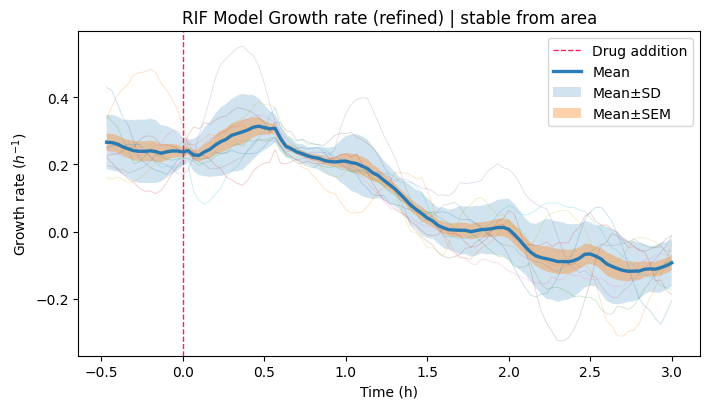

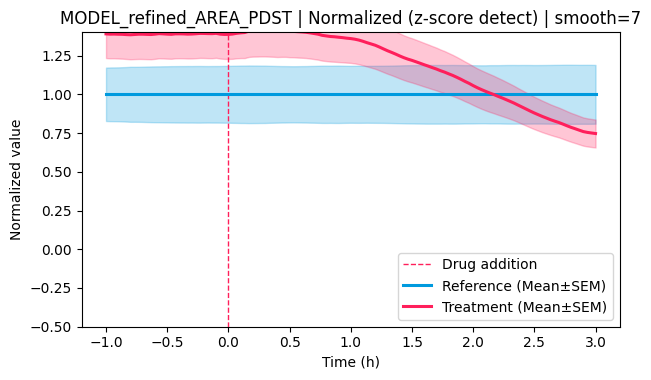

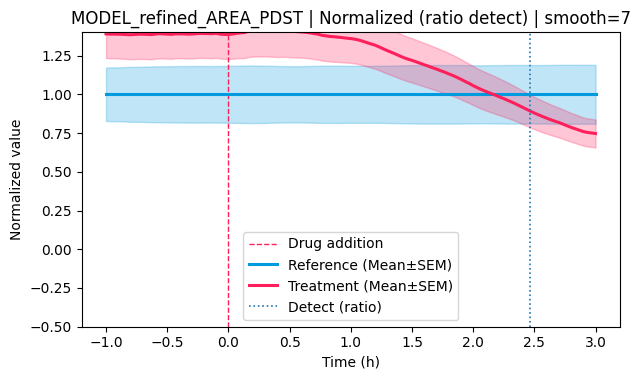

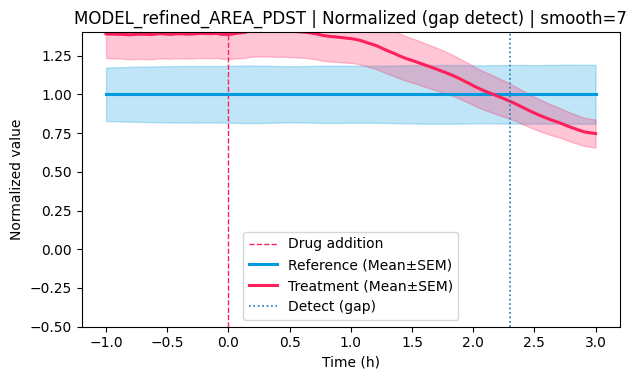


=== MODEL_refined_AREA_PDST early detection (hours, sustained k=3, smooth=7) ===
z-score: None
ratio:   2.466666666666667
gap:     2.3
p<0.05:  None


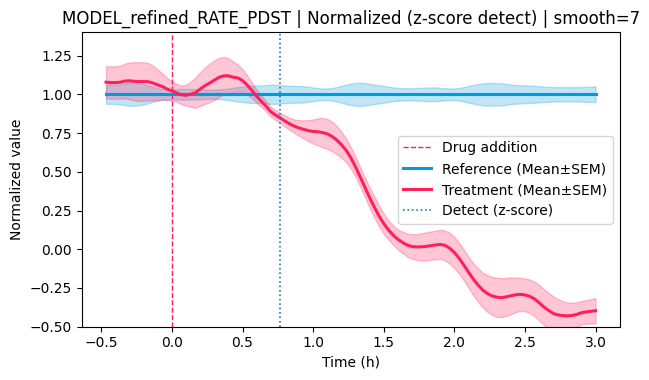

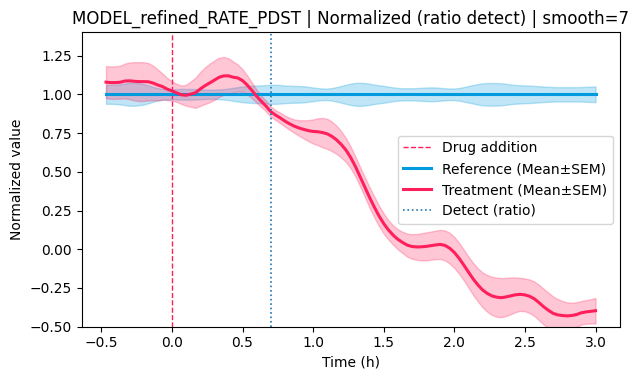

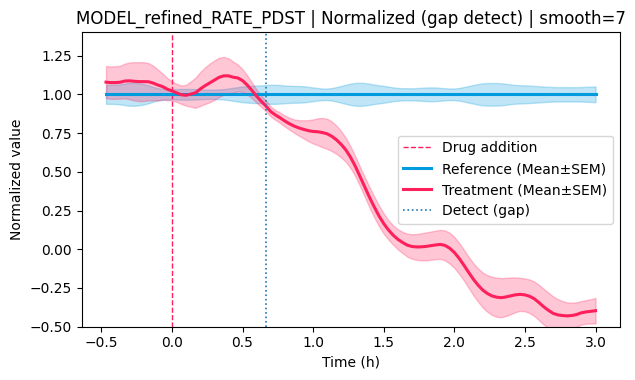


=== MODEL_refined_RATE_PDST early detection (hours, sustained k=3, smooth=7) ===
z-score: 0.7666666666666666
ratio:   0.7
gap:     0.6666666666666667
p<0.05:  0.7666666666666666

✅ DONE. All figures saved to: /content/drive/MyDrive/Colab Notebooks/Research methodology/Results/runs_tracking_refine


In [22]:
# --- If you need drive mount ---
# from google.colab import drive
# drive.mount("/content/drive")

import os, pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats

EPS = 1e-8

# -------------------------
# 0) PATHS (EDIT THESE)
# -------------------------
ref_dir   = "/content/drive/MyDrive/Colab Notebooks/Research methodology/Data/REF"
treat_dir = "/content/drive/MyDrive/Colab Notebooks/Research methodology/Data/RIF"

# Folder that contains REF_Pos111/area_pred.npy etc.
RUN_DIR = "/content/drive/MyDrive/Colab Notebooks/Research methodology/Results/runs_tracking_refine"


OUT_DIR = "/content/drive/MyDrive/Colab Notebooks/Research methodology/Results/runs_tracking_refine"
os.makedirs(OUT_DIR, exist_ok=True)

# -------------------------
# 1) EXPERIMENT PARAMETERS
# -------------------------
INTERVAL_MIN     = 2.0
ROLLING          = 16          # 16 frames * 2 min = 32 min window
DRUG_ADDITION_HR = 0.0
SMOOTH_WINDOW    = 7           # smoothing used only for detection/normalized plots
SUSTAIN_K        = 3           # sustained frames criterion

# If your omnipose areas are in pixels, keep this
# If they are already in µm^2, set PIXEL_AREA = 1.0
PIXEL_AREA = (0.0733 ** 2)


# ============================================================
# 2) GENERAL UTILITIES
# ============================================================

def list_pos_ids(base_dir: str):
    """Return sorted [111,112,...] from folders Pos111, Pos112 ..."""
    ids = []
    for d in os.listdir(base_dir):
        if d.startswith("Pos") and os.path.isdir(os.path.join(base_dir, d)):
            try:
                ids.append(int(d.replace("Pos", "")))
            except:
                pass
    return sorted(ids)

def time_axis_hr(T: int, interval_min: float, start_offset_frames: int, drug_addition_hr: float):
    """Drug addition is exactly at t=0."""
    return (np.arange(T) + start_offset_frames) * (interval_min / 60.0) - drug_addition_hr

def means_std_sem(stacked_2d: np.ndarray):
    mean = np.nanmean(stacked_2d, axis=0)
    std  = np.nanstd(stacked_2d, axis=0, ddof=1)
    sem  = stats.sem(stacked_2d, axis=0, ddof=1, nan_policy="omit")
    return mean, std, sem

def align_pair(a: np.ndarray, b: np.ndarray):
    T = min(a.shape[1], b.shape[1])
    return a[:, :T], b[:, :T]

def first_sustained_true(mask: np.ndarray, k: int = 3) -> int:
    run = 0
    for i, v in enumerate(mask):
        run = run + 1 if v else 0
        if run >= k:
            return i - k + 1
    return -1

# ============================================================
# 3) NAN-SAFE SMOOTHING (used for detection plots only)
# ============================================================

def smooth_1d_nan_moving_average(x: np.ndarray, window: int = 5) -> np.ndarray:
    x = np.asarray(x, dtype=np.float64)
    if window <= 1:
        return x.copy()
    valid = np.isfinite(x).astype(np.float64)
    x0 = np.where(np.isfinite(x), x, 0.0)
    k = np.ones(window, dtype=np.float64)
    num = np.convolve(x0, k, mode="same")
    den = np.convolve(valid, k, mode="same") + EPS
    y = num / den
    y[den <= EPS * 10] = np.nan
    return y

def smooth_stack_nan(stack_2d: np.ndarray, window: int = 5) -> np.ndarray:
    stack_2d = np.asarray(stack_2d, dtype=np.float64)
    out = np.empty_like(stack_2d, dtype=np.float64)
    for i in range(stack_2d.shape[0]):
        out[i] = smooth_1d_nan_moving_average(stack_2d[i], window=window)
    return out

# ============================================================
# 4) OMNIPOSE LOADING: REF/Pos*/meta/growth_areas.pickle
# ============================================================

def load_meta_pickles(meta_dir: str):
    area_p = os.path.join(meta_dir, "growth_areas.pickle")
    rate_p = os.path.join(meta_dir, "growth_rate.pickle")

    area = rate = None
    if os.path.exists(area_p):
        with open(area_p, "rb") as f:
            area = np.array(pickle.load(f), dtype=np.float64).reshape(-1)

    if os.path.exists(rate_p):
        with open(rate_p, "rb") as f:
            rate = np.array(pickle.load(f), dtype=np.float64).reshape(-1)

    return area, rate

def load_omnipose_area_stack(base_dir: str, pixel_area: float = 1.0):
    pos_ids = list_pos_ids(base_dir)
    curves = []
    used = []

    for pid in pos_ids:
        meta_dir = os.path.join(base_dir, f"Pos{pid}", "meta")
        a, _ = load_meta_pickles(meta_dir)
        if a is None:
            print(f"⚠️ Missing growth_areas.pickle for Pos{pid}")
            continue
        a = a * float(pixel_area)
        curves.append(a)
        used.append(pid)

    if len(curves) == 0:
        raise FileNotFoundError(f"No growth_areas.pickle found under: {base_dir}/Pos*/meta")

    T = min(len(c) for c in curves)
    stack = np.stack([c[:T] for c in curves], axis=0)
    print(f"✅ Omnipose areas loaded from {base_dir}: {len(curves)}/{len(pos_ids)} wells | T={T}")
    return stack, used

def load_omnipose_rate_stack(base_dir: str):
    """
    Loads Omnipose growth RATE directly from:
      Pos*/meta/growth_rate.pickle
    Returns: rate_stack [N,T], used_pos_ids
    """
    pos_ids = list_pos_ids(base_dir)
    curves, used = [], []

    for pid in pos_ids:
        meta_dir = os.path.join(base_dir, f"Pos{pid}", "meta")
        _, r = load_meta_pickles(meta_dir)
        if r is None:
            print(f"⚠️ Missing growth_rate.pickle for Pos{pid}")
            continue

        curves.append(np.asarray(r, dtype=np.float64).reshape(-1))
        used.append(pid)

    if len(curves) == 0:
        raise FileNotFoundError(f"No growth_rate.pickle found under: {base_dir}/Pos*/meta")

    T = min(len(c) for c in curves)
    stack = np.stack([c[:T] for c in curves], axis=0)
    print(f"✅ Omnipose rates loaded from {base_dir}: {len(curves)}/{len(pos_ids)} wells | T={T}")
    return stack, used


def load_omnipose_rate_stack(base_dir: str):
    """
    Loads Omnipose growth RATE directly from:
      Pos*/meta/growth_rate.pickle
    Returns: rate_stack [N,T], used_pos_ids
    """
    pos_ids = list_pos_ids(base_dir)
    curves, used = [], []

    for pid in pos_ids:
        meta_dir = os.path.join(base_dir, f"Pos{pid}", "meta")
        _, r = load_meta_pickles(meta_dir)
        if r is None:
            print(f"⚠️ Missing growth_rate.pickle for Pos{pid}")
            continue

        curves.append(np.asarray(r, dtype=np.float64).reshape(-1))
        used.append(pid)

    if len(curves) == 0:
        raise FileNotFoundError(f"No growth_rate.pickle found under: {base_dir}/Pos*/meta")

    T = min(len(c) for c in curves)
    stack = np.stack([c[:T] for c in curves], axis=0)
    print(f"✅ Omnipose rates loaded from {base_dir}: {len(curves)}/{len(pos_ids)} wells | T={T}")
    return stack, used


# ============================================================
# 5) MODEL LOADING: RUN_DIR/REF_Pos111/area_pred.npy etc.
# ============================================================

import os, glob
import numpy as np

def _find_first_existing(patterns):
    for p in patterns:
        hits = glob.glob(p)
        if len(hits) > 0:
            return sorted(hits)[0]
    return None

def load_model_curves(RUN_DIR, condition: str, wells: list[int], which: str = "refined"):
    """
    Auto-discovers model curve files even if naming differs.

    Expected folder (default):
      RUN_DIR/{condition}_Pos{wid}/

    File patterns it will accept:
      area_{which}.npy, rate_{which}.npy
      areas_{which}.npy, rates_{which}.npy
      area-{which}.npy, rate-{which}.npy
      *{which}*area*.npy, *{which}*rate*.npy
    """
    areas, rates, ok_wells = [], [], []

    for wid in wells:
        wdir = os.path.join(RUN_DIR, f"{condition}_Pos{wid}")

        # If folder doesn't exist, try looser search
        if not os.path.isdir(wdir):
            alt = glob.glob(os.path.join(RUN_DIR, f"*{condition}*Pos{wid}*"))
            alt = [a for a in alt if os.path.isdir(a)]
            if len(alt) > 0:
                wdir = sorted(alt)[0]

        if not os.path.isdir(wdir):
            print(f"⚠️ Missing folder for {condition} Pos{wid}: {wdir}")
            continue

        # area patterns
        area_path = _find_first_existing([
            os.path.join(wdir, f"area_{which}.npy"),
            os.path.join(wdir, f"areas_{which}.npy"),
            os.path.join(wdir, f"area-{which}.npy"),
            os.path.join(wdir, f"*{which}*area*.npy"),
            os.path.join(wdir, f"*area*{which}*.npy"),
        ])

        # rate patterns
        rate_path = _find_first_existing([
            os.path.join(wdir, f"rate_{which}.npy"),
            os.path.join(wdir, f"rates_{which}.npy"),
            os.path.join(wdir, f"rate-{which}.npy"),
            os.path.join(wdir, f"*{which}*rate*.npy"),
            os.path.join(wdir, f"*rate*{which}*.npy"),
        ])

        if area_path is None or rate_path is None:
            print(f"⚠️ Missing {which} curves for {condition} Pos{wid} in {wdir}")
            continue

        a = np.load(area_path).astype(np.float64).reshape(-1)
        r = np.load(rate_path).astype(np.float64).reshape(-1)

        areas.append(a); rates.append(r); ok_wells.append(wid)

    if len(areas) == 0:
        raise RuntimeError(
            f"No model curves found for {condition} ({which}).\n"
            f"Check RUN_DIR: {RUN_DIR}\n"
            f"Tip: run the debug cell below to see what files exist."
        )

    minA = min(len(x) for x in areas)
    minR = min(len(x) for x in rates)
    area_stack = np.stack([x[:minA] for x in areas], axis=0)
    rate_stack = np.stack([x[:minR] for x in rates], axis=0)

    print(f"✅ Loaded model ({which}) {condition}: {len(ok_wells)} wells | area {area_stack.shape} | rate {rate_stack.shape}")
    return area_stack, rate_stack, ok_wells


# ============================================================
# 6) STABLE growth-rate from area (rolling exponential fit via log-linear slope)
# ============================================================

def calc_growth_rate_rolling_stable(area_1d: np.ndarray, rolling: int, interval_min: float):
    """
    Exponential model: A(t)=a*exp(b*t) -> log(A)=log(a)+b*t
    Fit slope b (1/hour) using polyfit on log(A).
    Returns length (T-rolling).
    """
    area_1d = np.asarray(area_1d, dtype=np.float64).reshape(-1)
    dt_hr = interval_min / 60.0

    rates = []
    for i in range(rolling, len(area_1d)):
        y = area_1d[i-rolling:i]
        if np.any(~np.isfinite(y)) or np.any(y <= 0):
            rates.append(np.nan)
            continue
        t_hr = np.arange(rolling, dtype=np.float64) * dt_hr
        logy = np.log(y + 1e-8)
        b, _ = np.polyfit(t_hr, logy, 1)
        rates.append(float(b))

    return np.array(rates, dtype=np.float64)

def area_stack_to_rate_stack(area_stack: np.ndarray, rolling: int, interval_min: float):
    rates = [calc_growth_rate_rolling_stable(area_stack[i], rolling, interval_min) for i in range(area_stack.shape[0])]
    T = min(len(r) for r in rates)
    return np.stack([r[:T] for r in rates], axis=0)

# ============================================================
# 7) PLOTTING (one plot per graph)
# ============================================================

def plot_stacked_with_bands(stacked: np.ndarray,
                            interval_min: float,
                            title: str,
                            ylab: str,
                            start_offset_frames: int,
                            drug_addition_hr: float,
                            save_prefix: str):
    stacked = np.asarray(stacked, dtype=np.float64)
    mean, std, sem = means_std_sem(stacked)
    t_hr = time_axis_hr(stacked.shape[1], interval_min, start_offset_frames, drug_addition_hr)

    plt.figure(facecolor="white", figsize=(7.2, 4.2))
    plt.axvline(0.0, linestyle="--", lw=1, color="#FF1F5B", label="Drug addition")
    plt.plot(t_hr, stacked.T, lw=0.6, alpha=0.25)
    plt.plot(t_hr, mean, lw=2.4, alpha=0.95, label="Mean")
    plt.fill_between(t_hr, mean - std, mean + std, alpha=0.20, label="Mean±SD")
    plt.fill_between(t_hr, mean - sem, mean + sem, alpha=0.35, label="Mean±SEM")
    plt.xlabel("Time (h)")
    plt.ylabel(ylab)
    plt.title(title)
    plt.legend()
    plt.tight_layout()

    plt.savefig(os.path.join(OUT_DIR, save_prefix + ".png"), dpi=200)
    plt.savefig(os.path.join(OUT_DIR, save_prefix + ".svg"))
    plt.show()

# ============================================================
# 8) TRAN-STYLE NORMALIZATION + EARLY DETECTION
# ============================================================

def welch_ttest_timecourse(ref_stack: np.ndarray, rif_stack: np.ndarray):
    ref_stack, rif_stack = align_pair(ref_stack, rif_stack)
    T = ref_stack.shape[1]
    pvals = np.full((T,), np.nan, dtype=np.float64)
    for t in range(T):
        a = ref_stack[:, t]; b = rif_stack[:, t]
        a = a[np.isfinite(a)]; b = b[np.isfinite(b)]
        if len(a) >= 2 and len(b) >= 2:
            pvals[t] = stats.ttest_ind(a, b, equal_var=False).pvalue
    return pvals

def detect_times(ref_stack: np.ndarray, rif_stack: np.ndarray,
                 interval_min: float, start_offset_frames: int,
                 drug_addition_hr: float,
                 z_thr=2.0, ratio_thr=0.90, gap_thr=0.05,
                 sustain_k=3, smooth_window=1, min_after_hr: float = 0.0,
):
    ref_stack, rif_stack = align_pair(ref_stack, rif_stack)

    if smooth_window > 1:
        ref_stack = smooth_stack_nan(ref_stack, smooth_window)
        rif_stack = smooth_stack_nan(rif_stack, smooth_window)

    ref_mean, ref_sem = np.nanmean(ref_stack, axis=0), stats.sem(ref_stack, axis=0, ddof=1, nan_policy="omit")
    rif_mean, rif_sem = np.nanmean(rif_stack, axis=0), stats.sem(rif_stack, axis=0, ddof=1, nan_policy="omit")

    T = ref_mean.shape[0]
    t_hr = time_axis_hr(T, interval_min, start_offset_frames, drug_addition_hr)
    after = t_hr >= min_after_hr

    # A) z-score on mean difference using SEM
    diff = rif_mean - ref_mean
    se_diff = np.sqrt(ref_sem**2 + rif_sem**2) + EPS
    z = diff / se_diff
    idx_z = first_sustained_true((z <= -abs(z_thr)) & after, k=sustain_k)

    # B) ratio (RIF/REF)
    ratio = rif_mean / (ref_mean + EPS)
    idx_ratio = first_sustained_true((ratio <= ratio_thr) & after, k=sustain_k)

    # C) gap (REF-RIF)/median(REF)
    scale = np.nanmedian(ref_mean) + EPS
    gap = (ref_mean - rif_mean) / scale
    idx_gap = first_sustained_true((gap >= gap_thr) & after, k=sustain_k)

    # p-values
    pvals = welch_ttest_timecourse(ref_stack, rif_stack)
    idx_p = first_sustained_true((pvals < 0.05) & after, k=sustain_k)

    def idx_to_hr(idx): return None if idx < 0 else float(t_hr[idx])

    return dict(
        t_hr=t_hr, z=z, ratio=ratio, gap=gap, pvals=pvals,
        t_z=idx_to_hr(idx_z), t_ratio=idx_to_hr(idx_ratio), t_gap=idx_to_hr(idx_gap), t_p=idx_to_hr(idx_p),
        idx_z=idx_z, idx_ratio=idx_ratio, idx_gap=idx_gap, idx_p=idx_p
    )

def plot_tran_normalized(ref_stack: np.ndarray, rif_stack: np.ndarray,
                         interval_min: float, start_offset_frames: int, drug_addition_hr: float,
                         title: str, save_prefix: str,
                         smooth_window: int = 1,
                         mark_time: float | None = None, mark_label: str = "",
                         ylim=(-0.5, 1.4)):
    ref_stack, rif_stack = align_pair(ref_stack, rif_stack)

    if smooth_window > 1:
        ref_stack = smooth_stack_nan(ref_stack, smooth_window)
        rif_stack = smooth_stack_nan(rif_stack, smooth_window)

    ref_mean, ref_sem = np.nanmean(ref_stack, axis=0), stats.sem(ref_stack, axis=0, ddof=1, nan_policy="omit")
    rif_mean, rif_sem = np.nanmean(rif_stack, axis=0), stats.sem(rif_stack, axis=0, ddof=1, nan_policy="omit")

    denom = ref_mean + EPS
    ref_nm = np.ones_like(ref_mean)   # REF baseline at 1
    ref_ns = ref_sem / denom
    rif_nm = rif_mean / denom
    rif_ns = rif_sem / denom

    t_hr = time_axis_hr(ref_nm.shape[0], interval_min, start_offset_frames, drug_addition_hr)

    plt.figure(facecolor="white", figsize=(6.4, 3.9))
    plt.axvline(0.0, linestyle="--", lw=1, color="#FF1F5B", label="Drug addition")

    # Reference: flat baseline + band
    plt.plot(t_hr, ref_nm, lw=2.2, label="Reference (Mean±SEM)", color="#009ADE")
    plt.fill_between(t_hr, ref_nm - ref_ns, ref_nm + ref_ns, alpha=0.25, color="#009ADE")

    # Treatment: curve + band
    plt.plot(t_hr, rif_nm, lw=2.2, label="Treatment (Mean±SEM)", color="#FF1F5B")
    plt.fill_between(t_hr, rif_nm - rif_ns, rif_nm + rif_ns, alpha=0.25, color="#FF1F5B")

    if mark_time is not None:
        plt.axvline(mark_time, linestyle=":", lw=1.2, label=mark_label)

    plt.xlabel("Time (h)")
    plt.ylabel("Normalized value")
    plt.title(title)
    plt.ylim(*ylim)
    plt.legend()
    plt.tight_layout()

    plt.savefig(os.path.join(OUT_DIR, save_prefix + ".png"), dpi=200)
    plt.savefig(os.path.join(OUT_DIR, save_prefix + ".svg"))
    plt.show()

def make_early_detection_report(ref_stack: np.ndarray, rif_stack: np.ndarray,
                                interval_min: float, start_offset_frames: int, drug_addition_hr: float,
                                name: str, smooth_window: int,min_after_hr: float = 0.0):
    det = detect_times(ref_stack, rif_stack,
                       interval_min=interval_min,
                       start_offset_frames=start_offset_frames,
                       drug_addition_hr=drug_addition_hr,
                       sustain_k=SUSTAIN_K,
                       smooth_window=smooth_window,
                       min_after_hr=min_after_hr,
)

    # 3 separate plots (z/ratio/gap)
    plot_tran_normalized(ref_stack, rif_stack, interval_min, start_offset_frames, drug_addition_hr,
                         title=f"{name} | Normalized (z-score detect) | smooth={smooth_window}",
                         save_prefix=f"{name}_normalized_z",
                         smooth_window=smooth_window,
                         mark_time=det["t_z"], mark_label="Detect (z-score)")

    plot_tran_normalized(ref_stack, rif_stack, interval_min, start_offset_frames, drug_addition_hr,
                         title=f"{name} | Normalized (ratio detect) | smooth={smooth_window}",
                         save_prefix=f"{name}_normalized_ratio",
                         smooth_window=smooth_window,
                         mark_time=det["t_ratio"], mark_label="Detect (ratio)")

    plot_tran_normalized(ref_stack, rif_stack, interval_min, start_offset_frames, drug_addition_hr,
                         title=f"{name} | Normalized (gap detect) | smooth={smooth_window}",
                         save_prefix=f"{name}_normalized_gap",
                         smooth_window=smooth_window,
                         mark_time=det["t_gap"], mark_label="Detect (gap)")

    print(f"\n=== {name} early detection (hours, sustained k={SUSTAIN_K}, smooth={smooth_window}) ===")
    print("z-score:", det["t_z"])
    print("ratio:  ", det["t_ratio"])
    print("gap:    ", det["t_gap"])
    print("p<0.05: ", det["t_p"])
    return det

# ============================================================
# 9) RUN REPORTS (OMNIPOSE + MODEL pred + MODEL refined)
# ============================================================

# ----- Choose wells from folder structure -----
REF_WELLS = list_pos_ids(ref_dir)
RIF_WELLS = list_pos_ids(treat_dir)

# -------------------------
# A) OMNIPOSE
# -------------------------


ref_rate_omni, _ = load_omnipose_rate_stack(ref_dir)
rif_rate_omni, _ = load_omnipose_rate_stack(treat_dir)

plot_stacked_with_bands(ref_rate_omni, INTERVAL_MIN,
                        title="REF Omnipose Growth rate",
                        ylab=r"Growth rate ($h^{-1}$)",
                        start_offset_frames=ROLLING,
                        drug_addition_hr=DRUG_ADDITION_HR,
                        save_prefix="REF_OMNI_rate_stable")

plot_stacked_with_bands(rif_rate_omni, INTERVAL_MIN,
                        title="RIF Omnipose Growth rate",
                        ylab=r"Growth rate ($h^{-1}$)",
                        start_offset_frames=ROLLING,
                        drug_addition_hr=DRUG_ADDITION_HR,
                        save_prefix="RIF_OMNI_rate_stable")

det_omni_rate = make_early_detection_report(ref_rate_omni, rif_rate_omni,
                                            interval_min=INTERVAL_MIN,
                                            start_offset_frames=ROLLING,
                                            drug_addition_hr=DRUG_ADDITION_HR,
                                            name="OMNI_RATE_PDST",
                                            smooth_window=SMOOTH_WINDOW)

# -------------------------
# B) MODEL (pred + refined)
# -------------------------

def run_model_variant(which: str):
    # Load model stacks (area + its own saved rate)
    ref_area_m, ref_rate_m, _ = load_model_curves(RUN_DIR, "REF", REF_WELLS, which=which)
    rif_area_m, rif_rate_m, _ = load_model_curves(RUN_DIR, "RIF", RIF_WELLS, which=which)

    # Area plots
    plot_stacked_with_bands(ref_area_m, INTERVAL_MIN,
                            title=f"REF Model Area ({which})",
                            ylab=r"Area (pixels$^2$)",
                            start_offset_frames=0,
                            drug_addition_hr=DRUG_ADDITION_HR,
                            save_prefix=f"REF_MODEL_area_{which}")

    plot_stacked_with_bands(rif_area_m, INTERVAL_MIN,
                            title=f"RIF Model Area ({which})",
                            ylab=r"Area (pixels$^2$)",
                            start_offset_frames=0,
                            drug_addition_hr=DRUG_ADDITION_HR,
                            save_prefix=f"RIF_MODEL_area_{which}")

    # Stable rates from model areas (recommended for clean curves)
    ref_rate_stable = area_stack_to_rate_stack(ref_area_m, ROLLING, INTERVAL_MIN)
    rif_rate_stable = area_stack_to_rate_stack(rif_area_m, ROLLING, INTERVAL_MIN)

    # Growth rate plots (stable)
    plot_stacked_with_bands(ref_rate_stable, INTERVAL_MIN,
                            title=f"REF Model Growth rate ({which}) | stable from area",
                            ylab=r"Growth rate ($h^{-1}$)",
                            start_offset_frames=ROLLING,
                            drug_addition_hr=DRUG_ADDITION_HR,
                            save_prefix=f"REF_MODEL_rate_stable_{which}")

    plot_stacked_with_bands(rif_rate_stable, INTERVAL_MIN,
                            title=f"RIF Model Growth rate ({which}) | stable from area",
                            ylab=r"Growth rate ($h^{-1}$)",
                            start_offset_frames=ROLLING,
                            drug_addition_hr=DRUG_ADDITION_HR,
                            save_prefix=f"RIF_MODEL_rate_stable_{which}")

    # Early detection (AREA)
    det_area = make_early_detection_report(ref_area_m, rif_area_m,
                                           interval_min=INTERVAL_MIN,
                                           start_offset_frames=0,
                                           drug_addition_hr=DRUG_ADDITION_HR,
                                           name=f"MODEL_{which}_AREA_PDST",
                                           smooth_window=SMOOTH_WINDOW)

    # Early detection (RATE, stable from area)
    min_after_rate = (ROLLING * INTERVAL_MIN) / 60.0  # 0.5333 h for 16 frames at 2 min

    det_rate = make_early_detection_report(
        ref_rate_stable, rif_rate_stable,
        interval_min=INTERVAL_MIN,
        start_offset_frames=ROLLING,
        drug_addition_hr=DRUG_ADDITION_HR,
        name=f"MODEL_{which}_RATE_PDST",
        smooth_window=SMOOTH_WINDOW,
        min_after_hr=min_after_rate     # ✅ delay detection until window is post-drug
    )


    return det_area, det_rate

det_pred_area, det_pred_rate   = run_model_variant("pred")
det_refi_area, det_refi_rate   = run_model_variant("refined")

print("\n✅ DONE. All figures saved to:", OUT_DIR)
